In [2]:
import numpy as np
from datetime import datetime
import pandas as pd
import numpy.matlib
from obspy import read_events
from glob import glob
import time
import pandas as pd
from obspy import UTCDateTime
import os

In [3]:
starttime = UTCDateTime('2020-03-19T00:00:00.0')
endtime = UTCDateTime('2020-06-02T00:00:00.0')
print("start time: %s" % starttime.strftime("%Y/%m/%d %H:%M:%S"))
print("end time: %s" % endtime.strftime("%Y/%m/%d %H:%M:%S"))

detect_dir = "detections"
#xml_list = glob(os.path.join(detect_dir, "scamp_detections_%s_%s_*_wpicks.xml" % (starttime.strftime("%Y%m%d"),
#                                                                                 endtime.strftime("%Y%m%d"))))
xml_list = glob(os.path.join(detect_dir, "scamp_detections_*win10s_wpicks.xml"))
xml_list.sort()
print("number of files: %d" % len(xml_list))
t_create = datetime.utcnow()  # Record the time we made the picks

df = pd.DataFrame()
for file in xml_list:
    print(file)
    cat = read_events(file, format="QUAKEML")
    station = os.path.split(file)[1].split("_")[4]
    print(station)
    print("Looking at file %s" % file)
    print("Number of events: %d" % len(cat.events))
    for event in cat.events:
        #print(event)
        if len(event.picks) > 0:
            # Add each pick to the database
            for pick in event.picks:
                snr = float(pick.comments[0].text.split("= ")[1])
                uncert = pick.time_errors.uncertainty
                wf_id = "%s.%s..%s" %(pick.waveform_id.network_code,
                                       pick.waveform_id.station_code,
                                       pick.waveform_id.channel_code)
                data = pd.DataFrame({'time': [pick.time], 
                                     'station': [station],
                                     'uncertainty': [uncert],
                                     'snr': [snr],
                                     'wf_id': [pick.waveform_id]
                             }, index=[0])
                df = df.append(data, ignore_index=True)
                
df = df.sort_values(by="time")
df.head()

start time: 2020/03/19 00:00:00
end time: 2020/06/02 00:00:00
number of files: 109
detections/scamp_detections_20200319_20200325_C0202_win10s_wpicks.xml
C0202
Looking at file detections/scamp_detections_20200319_20200325_C0202_win10s_wpicks.xml
Number of events: 1938
detections/scamp_detections_20200319_20200325_C0209_win10s_wpicks.xml
C0209
Looking at file detections/scamp_detections_20200319_20200325_C0209_win10s_wpicks.xml
Number of events: 1626
detections/scamp_detections_20200319_20200325_C0404_win10s_wpicks.xml
C0404
Looking at file detections/scamp_detections_20200319_20200325_C0404_win10s_wpicks.xml
Number of events: 1387
detections/scamp_detections_20200319_20200325_C0407_win10s_wpicks.xml
C0407
Looking at file detections/scamp_detections_20200319_20200325_C0407_win10s_wpicks.xml
Number of events: 1689
detections/scamp_detections_20200319_20200325_C0707_win10s_wpicks.xml
C0707
Looking at file detections/scamp_detections_20200319_20200325_C0707_win10s_wpicks.xml
Number of event

F0708
Looking at file detections/scamp_detections_20200416_20200422_F0708_win10s_wpicks.xml
Number of events: 37
detections/scamp_detections_20200416_20200422_F0802_win10s_wpicks.xml
F0802
Looking at file detections/scamp_detections_20200416_20200422_F0802_win10s_wpicks.xml
Number of events: 36
detections/scamp_detections_20200416_20200422_F0809_win10s_wpicks.xml
F0809
Looking at file detections/scamp_detections_20200416_20200422_F0809_win10s_wpicks.xml
Number of events: 27
detections/scamp_detections_20200416_20200422_F0910_win10s_wpicks.xml
F0910
Looking at file detections/scamp_detections_20200416_20200422_F0910_win10s_wpicks.xml
Number of events: 29
detections/scamp_detections_20200423_20200429_C0202_win10s_wpicks.xml
C0202
Looking at file detections/scamp_detections_20200423_20200429_C0202_win10s_wpicks.xml
Number of events: 362
detections/scamp_detections_20200423_20200429_C0209_win10s_wpicks.xml
C0209
Looking at file detections/scamp_detections_20200423_20200429_C0209_win10s_wpi

F0203
Looking at file detections/scamp_detections_20200514_20200520_F0203_win10s_wpicks.xml
Number of events: 106
detections/scamp_detections_20200514_20200520_F0304_win10s_wpicks.xml
F0304
Looking at file detections/scamp_detections_20200514_20200520_F0304_win10s_wpicks.xml
Number of events: 23
detections/scamp_detections_20200514_20200520_F0307_win10s_wpicks.xml
F0307
Looking at file detections/scamp_detections_20200514_20200520_F0307_win10s_wpicks.xml
Number of events: 68
detections/scamp_detections_20200514_20200520_F0607_win10s_wpicks.xml
F0607
Looking at file detections/scamp_detections_20200514_20200520_F0607_win10s_wpicks.xml
Number of events: 42
detections/scamp_detections_20200514_20200520_F0708_win10s_wpicks.xml
F0708
Looking at file detections/scamp_detections_20200514_20200520_F0708_win10s_wpicks.xml
Number of events: 61
detections/scamp_detections_20200521_20200527_C0202_win10s_wpicks.xml
C0202
Looking at file detections/scamp_detections_20200521_20200527_C0202_win10s_wpi

,time,station,uncertainty,snr,wf_id
25019,2020-03-19T17:58:10.728006Z,F0708,0.008,9.7,"[network_code, station_code, channel_code, loc..."
28278,2020-03-19T18:09:54.672011Z,F0910,0.000,0.0,"[network_code, station_code, channel_code, loc..."
9554,2020-03-19T18:24:24.320010Z,F0102,0.008,9.8,"[network_code, station_code, channel_code, loc..."
12578,2020-03-19T18:25:56.312019Z,F0203,0.008,6.1,"[network_code, station_code, channel_code, loc..."
16472,2020-03-19T18:27:06.448028Z,F0304,0.008,0.0,"[network_code, station_code, channel_code, loc..."


In [4]:
# df2
# stalst = df2.station.values
# for sta in stalst:
#     tmp = df2[df2["station"] == sta]
#     row = tmp[tmp["time"] == tmp["time"].min()]
#     print(tmp["time"].max() - tmp["time"].min())
print(df.shape)
df.head(100)

(38933, 5)


,time,station,uncertainty,snr,wf_id
25019,2020-03-19T17:58:10.728006Z,F0708,0.008,9.7,"[network_code, station_code, channel_code, loc..."
28278,2020-03-19T18:09:54.672011Z,F0910,0.000,0.0,"[network_code, station_code, channel_code, loc..."
9554,2020-03-19T18:24:24.320010Z,F0102,0.008,9.8,"[network_code, station_code, channel_code, loc..."
12578,2020-03-19T18:25:56.312019Z,F0203,0.008,6.1,"[network_code, station_code, channel_code, loc..."
16472,2020-03-19T18:27:06.448028Z,F0304,0.008,0.0,"[network_code, station_code, channel_code, loc..."
...,...,...,...,...,...
12602,2020-03-19T19:00:25.168147Z,F0203,0.024,10.3,"[network_code, station_code, channel_code, loc..."
12603,2020-03-19T19:00:42.640148Z,F0203,0.024,99.2,"[network_code, station_code, channel_code, loc..."
7590,2020-03-19T19:01:21.680109Z,F0010,0.008,7.0,"[network_code, station_code, channel_code, loc..."
7591,2020-03-19T19:01:54.296110Z,F0010,0.000,0.0,"[network_code, station_code, channel_code, loc..."


In [5]:
from obspy.core.event import Catalog, Event, Pick, CreationInfo, \
                             WaveformStreamID
from obspy.core.event.base import QuantityError, Comment
from obspy.core.event.origin import Origin
import time

proc_start = time.time()

creation_string = CreationInfo(creation_time = UTCDateTime.now())
catalog = Catalog()
catalog.creation_info = creation_string

latitude_injwell = 50.45041
longitude_injwell = -112.12067
latlon_error = QuantityError(uncertainty=0.009) # equals 1 km

event_win = 2.0
t_prev = starttime
for row in df.itertuples():
    t = row.time
    if (t - t_prev) < event_win:
        continue
    else:
        df2 = df[(np.abs(df["time"] - t) < event_win) & (np.abs(df["time"] - t) > 0.0)]
        if df2.shape[0] > 0:
            stalst = df2.station.values
            if len(set(stalst)) > 2:
                #print("\n{0}".format(t))
                #print("More than 2 distinct stations with picks within %f seconds of each other" % event_win)
                
                event = Event()
                event.creation_info = creation_string
                for sta in stalst:
                    tmp = df2[df2["station"] == sta]
                    row = tmp[tmp["time"] == tmp["time"].min()] # Get earliest pick
                    pick_time = row["time"].values[0]
                    wf_id = row["wf_id"].values[0]
                    uncert = max([0.2, tmp["time"].max() - tmp["time"].min()]) #row["uncertainty"].values[0]
                    snr = row["snr"].values[0]
                    pick = Pick(time=pick_time, waveform_id=wf_id, 
                                time_errors=QuantityError(uncertainty=uncert),
                                comments=[Comment(text="SNR = %f" % snr)])
                    event.picks.append(pick)
    
#                 for row in df2.itertuples():
#                     pick = Pick(time=row.time, 
#                                 waveform_id=row.wf_id, 
#                                 time_errors=QuantityError(uncertainty=row.uncertainty),
#                                 comments=[Comment(text="SNR = %f" % row.snr)])
#                     event.picks.append(pick)
                    
                # Add dummy origin: 0.5 seconds before earliest arrival
                dummy_tO = min([p.time for p in event.picks]) - 0.5
                origin = Origin(time=dummy_tO, time_errors=QuantityError(uncertainty=2.0),
                                longitude=longitude_injwell, latitude_errors=latlon_error,
                                latitude=latitude_injwell, longitude_errors=latlon_error,
                                depth=400, depth_errors=QuantityError(uncertainty=400),
                                method_id="dummy")
                event.origins.append(origin)
                event.preferred_origin_id = str(event.origins[0].resource_id)
                catalog.append(event)
                
        t_prev = t
cat_filename = "scamp_detections_%s_%s_aggregated.xml" % (starttime.strftime("%Y%m%d"),endtime.strftime("%Y%m%d"))
catalog.write(cat_filename, format="QUAKEML")
proc_end = time.time()
print("time elapsed = %f s." % (proc_end - proc_start))
   

time elapsed = 3440.904055 s.


In [16]:
len(catalog)
## convert to nonlinloc input
# for event in catalog.events:
#     print(event)
#     cattmp = Catalog()
#     cattmp.events.append(event)
#     cat_filename = "scamp_detection_%s_aggregated.obs" % (event.origins[0].time.strftime("%Y%m%d%H%M%S"))
#     cattmp.write(os.path.join("nonlinloc",cat_filename), format="NLLOC_OBS")

198

[UTCDateTime(2020, 3, 9, 9, 8, 20, 458007)]


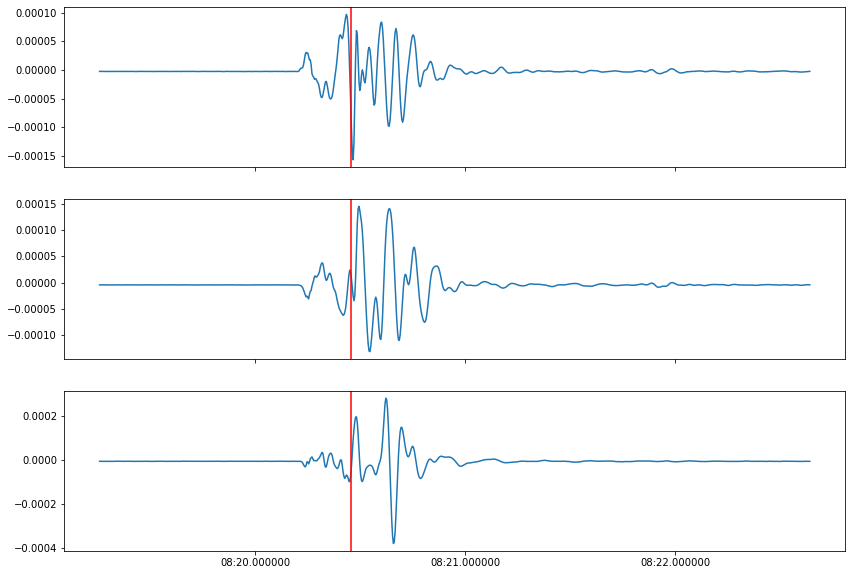

[UTCDateTime(2020, 3, 9, 9, 8, 20, 258007)]


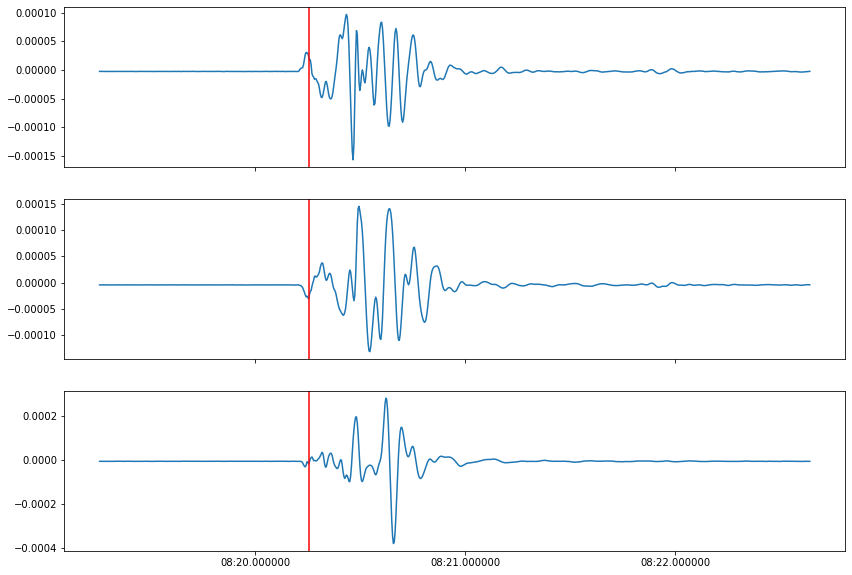

[UTCDateTime(2020, 3, 9, 9, 8, 20, 642007)]


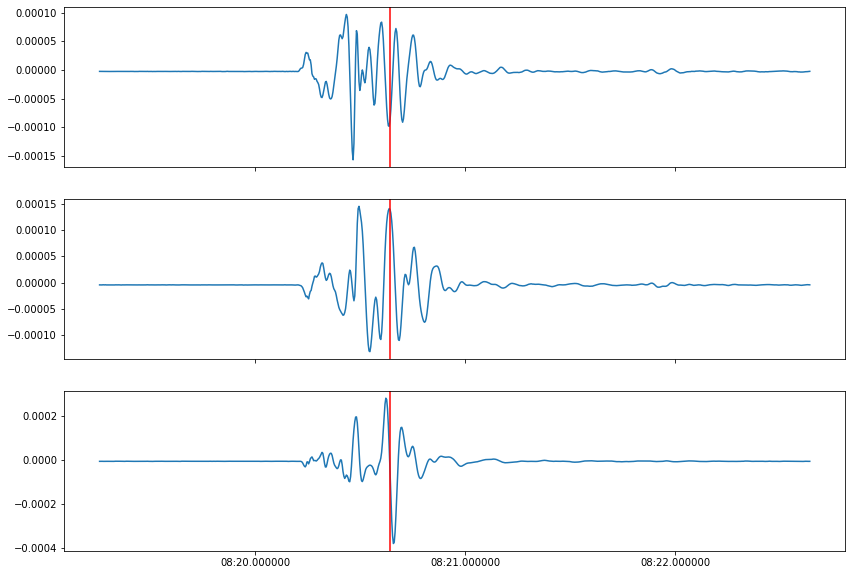

[UTCDateTime(2020, 3, 9, 9, 56, 2, 34181)]


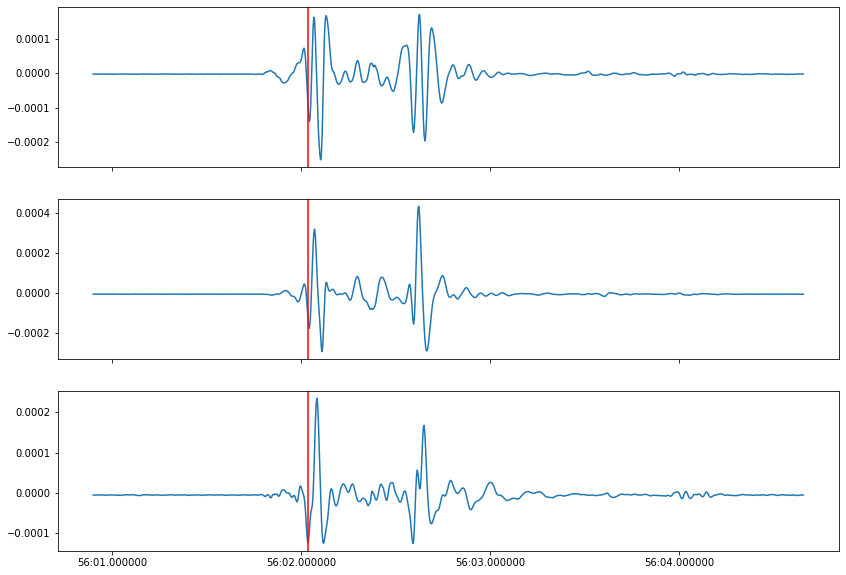

[UTCDateTime(2020, 3, 9, 9, 56, 2, 658181)]


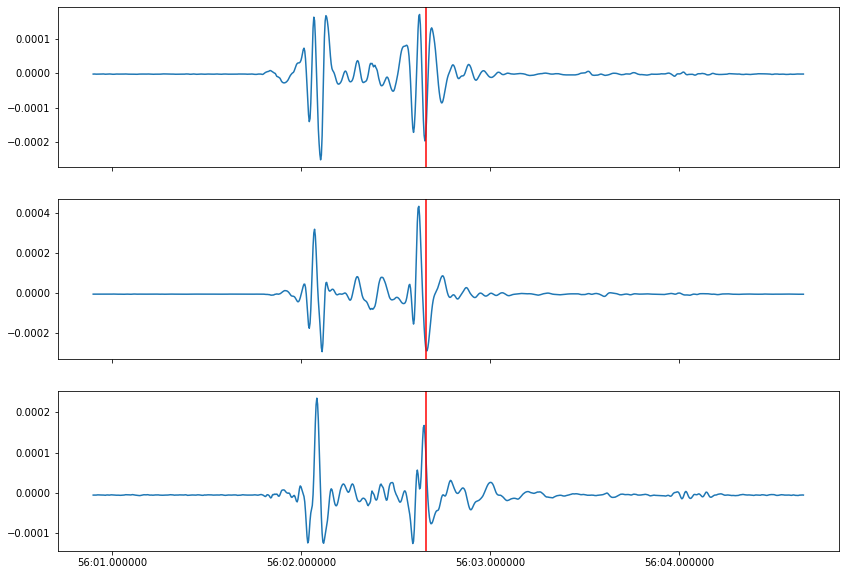

[UTCDateTime(2020, 3, 9, 9, 56, 2, 570181)]


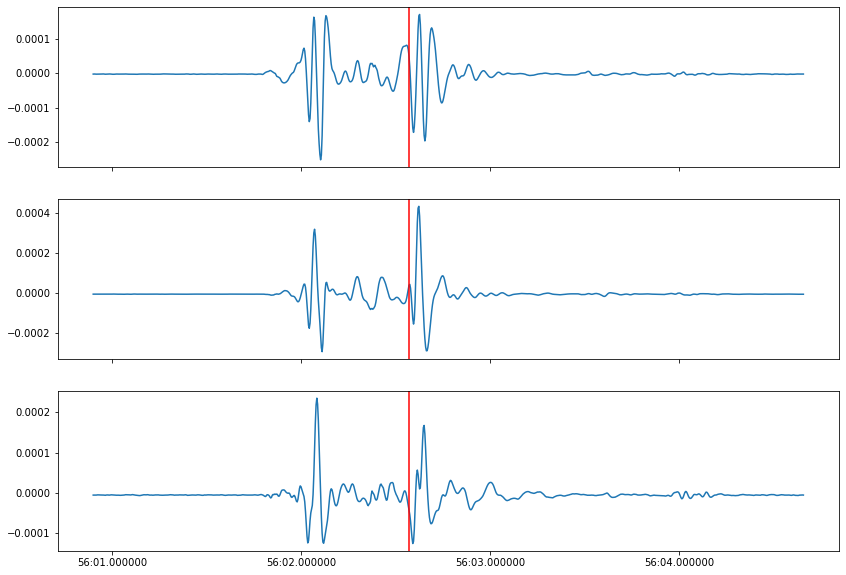

[UTCDateTime(2020, 3, 9, 9, 56, 1, 898182)]


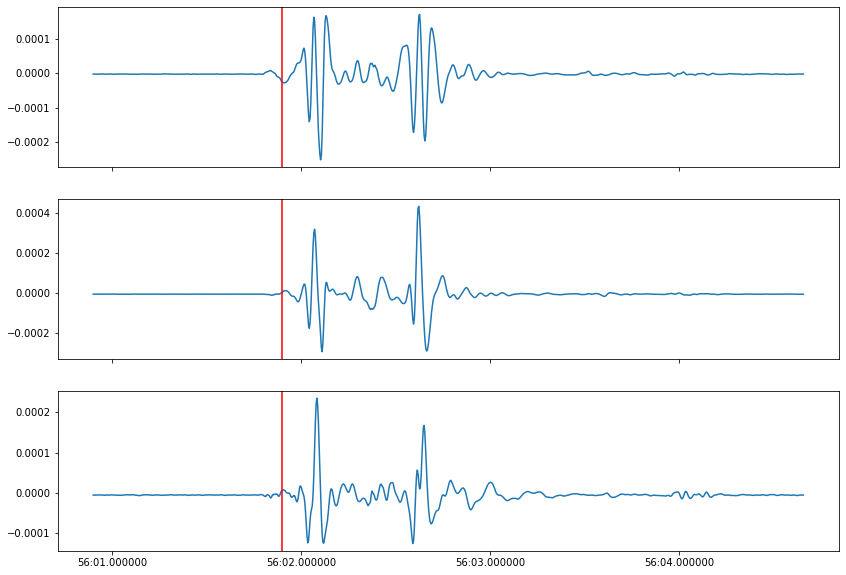

[UTCDateTime(2020, 3, 9, 9, 59, 2, 490193)]


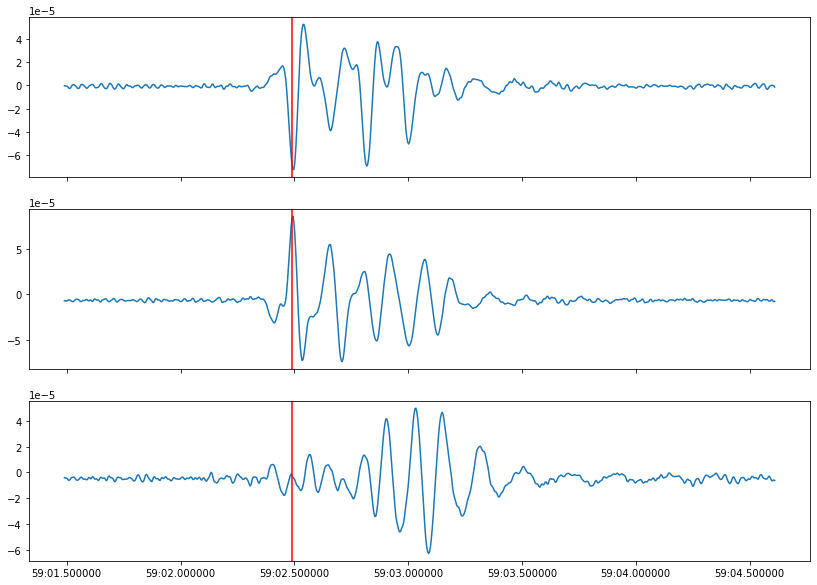

[UTCDateTime(2020, 3, 9, 9, 59, 2, 610193)]


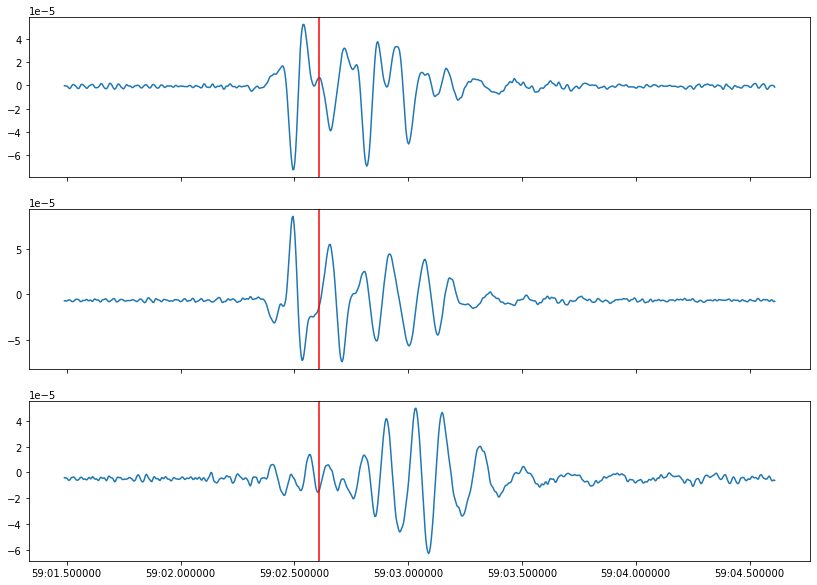

[UTCDateTime(2020, 3, 9, 9, 59, 2, 522193)]


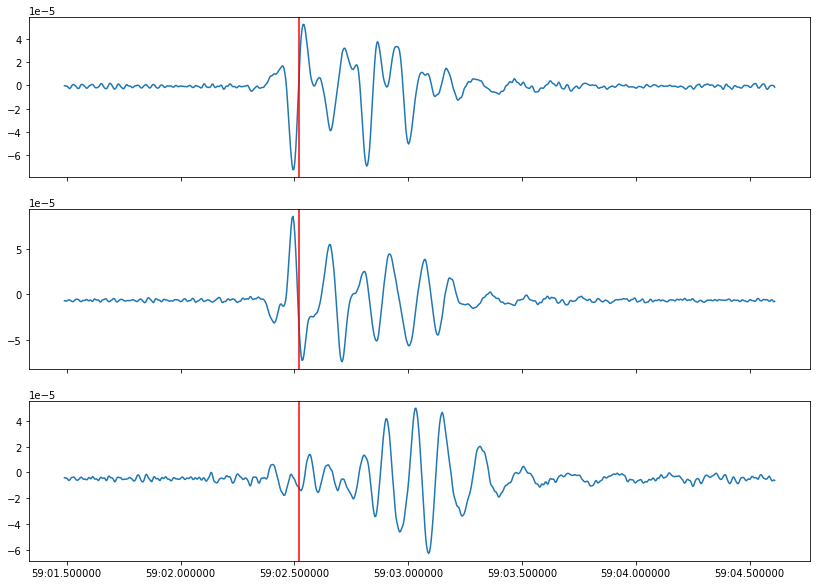

[UTCDateTime(2020, 3, 9, 10, 35, 11, 106325)]


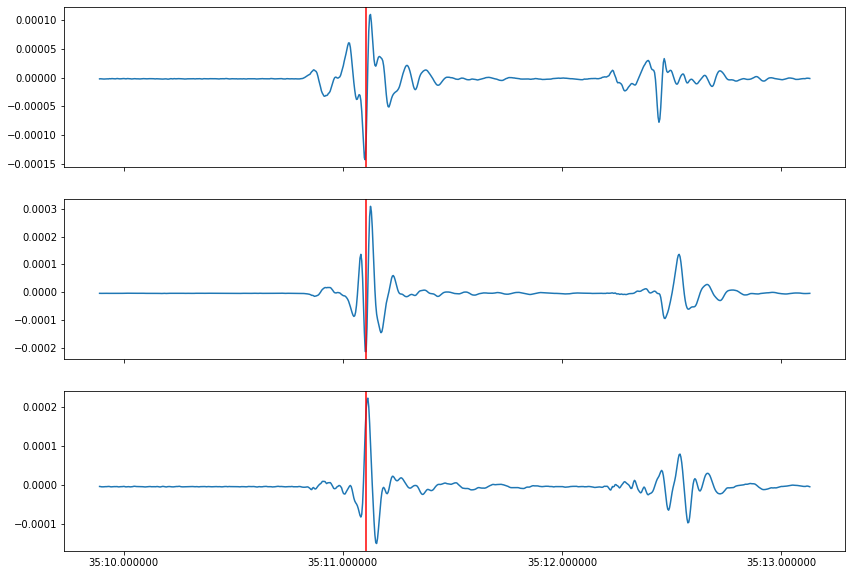

[UTCDateTime(2020, 3, 9, 10, 35, 11, 130325)]


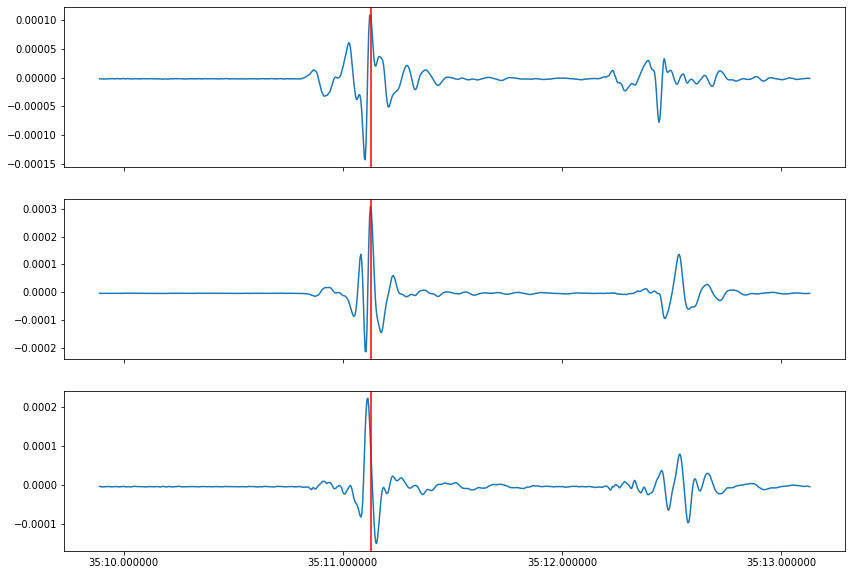

[UTCDateTime(2020, 3, 9, 10, 35, 11, 74325)]


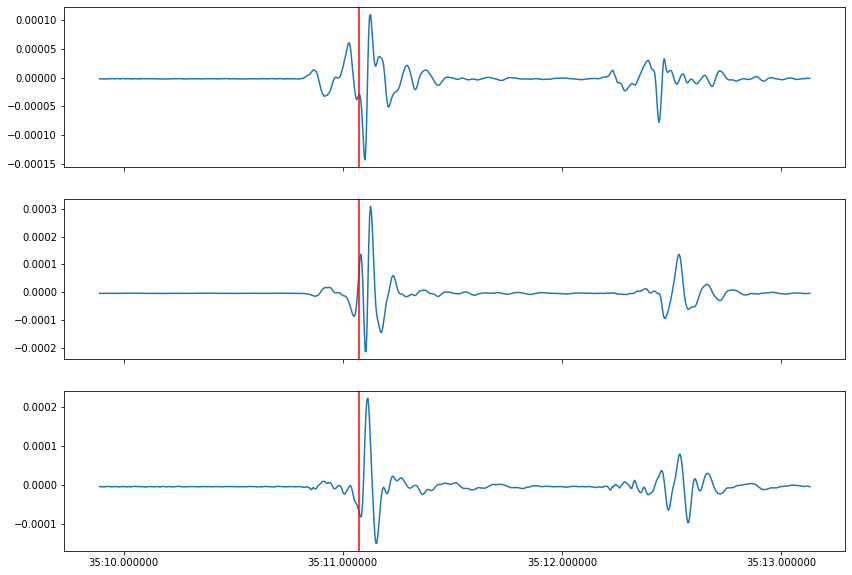

[UTCDateTime(2020, 3, 9, 10, 35, 10, 890325)]


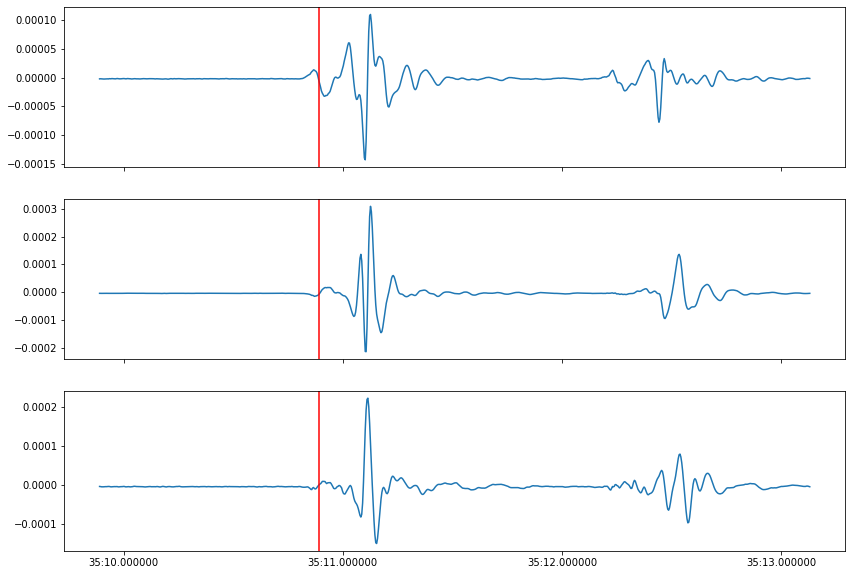

[UTCDateTime(2020, 3, 9, 10, 38, 2, 690336)]


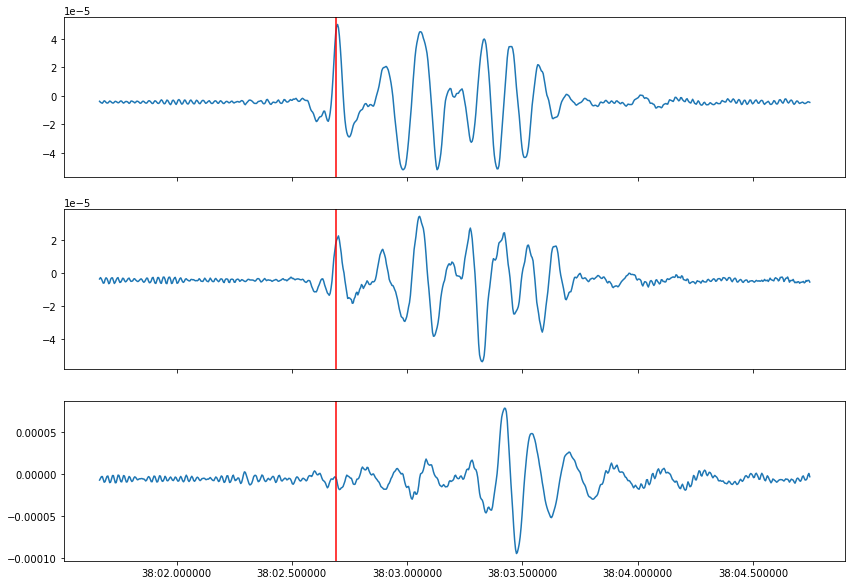

[UTCDateTime(2020, 3, 9, 10, 38, 2, 746335)]


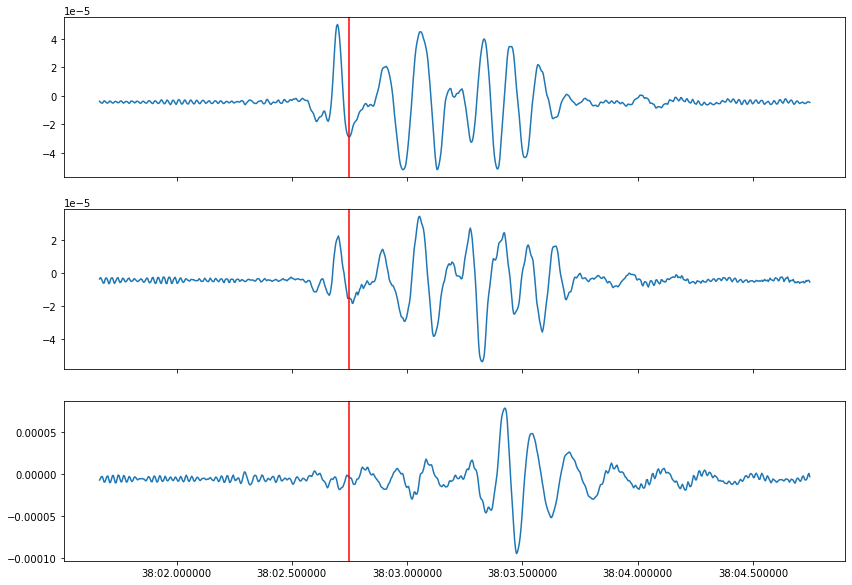

[UTCDateTime(2020, 3, 9, 10, 38, 2, 666335)]


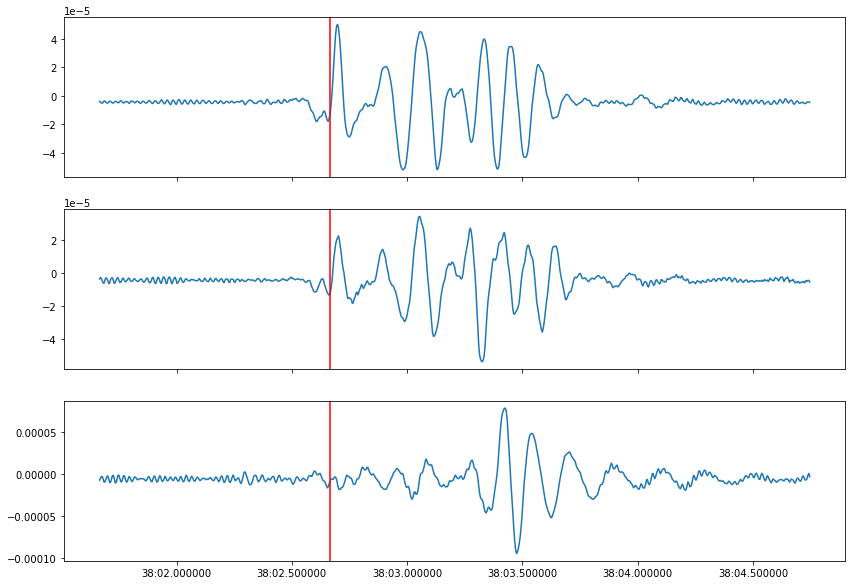

[UTCDateTime(2020, 3, 9, 10, 42, 32, 226352)]


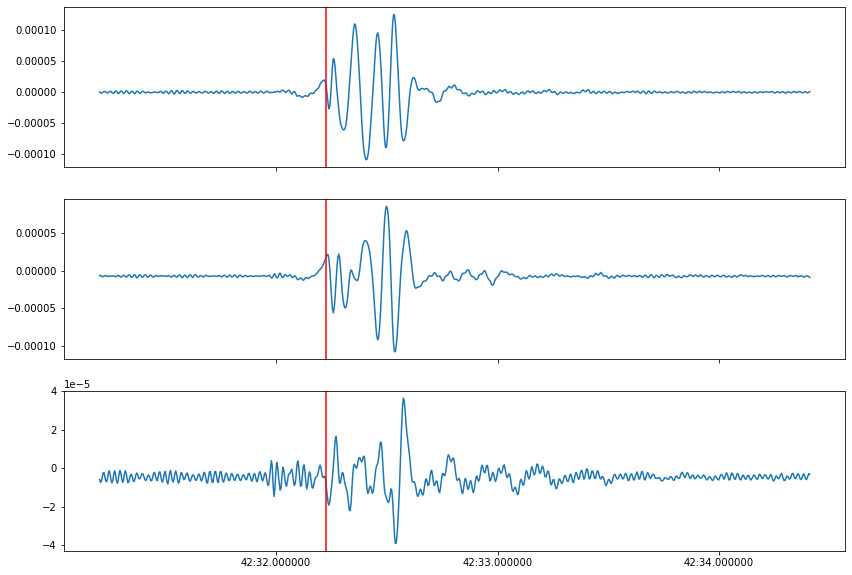

[UTCDateTime(2020, 3, 9, 10, 42, 32, 410353)]


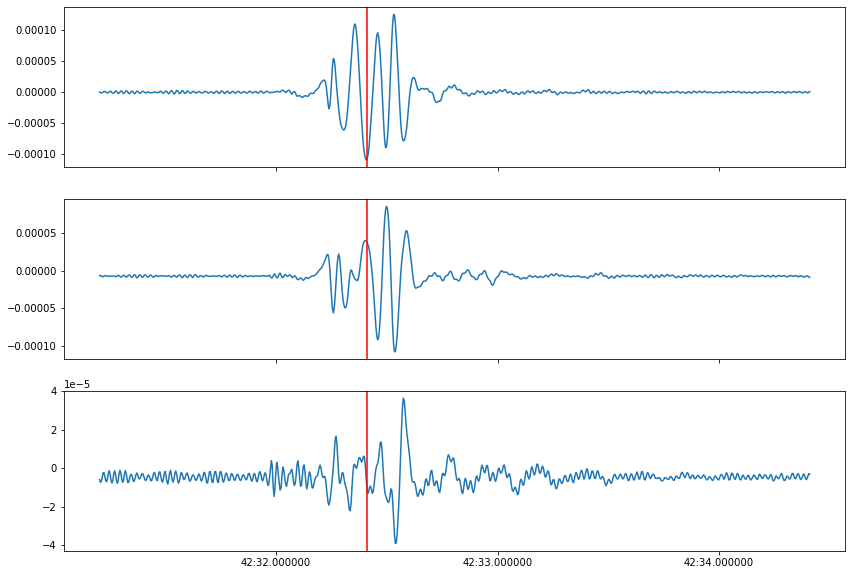

[UTCDateTime(2020, 3, 9, 10, 42, 32, 202352)]


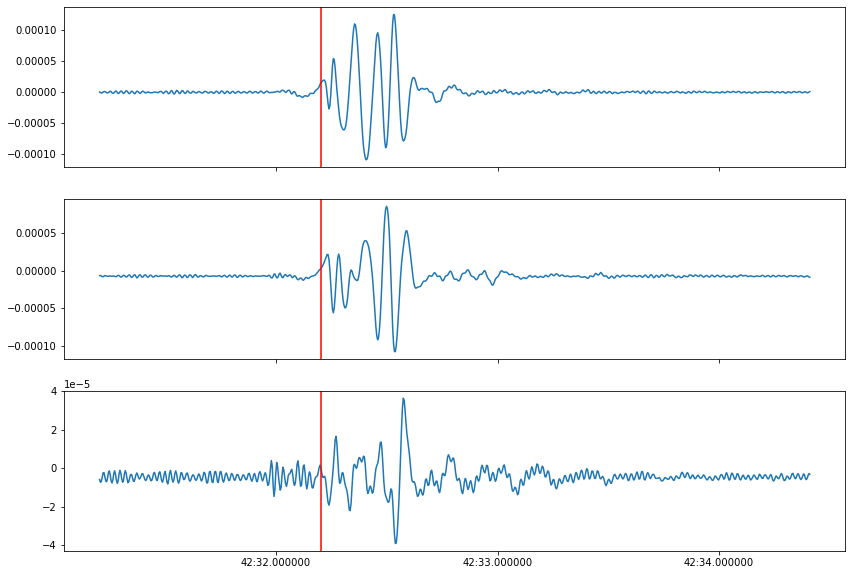

[UTCDateTime(2020, 3, 9, 10, 46, 20, 154366)]


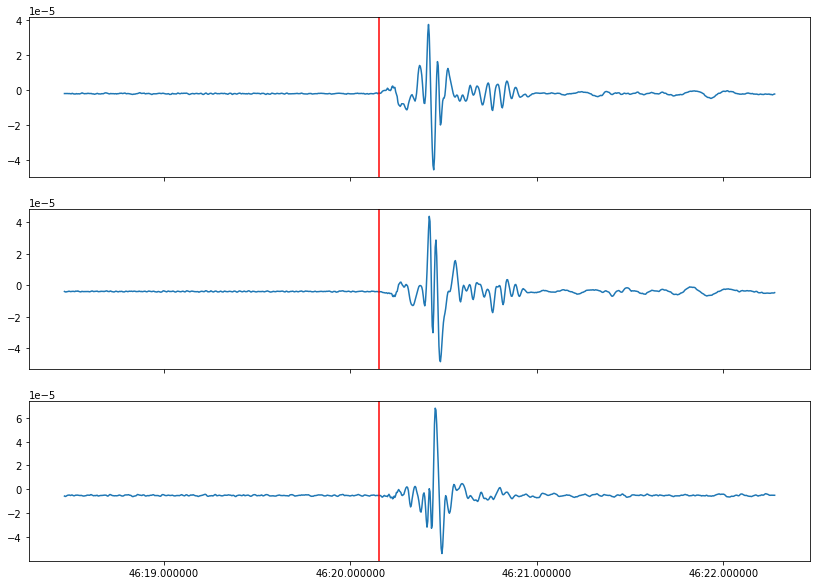

[UTCDateTime(2020, 3, 9, 10, 46, 20, 274365), UTCDateTime(2020, 3, 9, 10, 46, 20, 274365)]


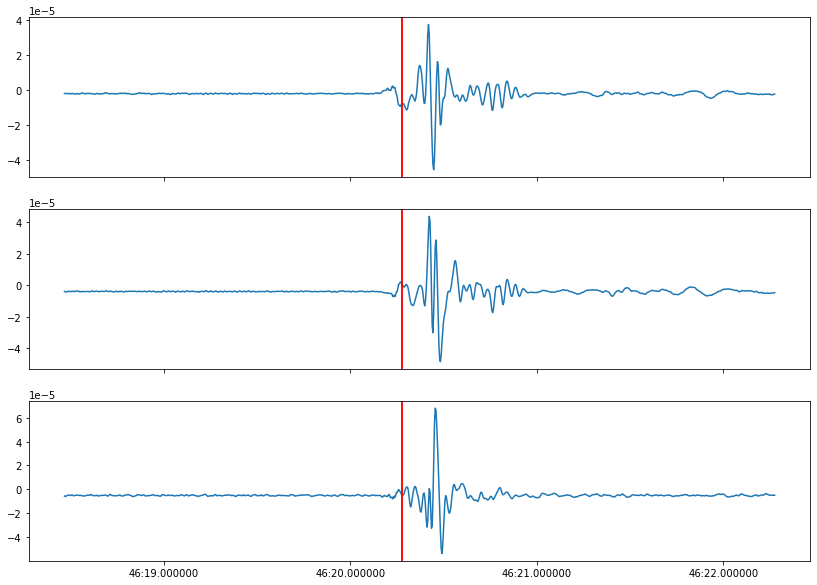

[UTCDateTime(2020, 3, 9, 10, 46, 20, 226366)]


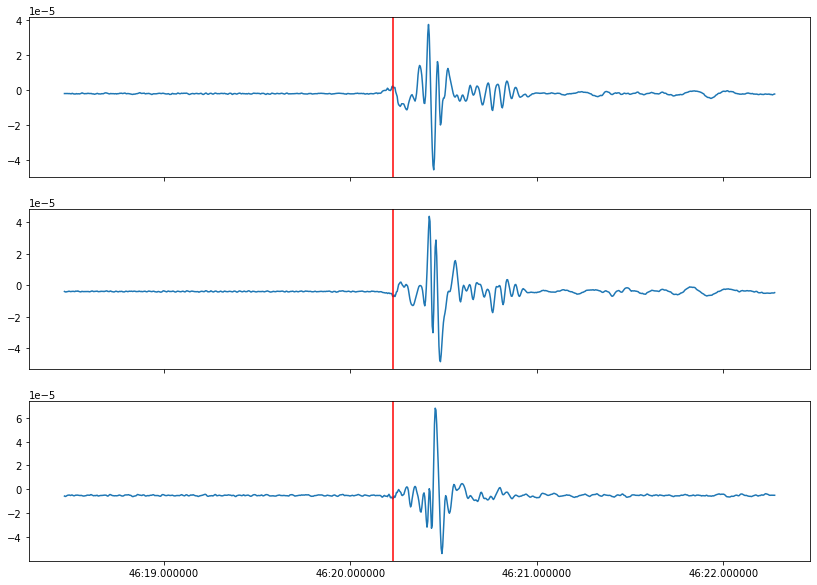

[UTCDateTime(2020, 3, 9, 10, 46, 19, 466366)]


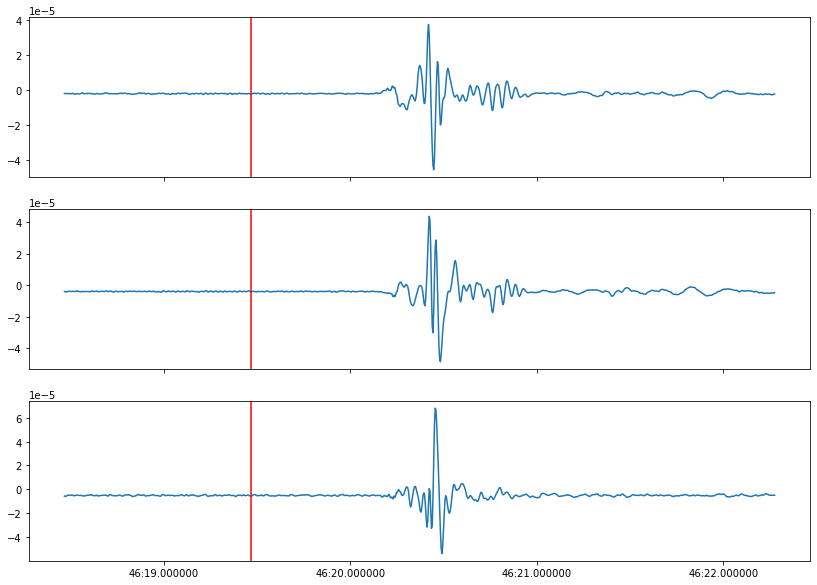

[UTCDateTime(2020, 3, 9, 10, 57, 43, 530407)]


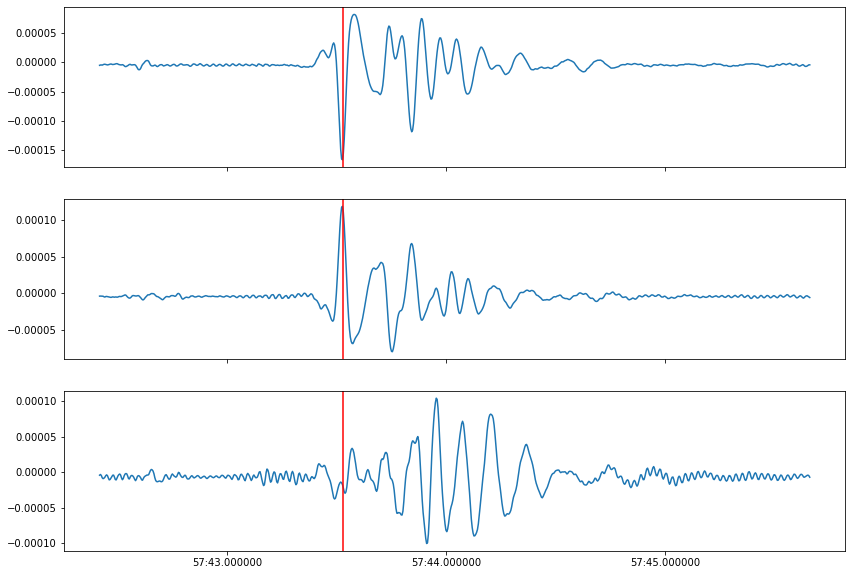

[UTCDateTime(2020, 3, 9, 10, 57, 43, 658407)]


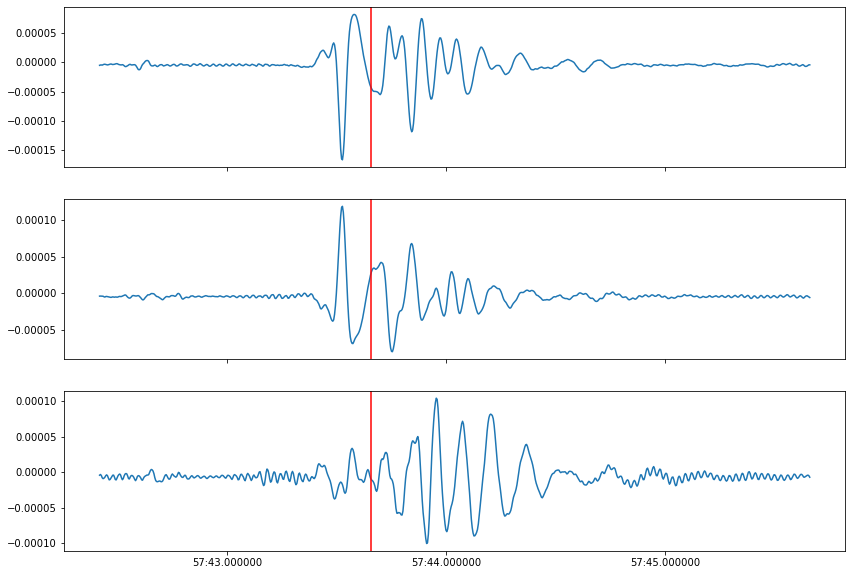

[UTCDateTime(2020, 3, 9, 10, 57, 43, 498407)]


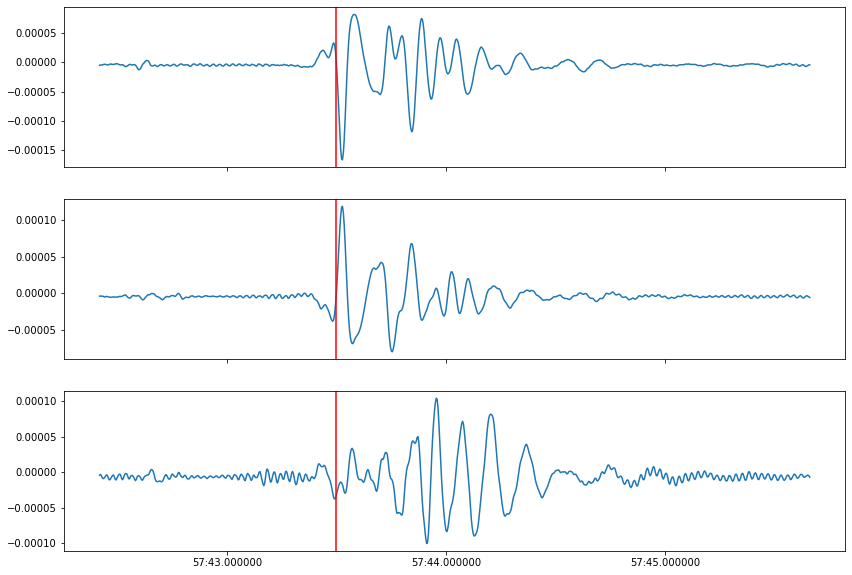

[UTCDateTime(2020, 3, 9, 10, 57, 43, 418407)]


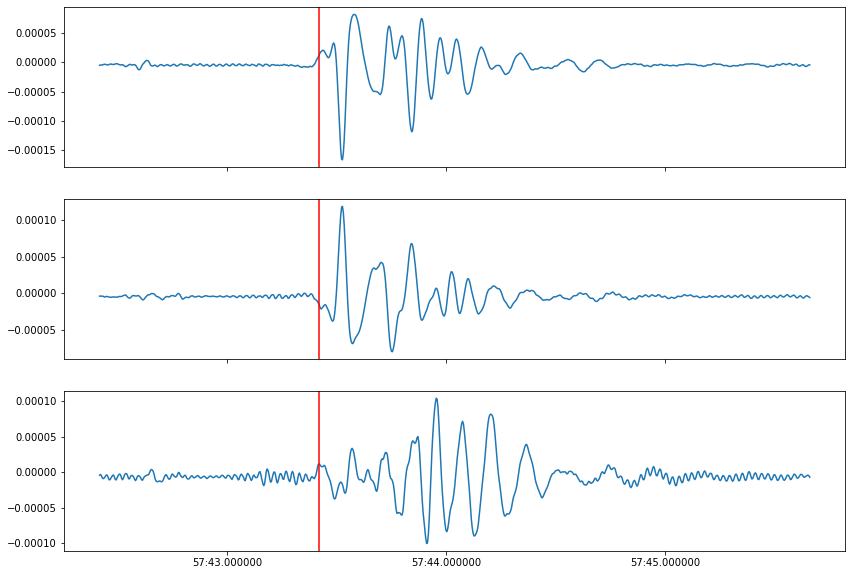

[UTCDateTime(2020, 3, 9, 10, 57, 43, 594407)]


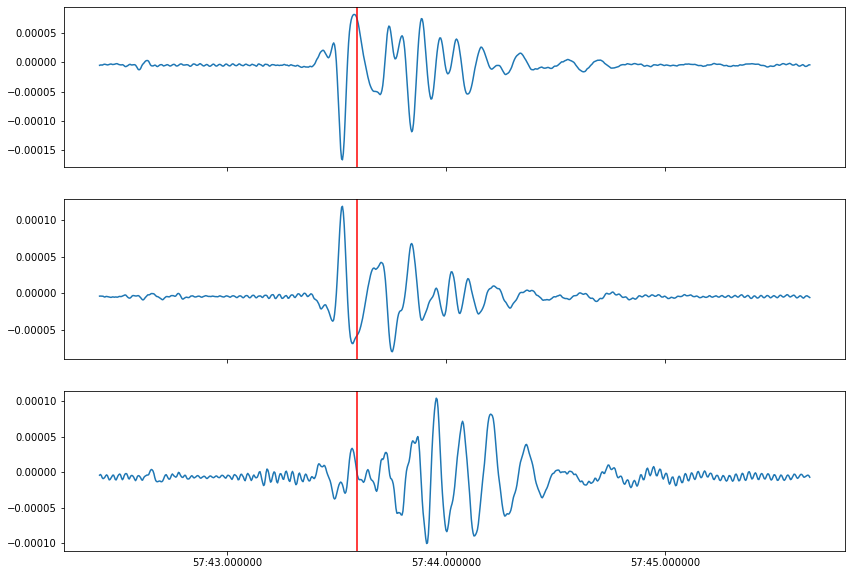

[UTCDateTime(2020, 3, 9, 10, 57, 43, 490407)]


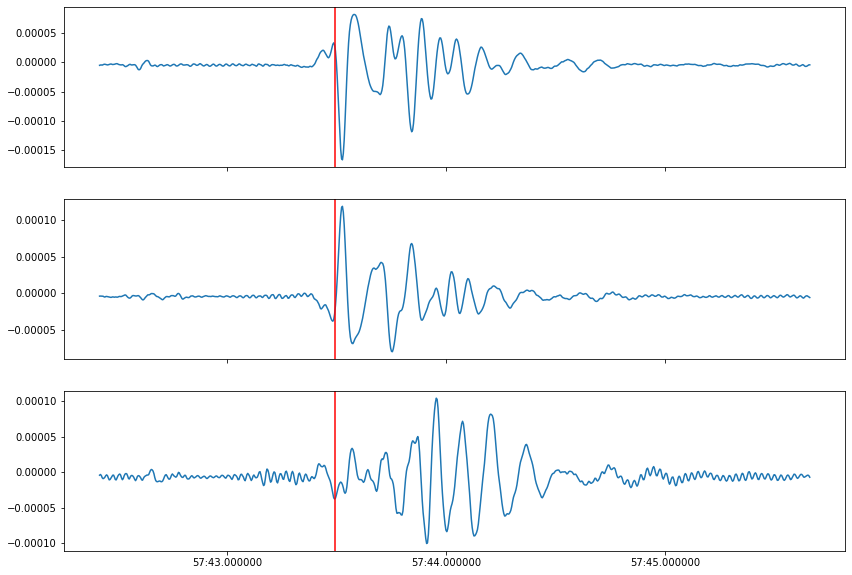

[UTCDateTime(2020, 3, 9, 10, 59, 45, 178415)]


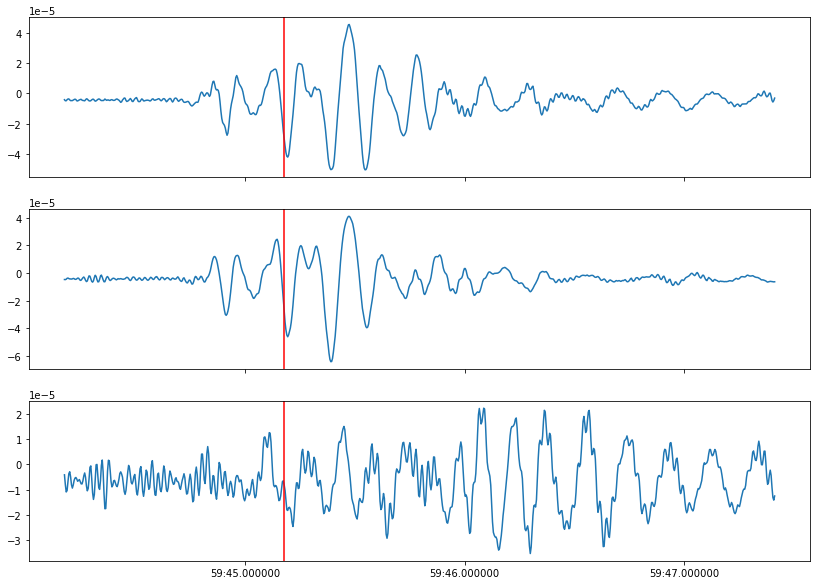

[UTCDateTime(2020, 3, 9, 10, 59, 45, 410415)]


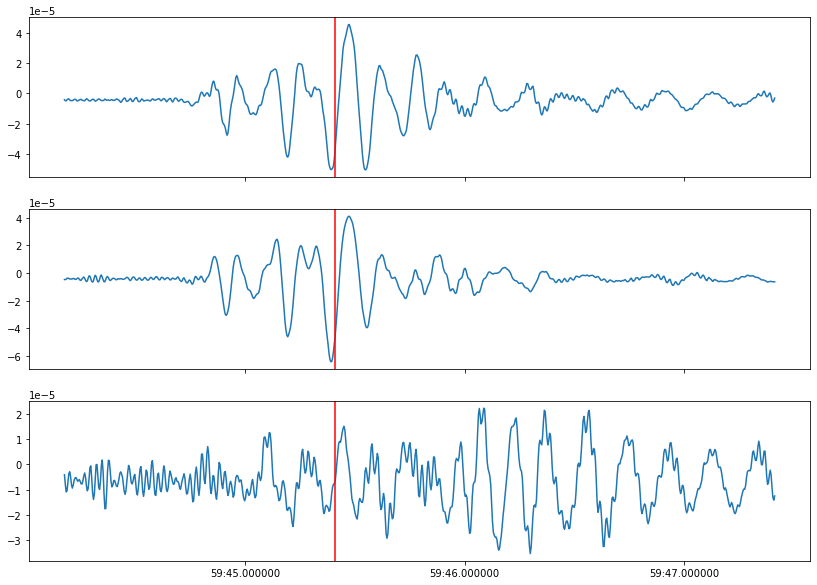

[UTCDateTime(2020, 3, 9, 10, 59, 45, 178415)]


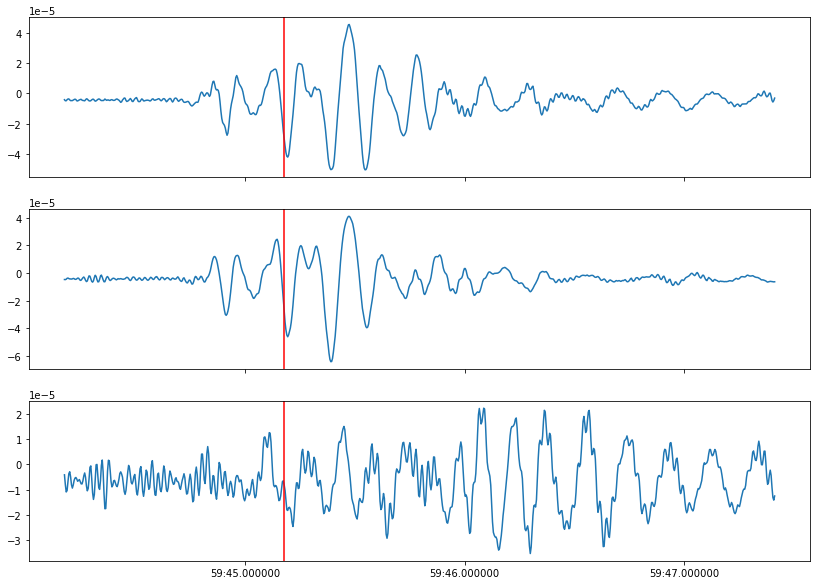

[UTCDateTime(2020, 3, 10, 2, 17, 48, 28503)]


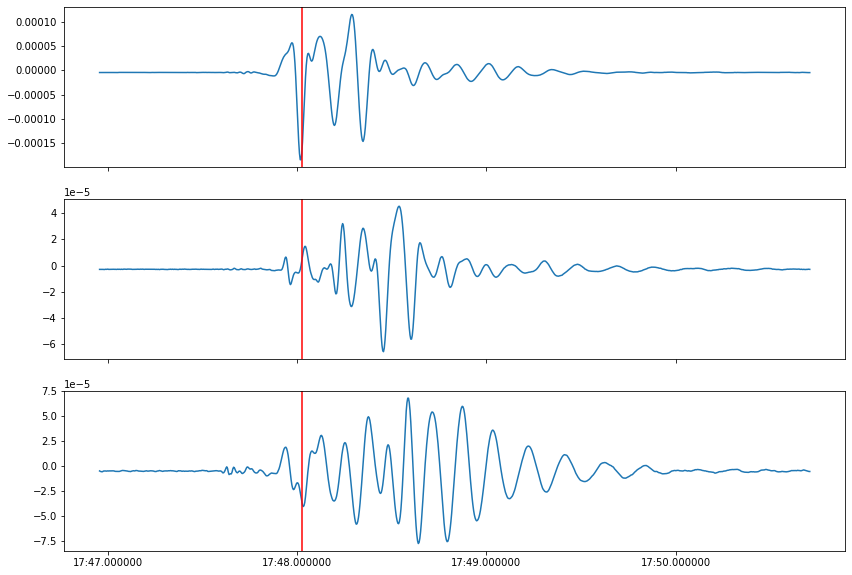

[UTCDateTime(2020, 3, 10, 2, 17, 47, 956503)]


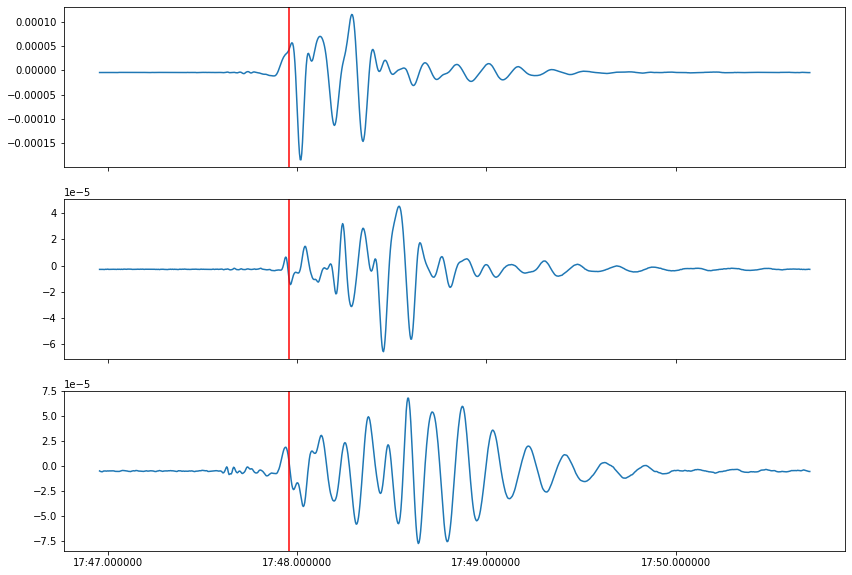

[UTCDateTime(2020, 3, 10, 2, 17, 48, 708503)]


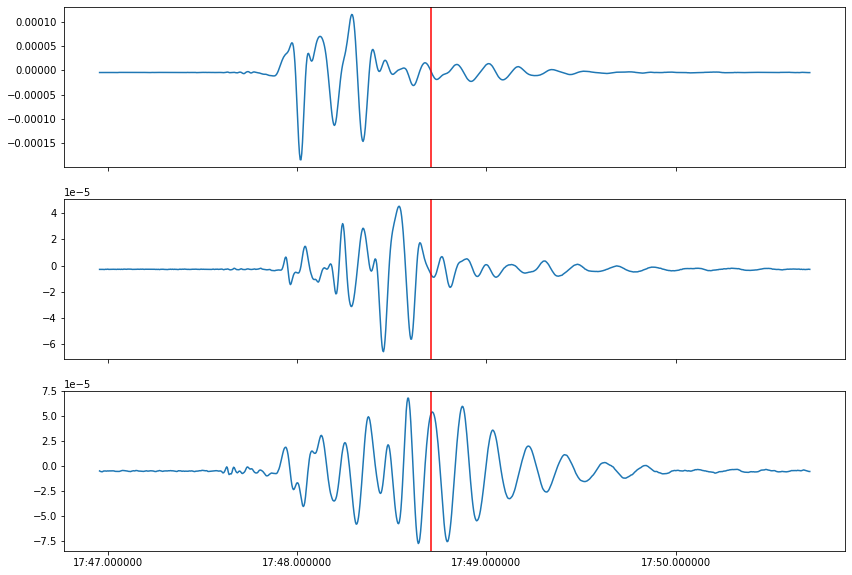

[UTCDateTime(2020, 3, 10, 2, 17, 48, 44503)]


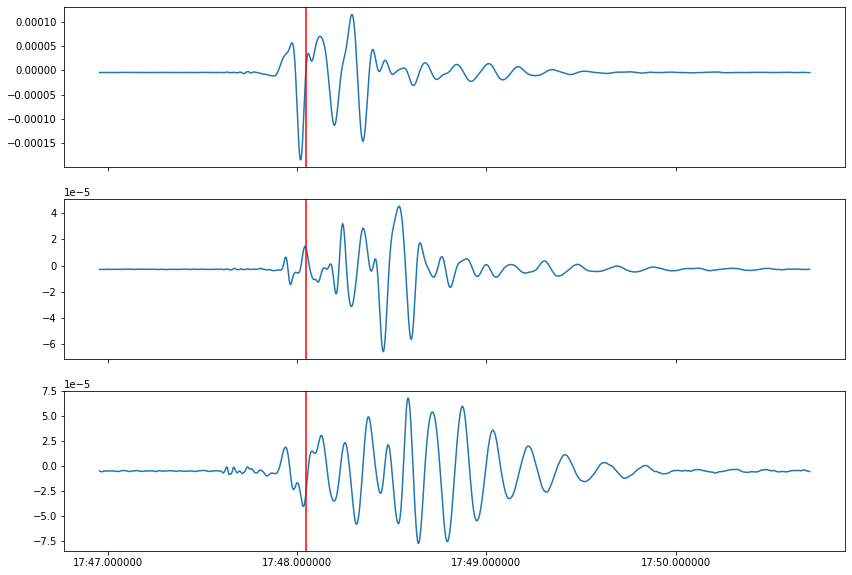

[UTCDateTime(2020, 3, 10, 2, 51, 11, 876626)]


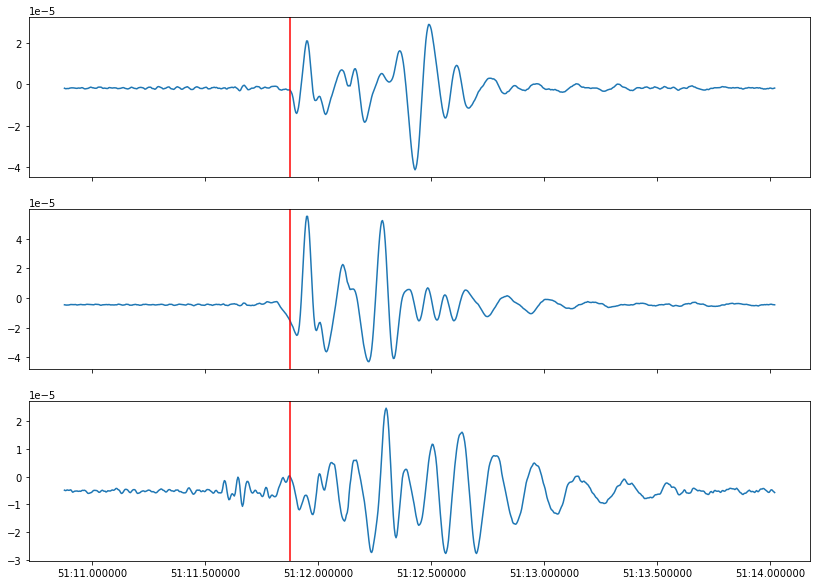

[UTCDateTime(2020, 3, 10, 2, 51, 11, 932626)]


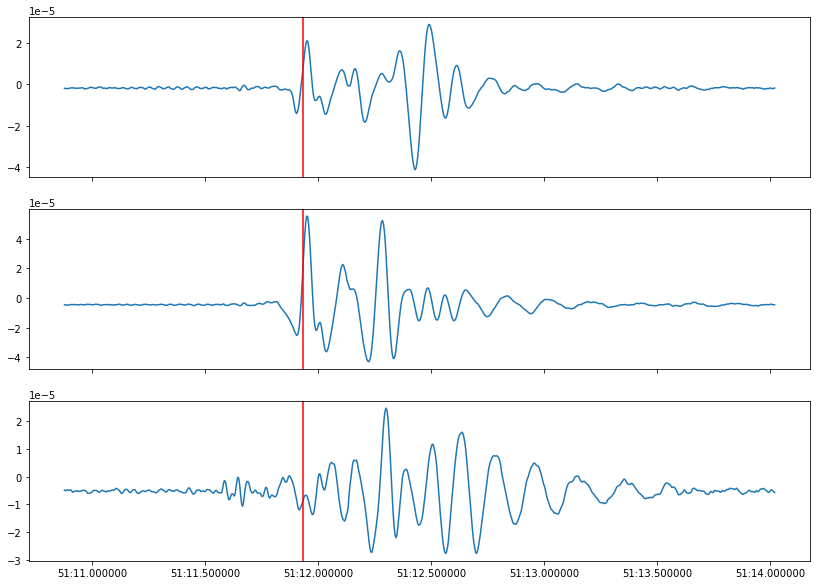

[UTCDateTime(2020, 3, 10, 2, 51, 12, 20626)]


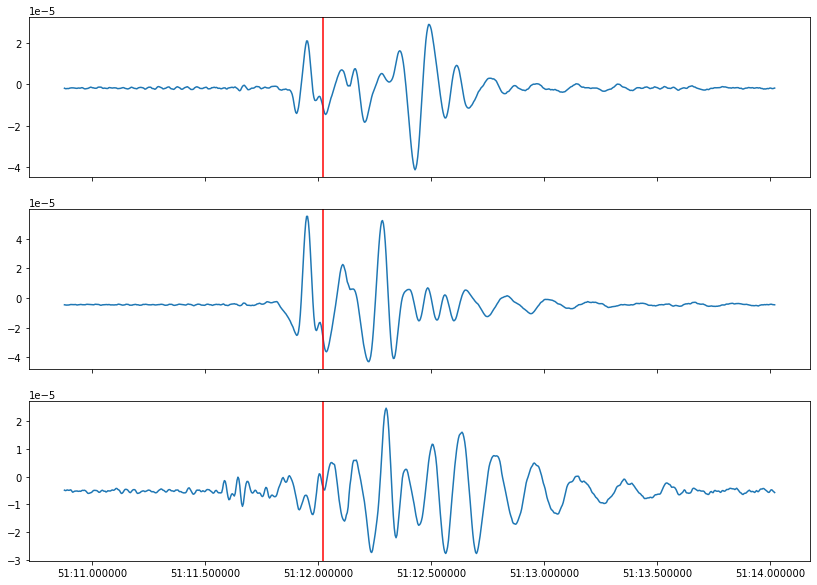

[UTCDateTime(2020, 3, 10, 2, 51, 11, 908626)]


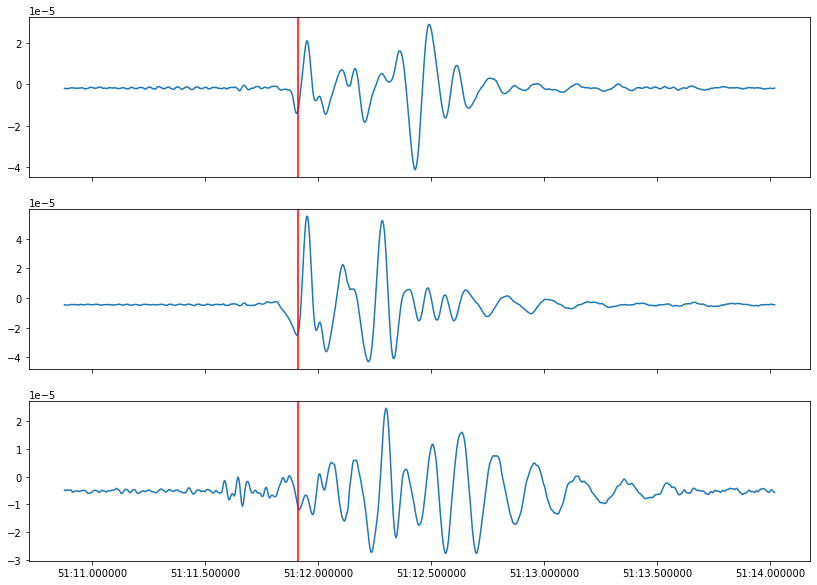

[UTCDateTime(2020, 3, 10, 3, 18, 21, 356725)]


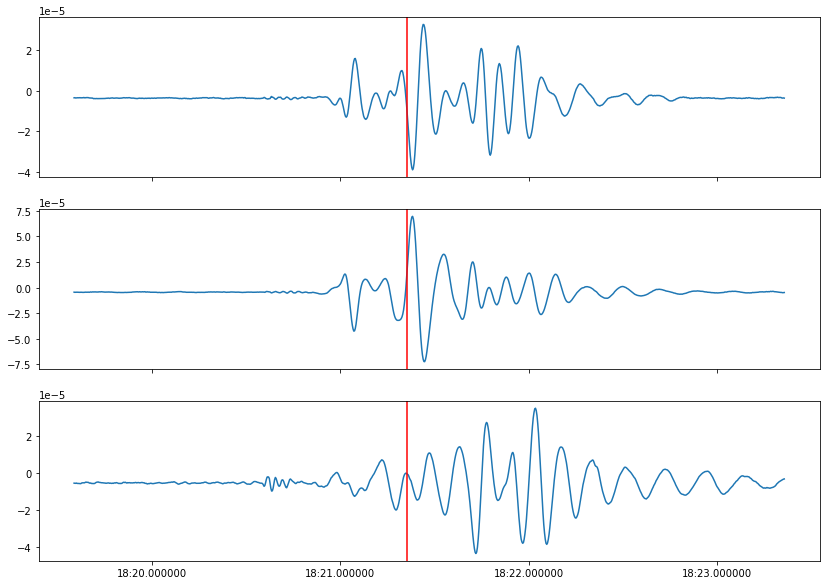

[UTCDateTime(2020, 3, 10, 3, 18, 20, 892725)]


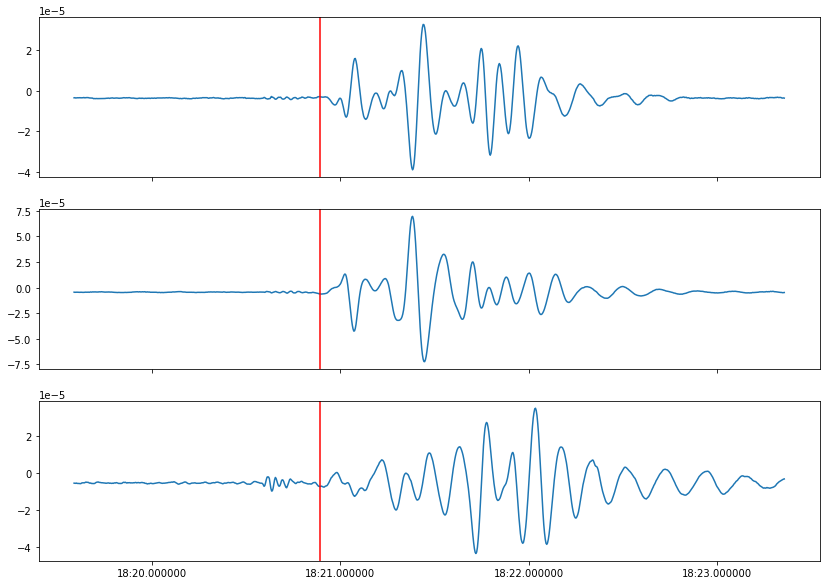

[UTCDateTime(2020, 3, 10, 3, 18, 20, 780725)]


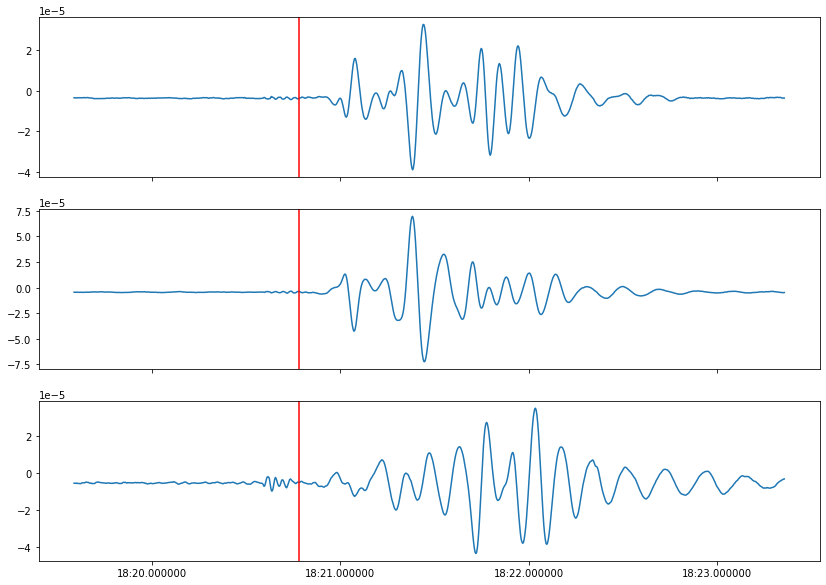

[UTCDateTime(2020, 3, 10, 3, 18, 20, 908725)]


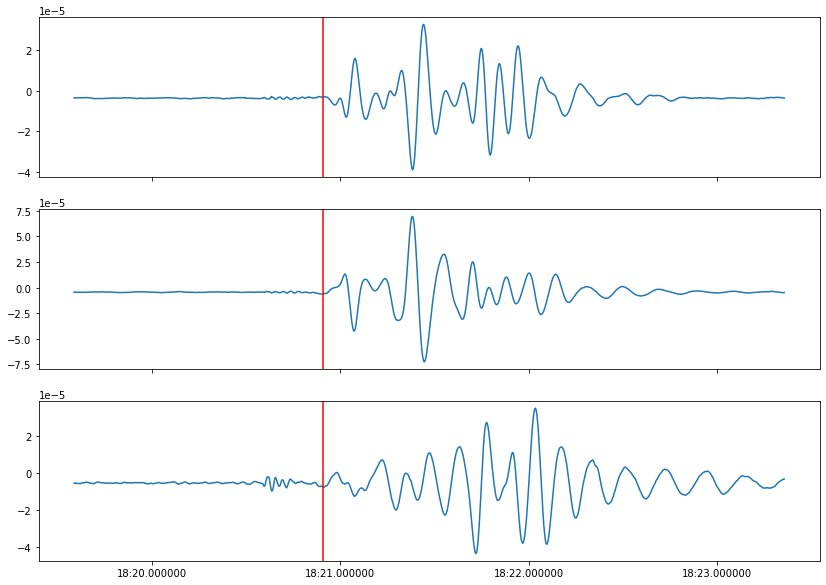

[UTCDateTime(2020, 3, 10, 3, 18, 20, 924725)]


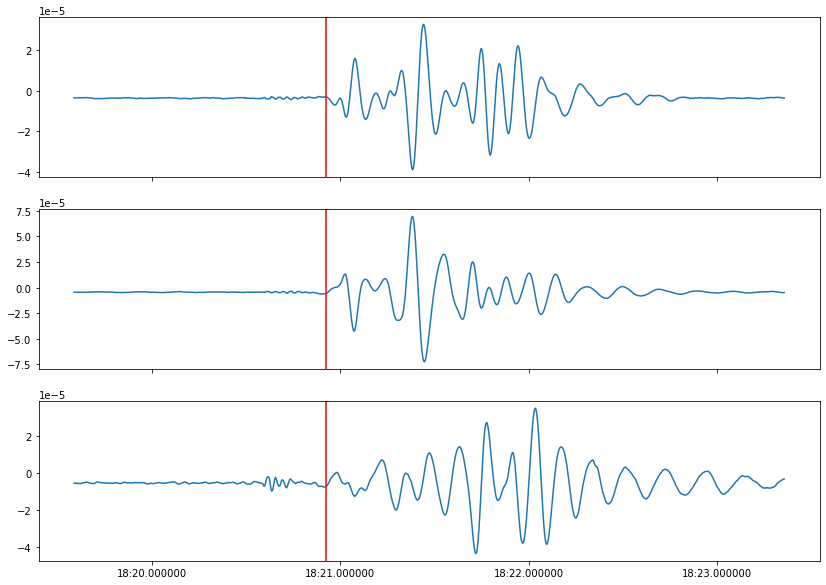

[UTCDateTime(2020, 3, 10, 3, 18, 20, 588725)]


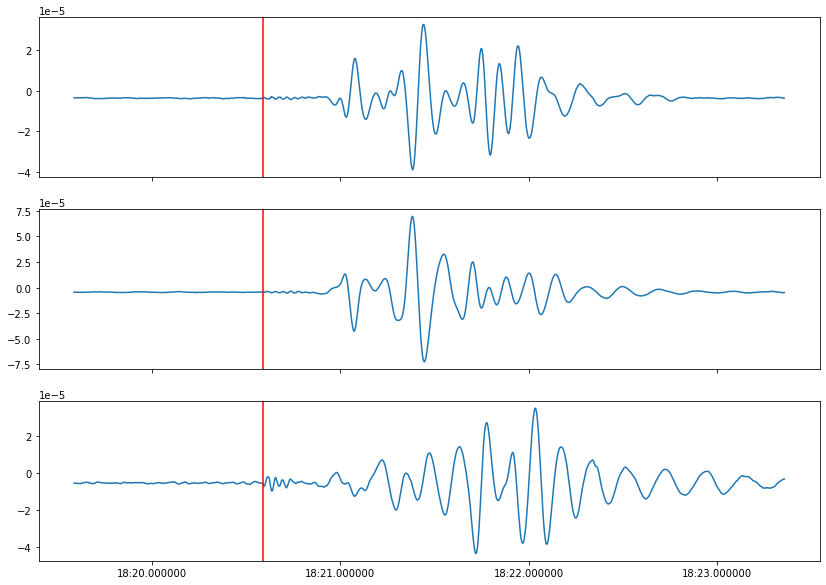

[UTCDateTime(2020, 3, 10, 3, 18, 21, 148725)]


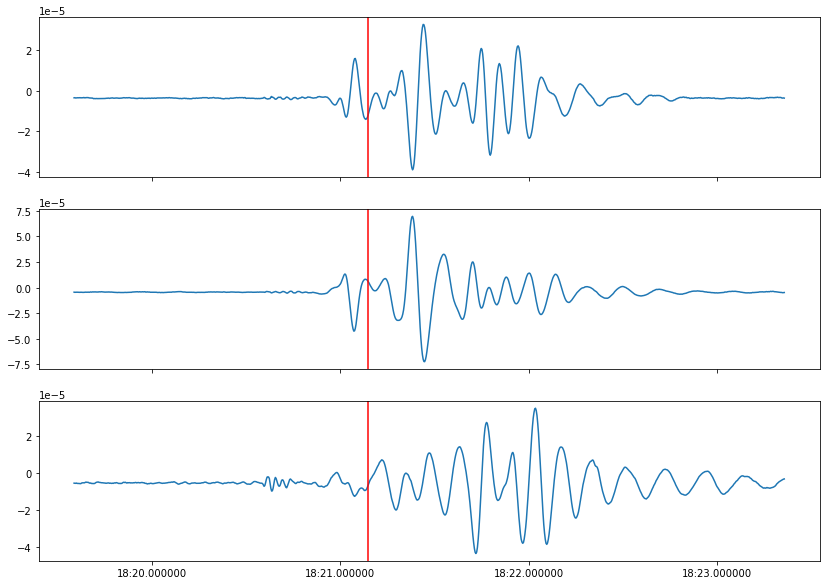

[UTCDateTime(2020, 3, 10, 3, 18, 21, 356725)]


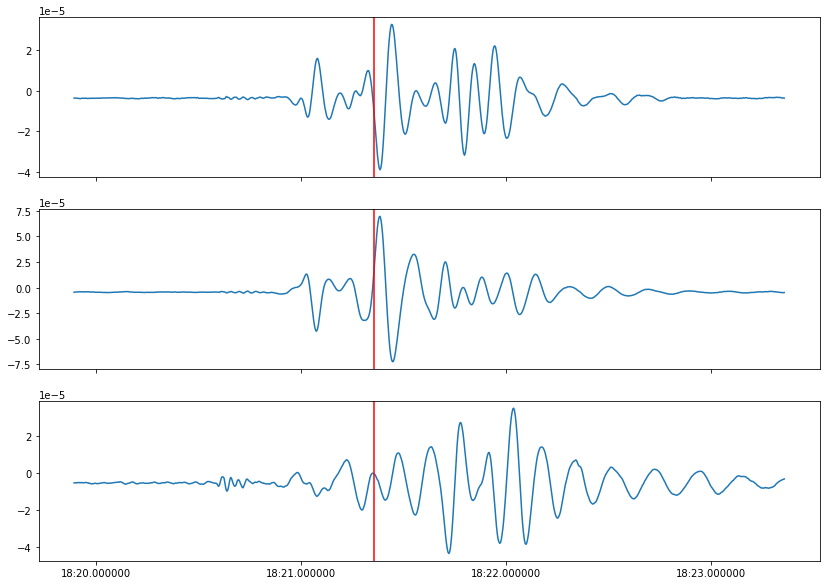

[UTCDateTime(2020, 3, 10, 3, 18, 20, 892725)]


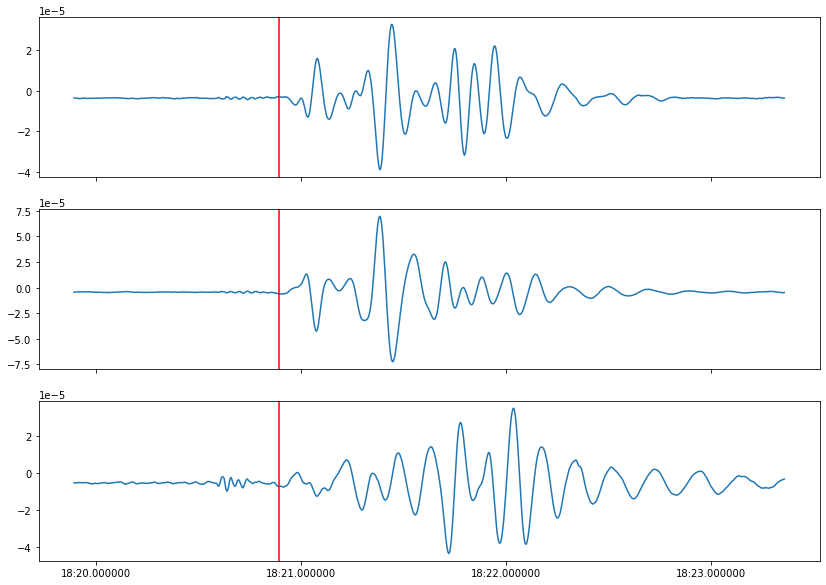

[UTCDateTime(2020, 3, 10, 3, 18, 20, 908725)]


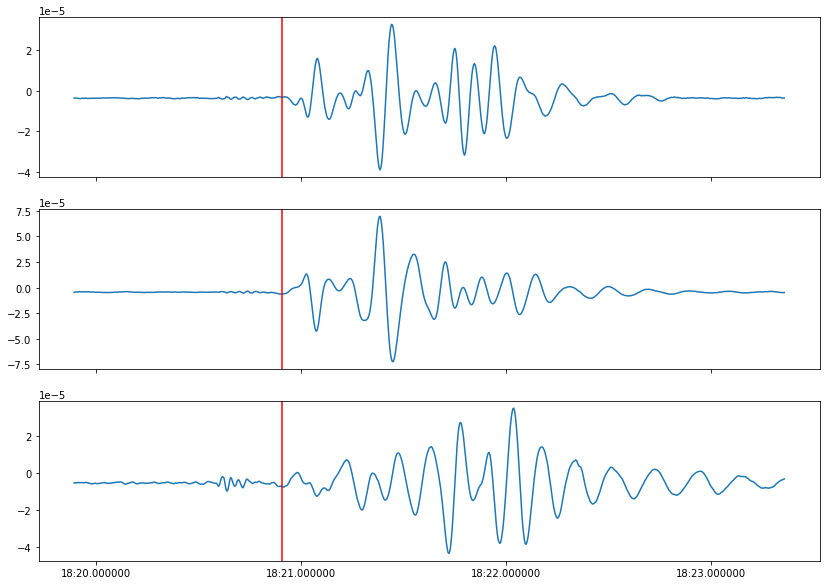

[UTCDateTime(2020, 3, 10, 3, 18, 20, 924725)]


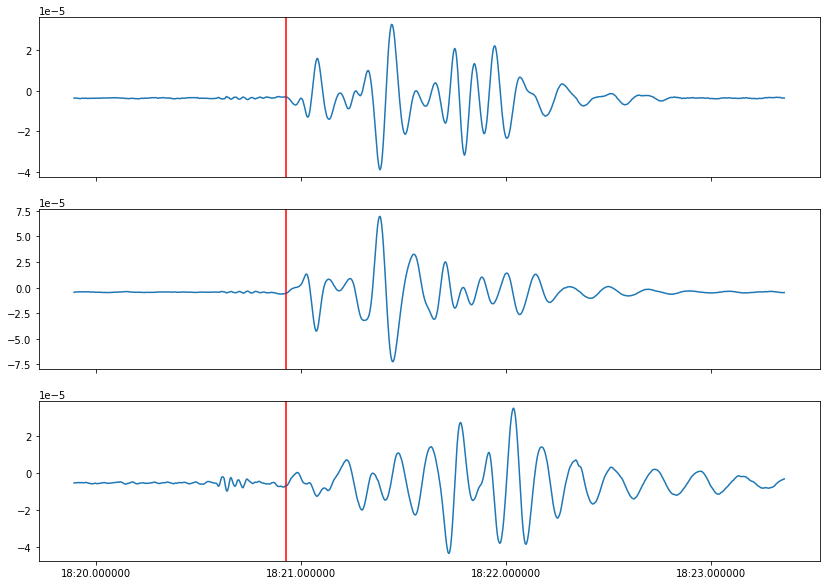

[UTCDateTime(2020, 3, 10, 3, 18, 21, 148725)]


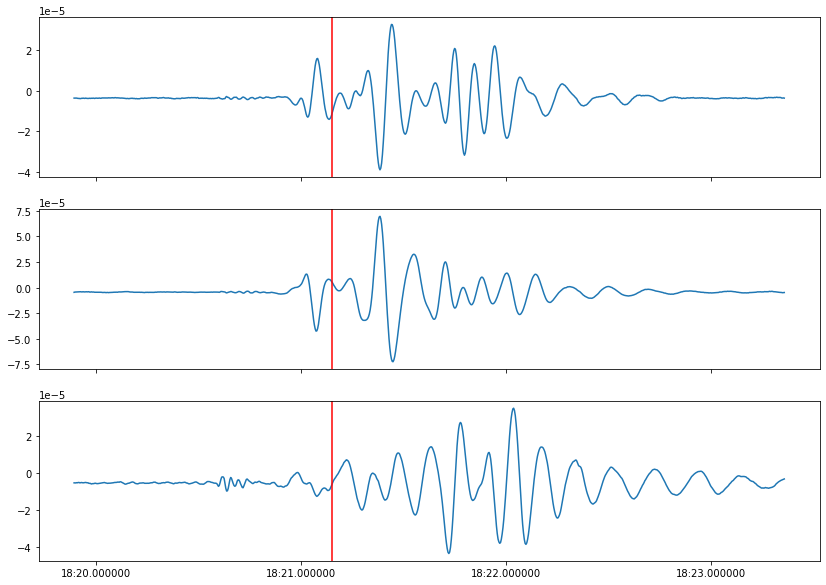

[UTCDateTime(2020, 3, 10, 3, 22, 45, 548742)]


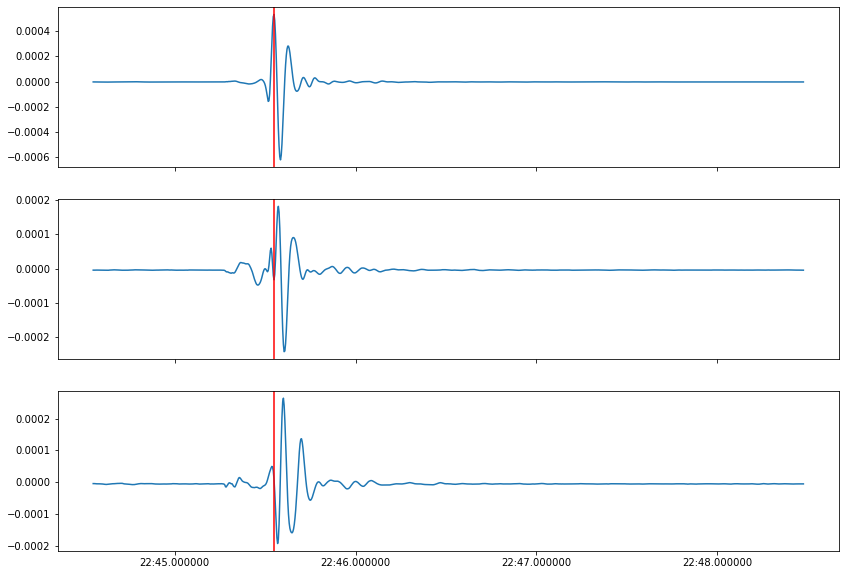

[UTCDateTime(2020, 3, 10, 3, 22, 45, 620742)]


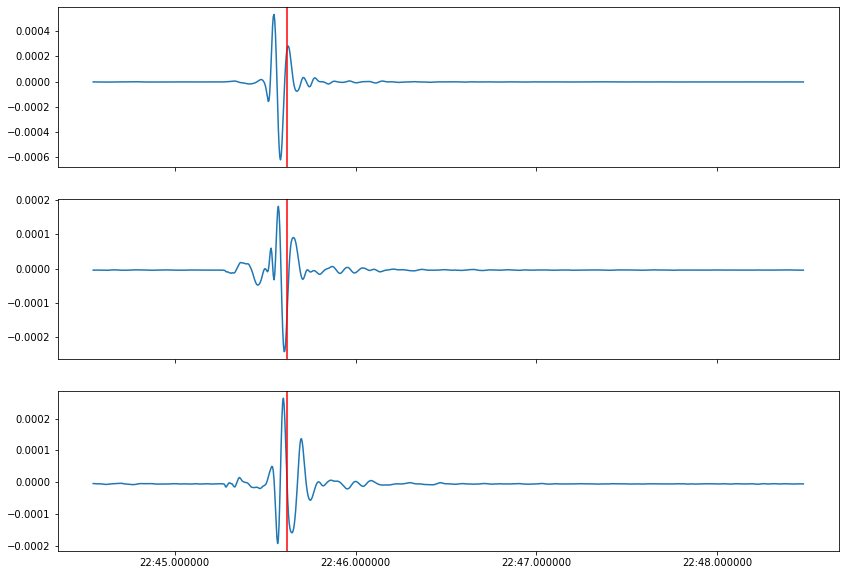

[UTCDateTime(2020, 3, 10, 3, 22, 45, 676742)]


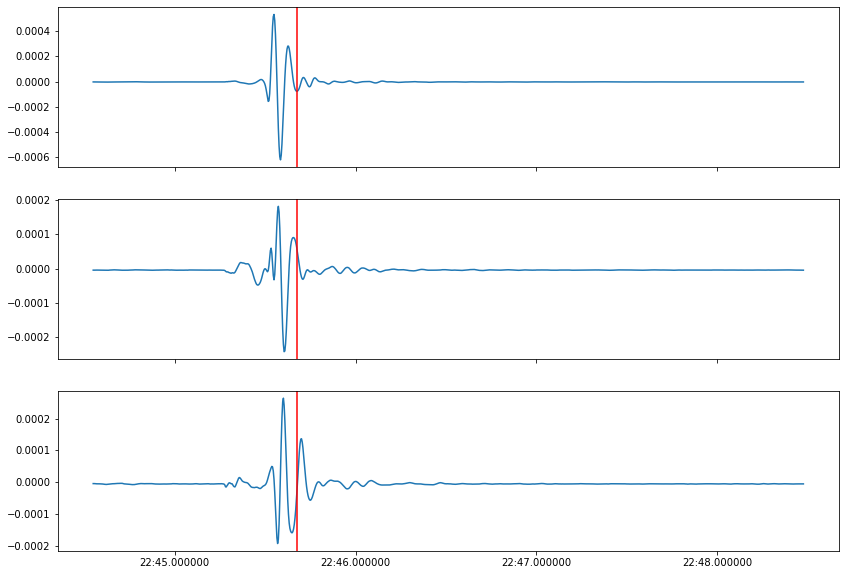

[UTCDateTime(2020, 3, 10, 3, 22, 46, 476742)]


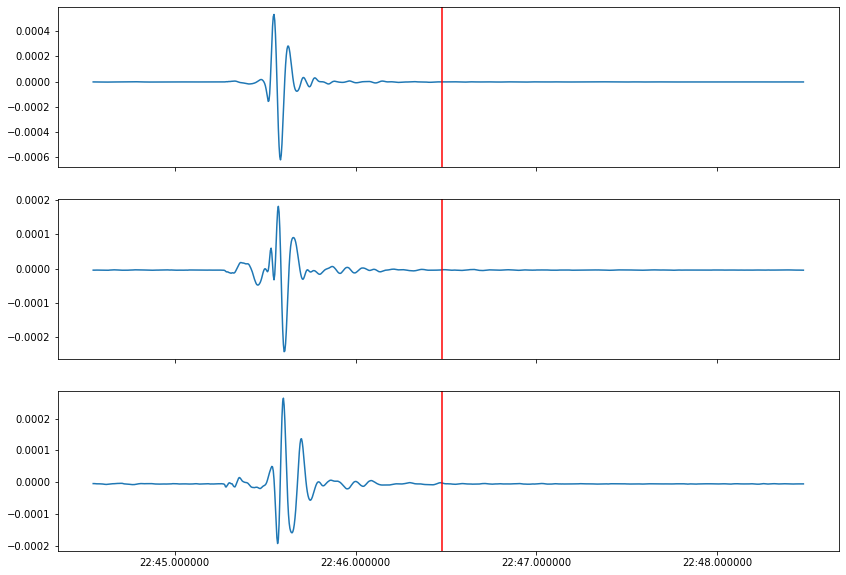

[UTCDateTime(2020, 3, 10, 3, 22, 45, 668742)]


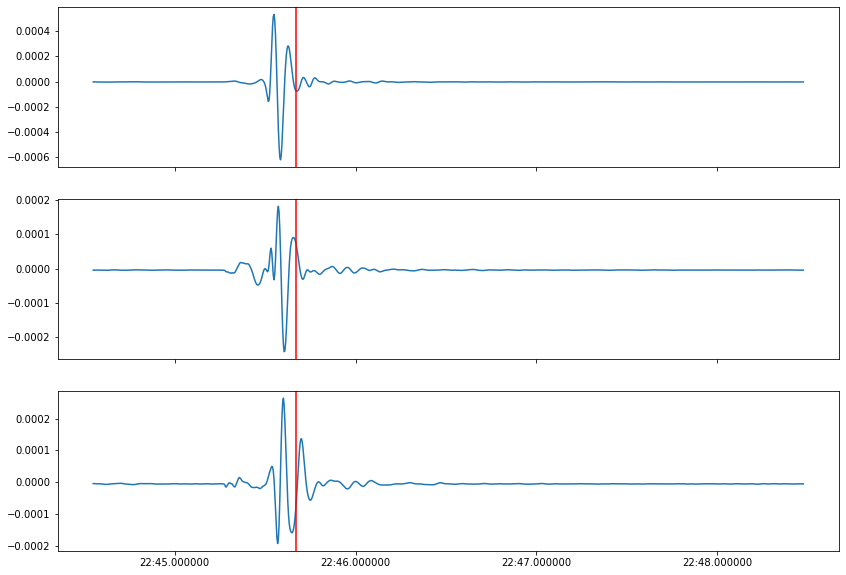

[UTCDateTime(2020, 3, 10, 3, 22, 45, 692742)]


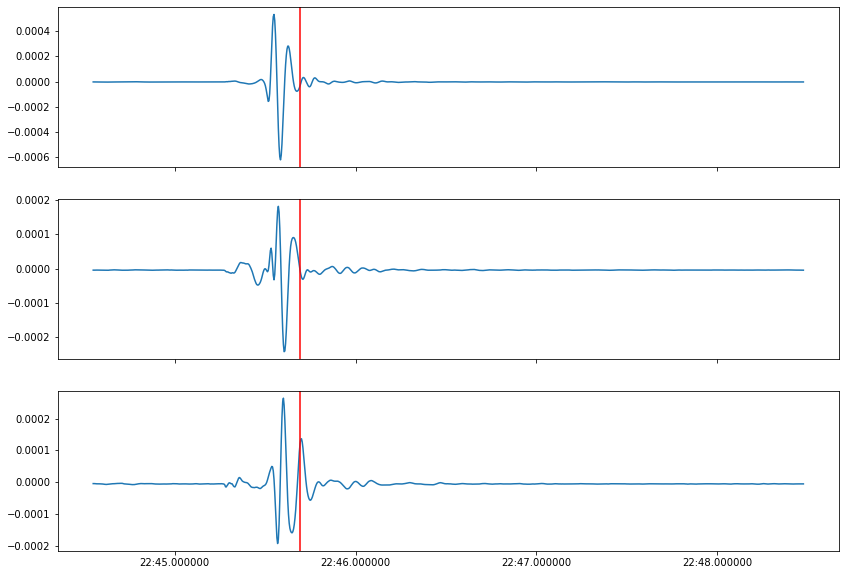

[UTCDateTime(2020, 3, 10, 3, 22, 45, 564742)]


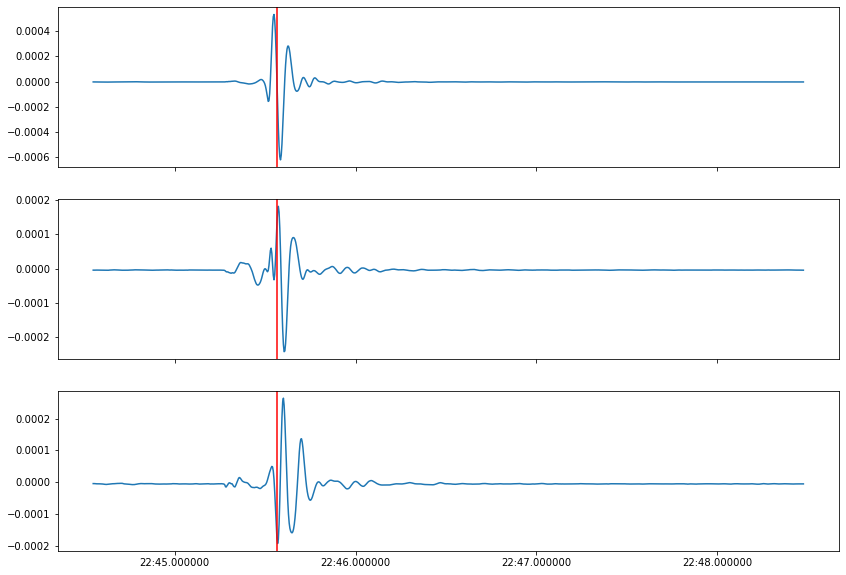

[UTCDateTime(2020, 3, 10, 3, 32, 35, 132778)]


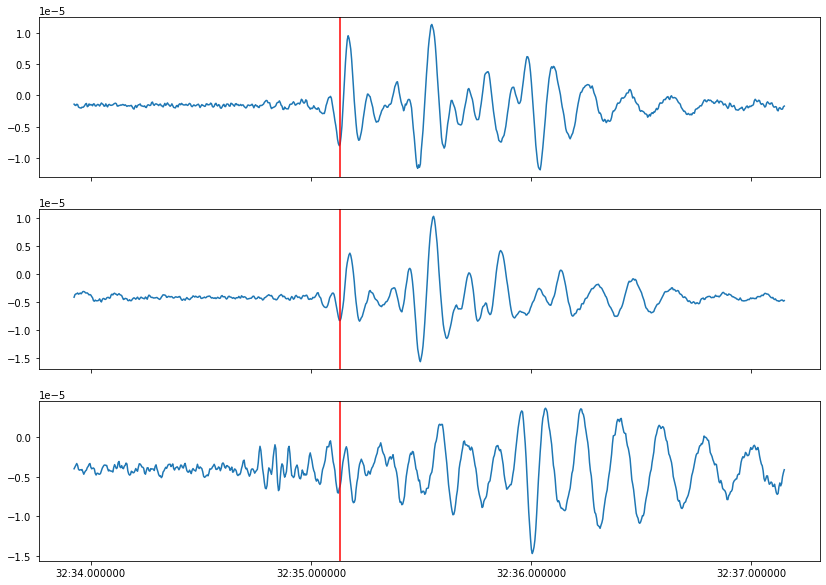

[UTCDateTime(2020, 3, 10, 3, 32, 34, 924778)]


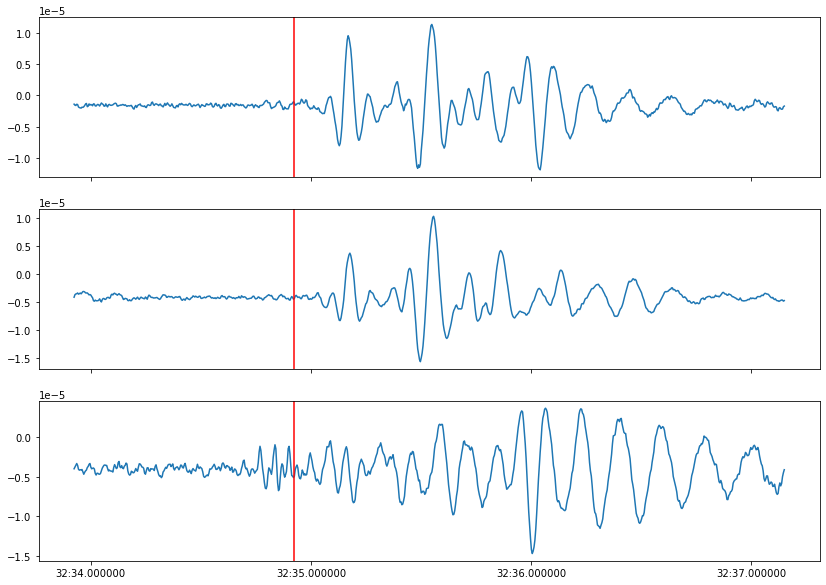

[UTCDateTime(2020, 3, 10, 3, 32, 35, 148778)]


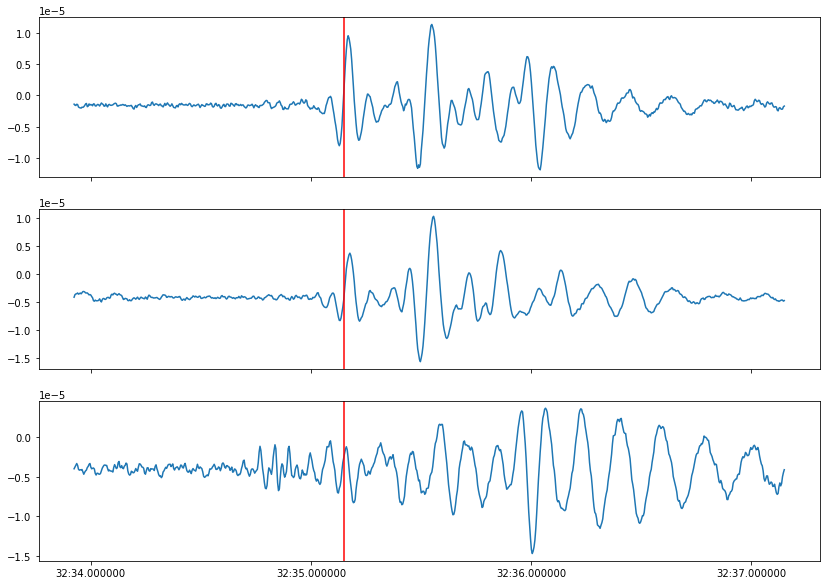

[UTCDateTime(2020, 3, 10, 3, 36, 44, 756793)]


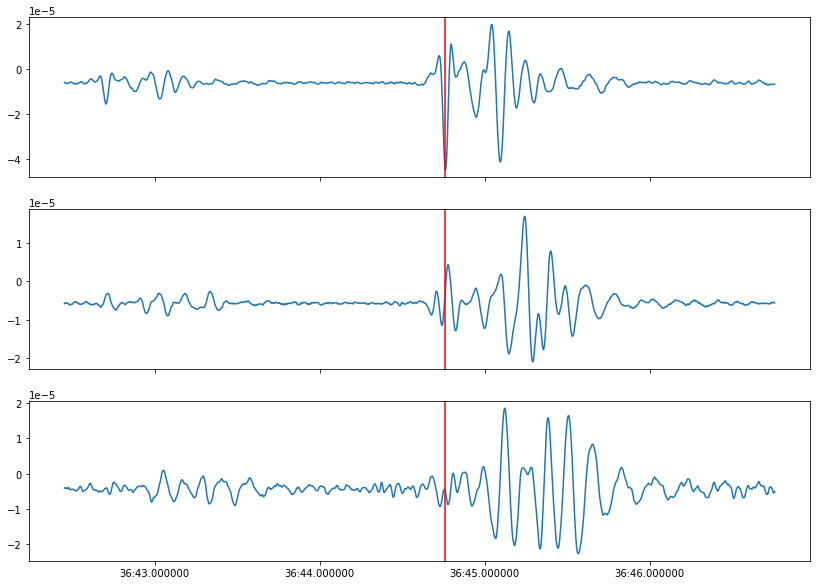

[UTCDateTime(2020, 3, 10, 3, 36, 43, 452793)]


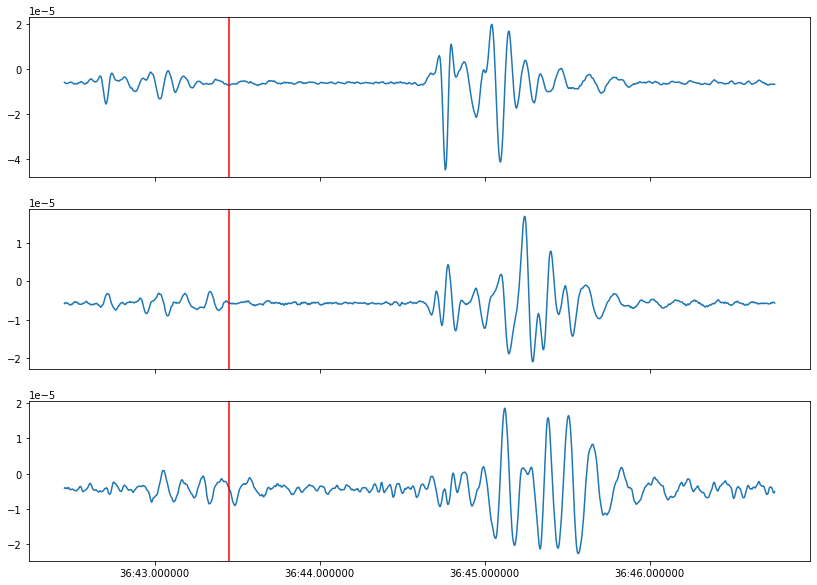

[UTCDateTime(2020, 3, 10, 3, 36, 44, 612793)]


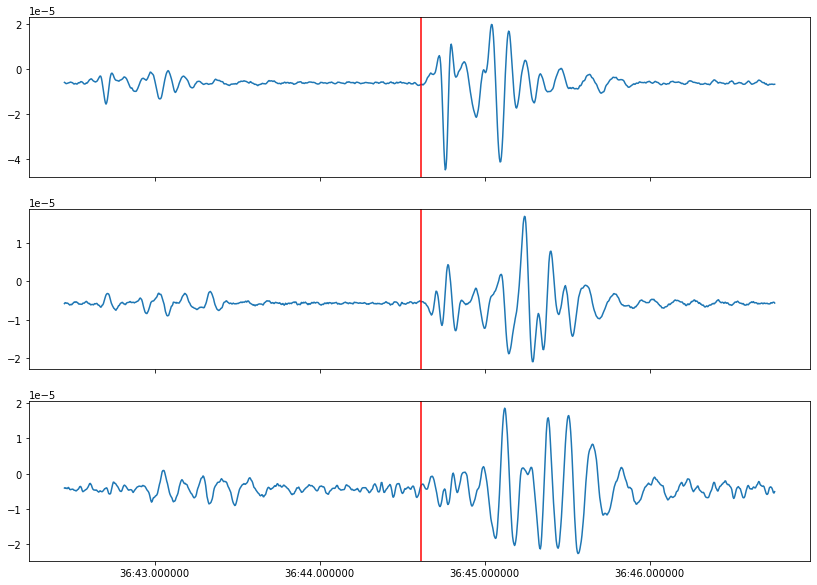

[UTCDateTime(2020, 3, 10, 3, 38, 59, 420800)]


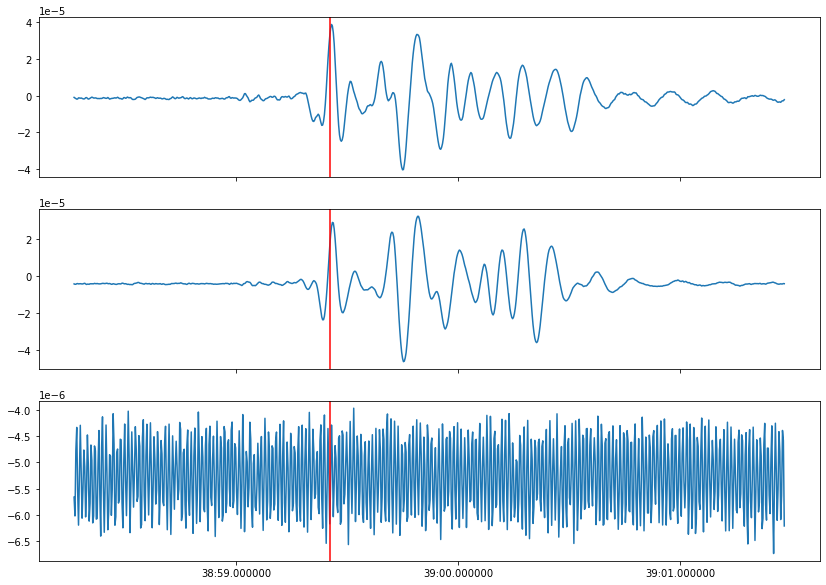

[UTCDateTime(2020, 3, 10, 3, 38, 59, 396800)]


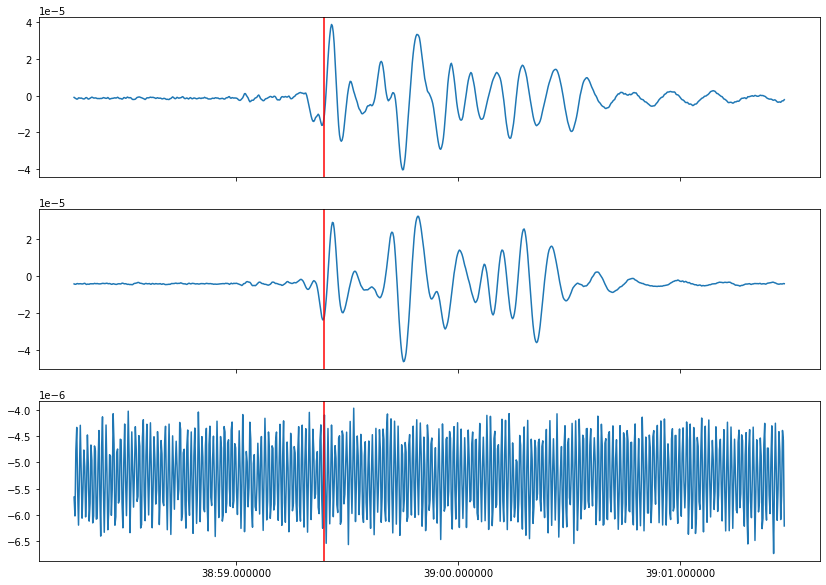

[UTCDateTime(2020, 3, 10, 3, 38, 59, 268800)]


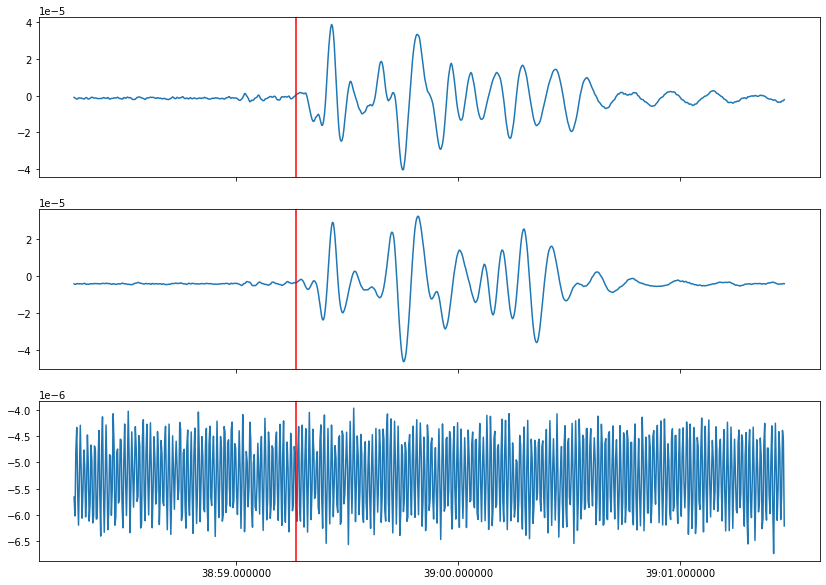

[UTCDateTime(2020, 3, 10, 3, 38, 59, 468801)]


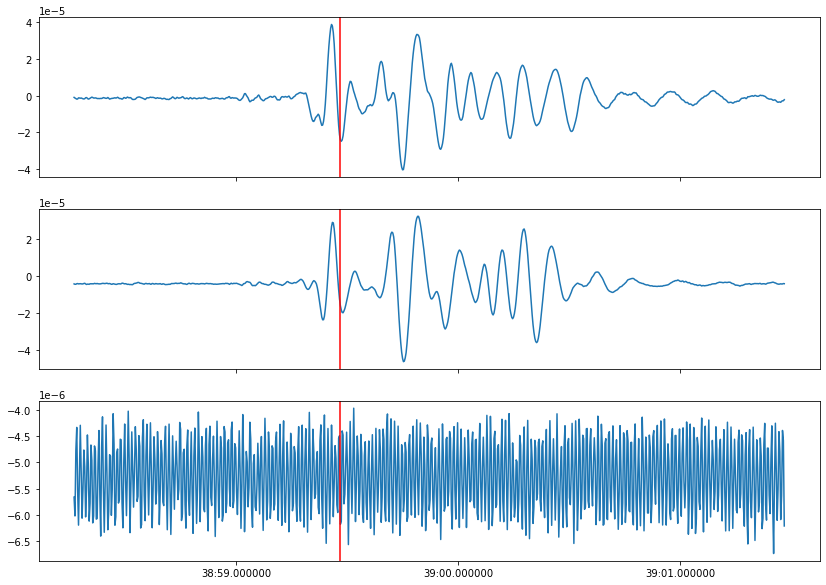

[UTCDateTime(2020, 3, 10, 3, 47, 47, 276834)]


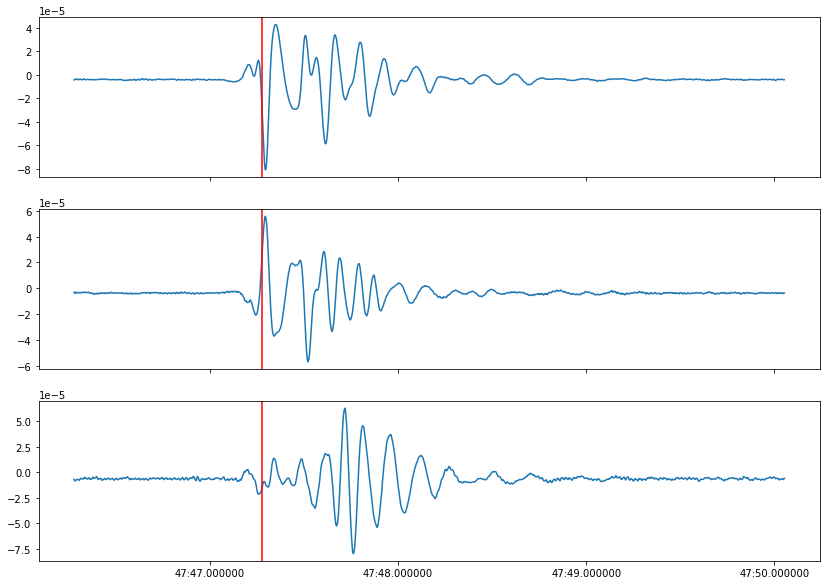

[UTCDateTime(2020, 3, 10, 3, 47, 47, 292833)]


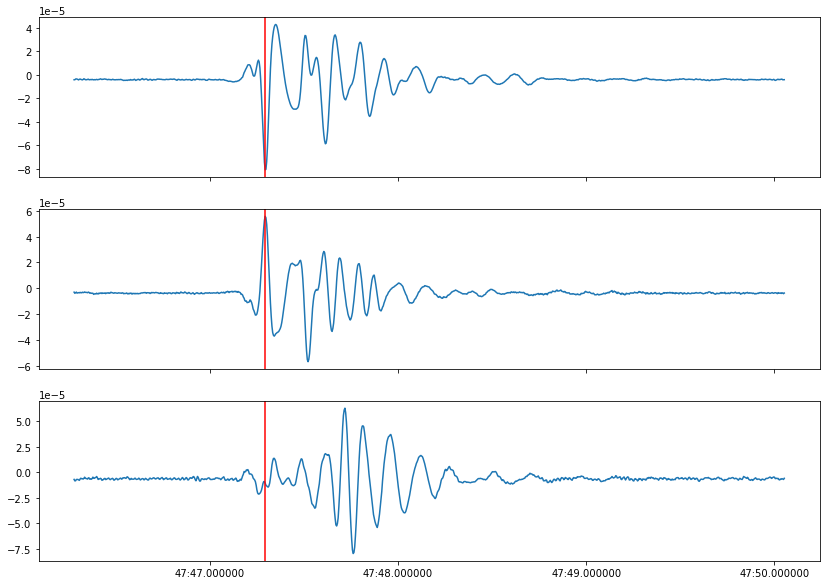

[UTCDateTime(2020, 3, 10, 3, 47, 48, 52834), UTCDateTime(2020, 3, 10, 3, 47, 48, 52834)]


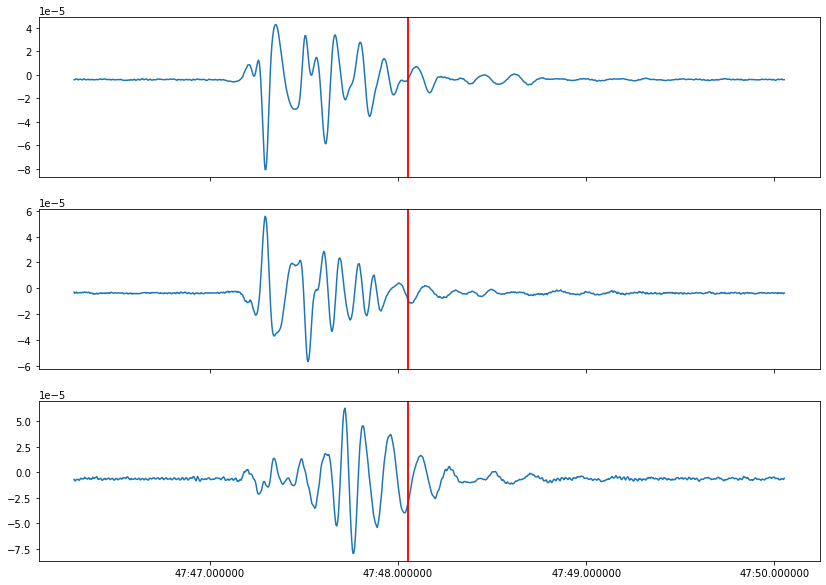

[UTCDateTime(2020, 3, 10, 3, 47, 47, 364833)]


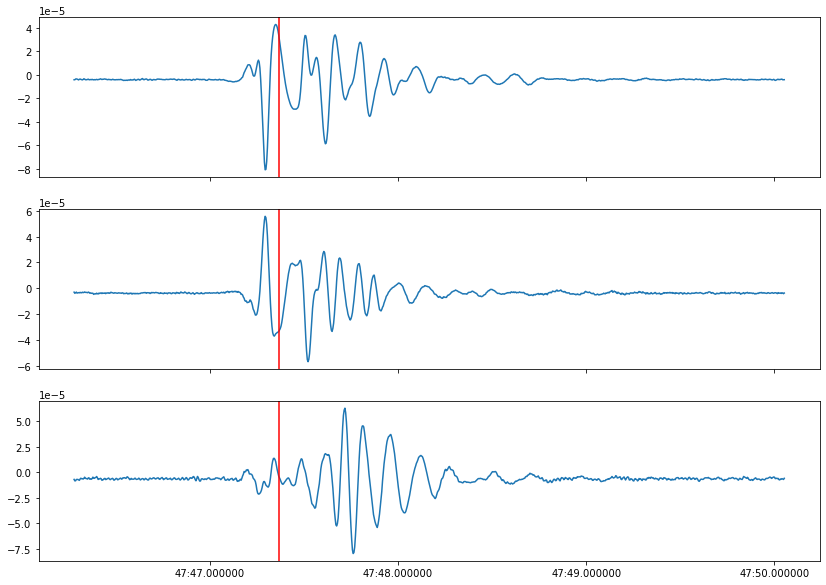

[UTCDateTime(2020, 3, 10, 3, 49, 6, 628838)]


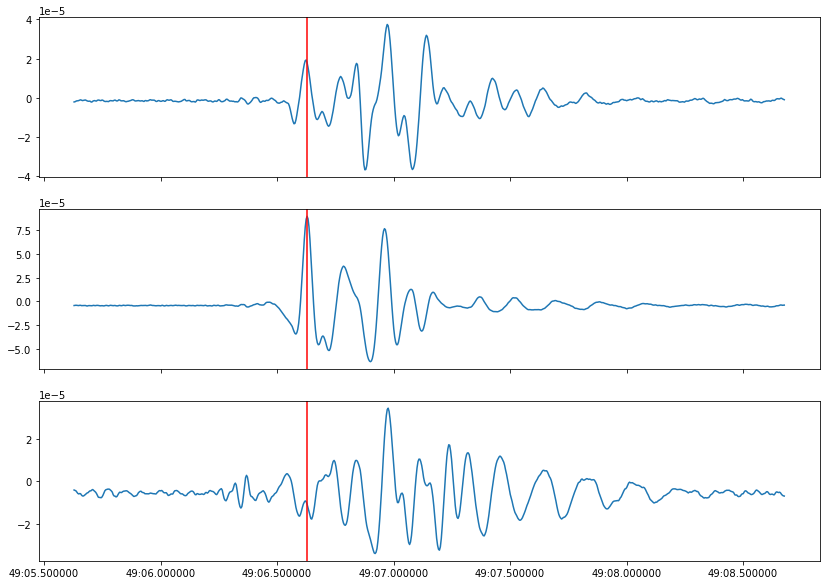

[UTCDateTime(2020, 3, 10, 3, 49, 6, 676838)]


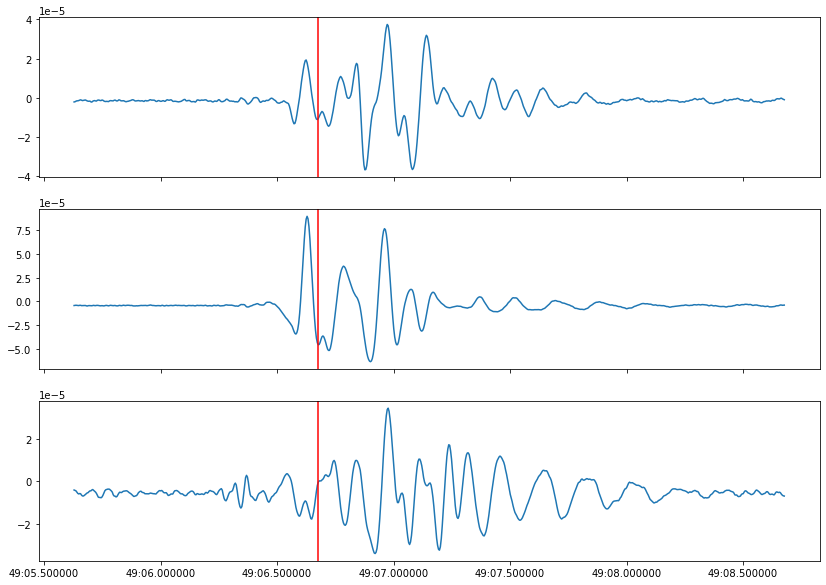

[UTCDateTime(2020, 3, 10, 3, 49, 6, 644838)]


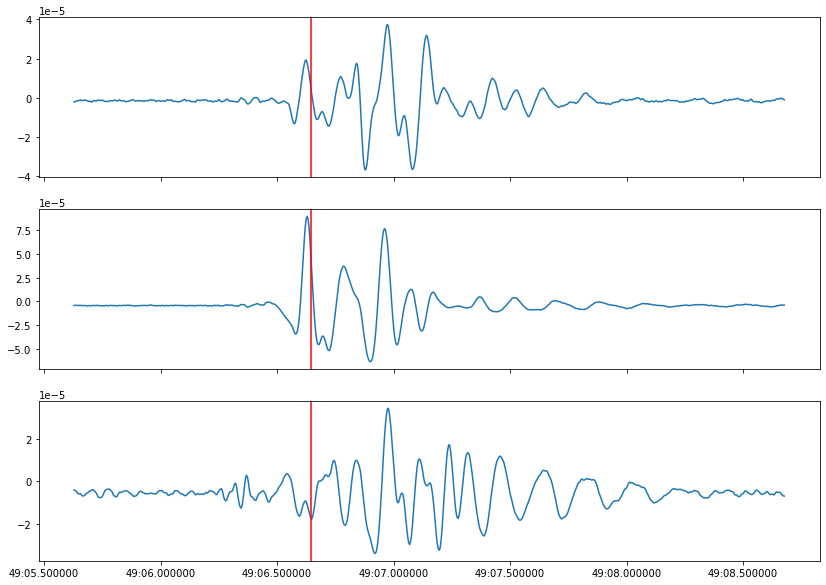

[UTCDateTime(2020, 3, 10, 3, 53, 11, 420852)]


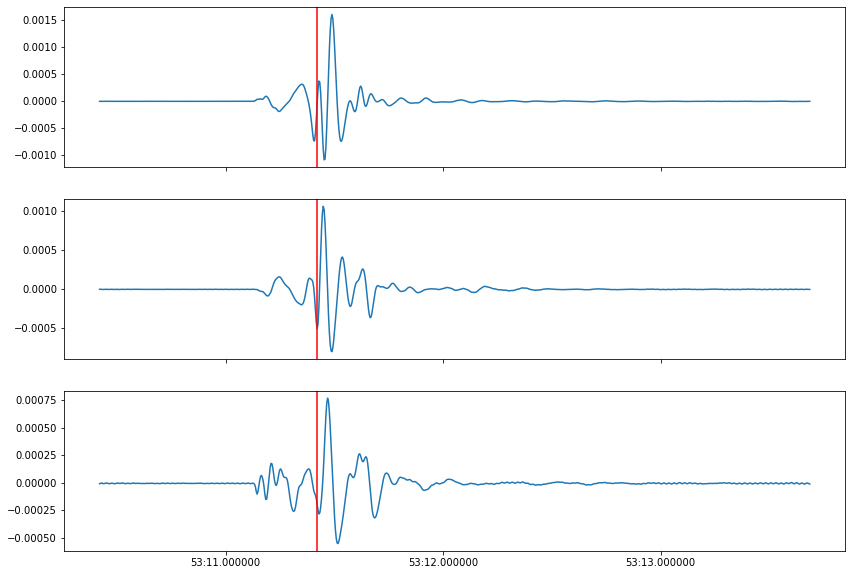

[UTCDateTime(2020, 3, 10, 3, 53, 11, 444852)]


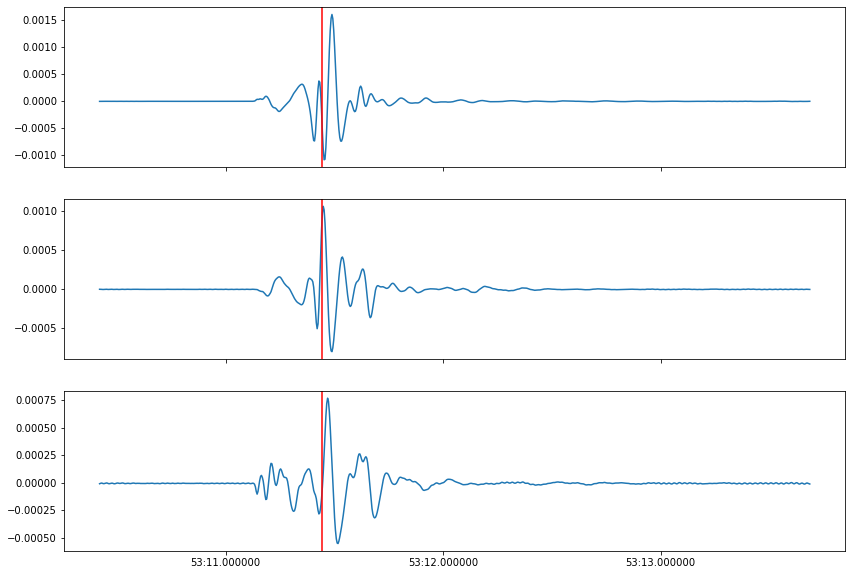

[UTCDateTime(2020, 3, 10, 3, 53, 11, 556853)]


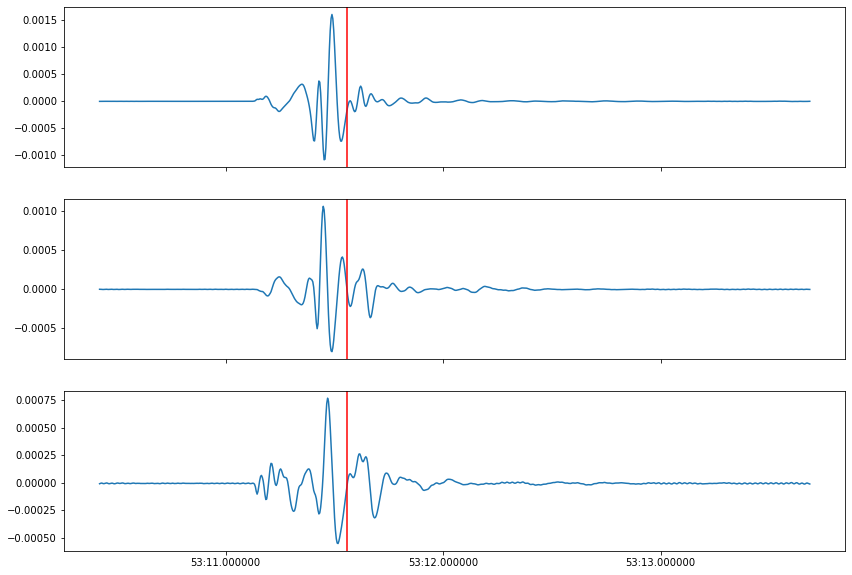

[UTCDateTime(2020, 3, 10, 3, 53, 11, 444852)]


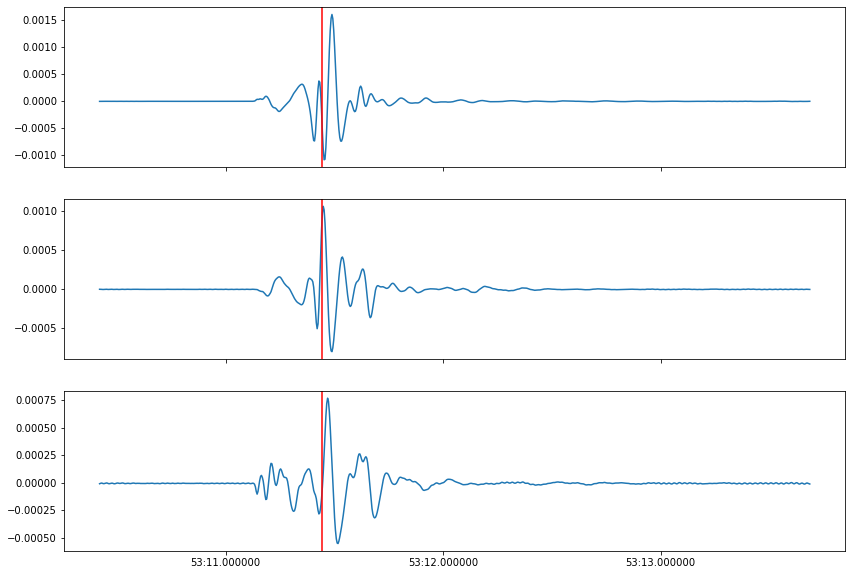

[UTCDateTime(2020, 3, 10, 3, 53, 11, 684852)]


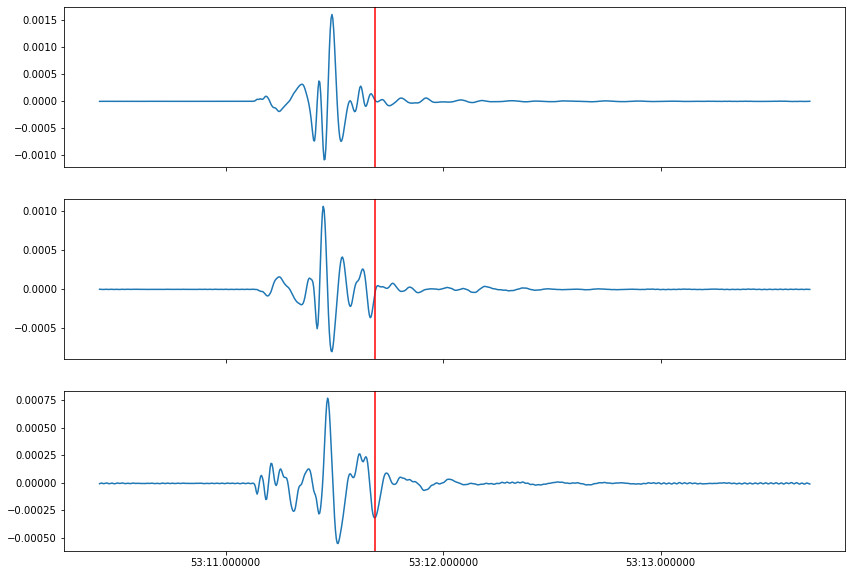

[UTCDateTime(2020, 3, 10, 3, 55, 16, 996861)]


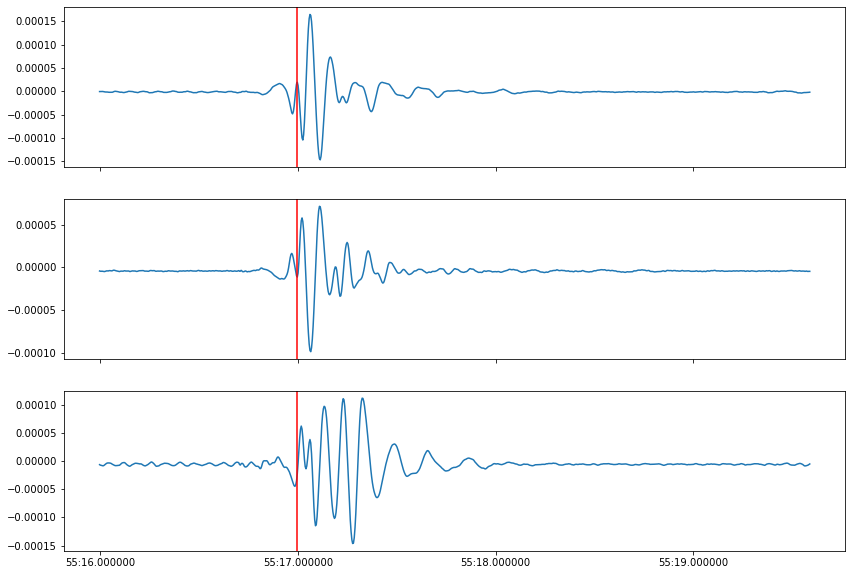

[UTCDateTime(2020, 3, 10, 3, 55, 17, 76860)]


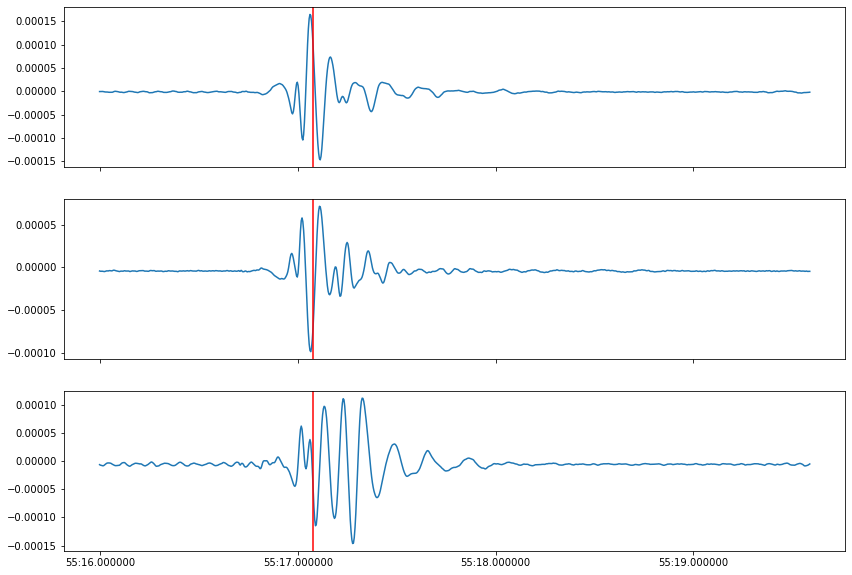

[UTCDateTime(2020, 3, 10, 3, 55, 17, 588860), UTCDateTime(2020, 3, 10, 3, 55, 17, 588860)]


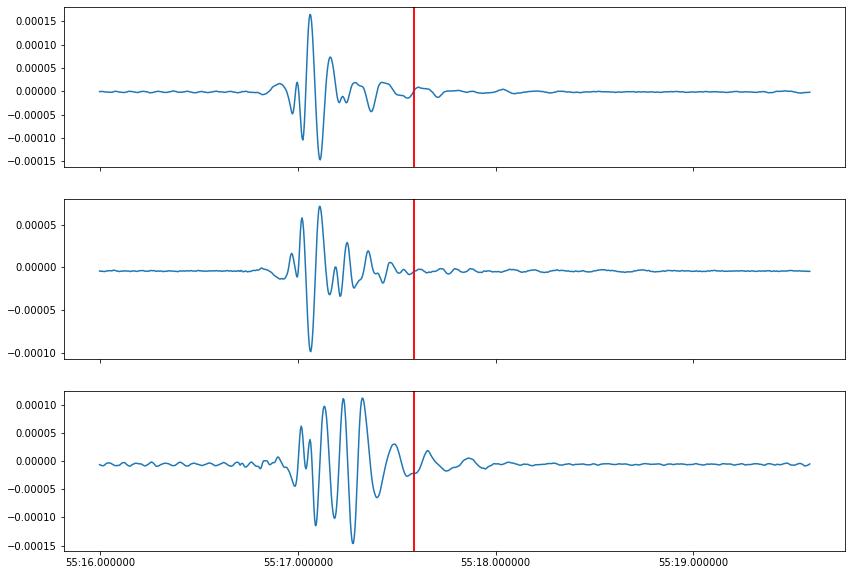

[UTCDateTime(2020, 3, 10, 3, 55, 17, 92862), UTCDateTime(2020, 3, 10, 3, 55, 17, 92862)]


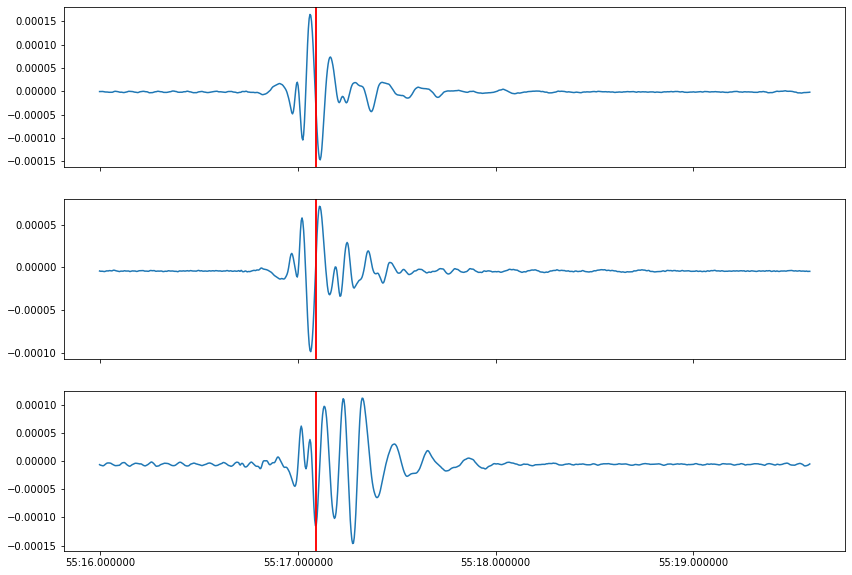

[UTCDateTime(2020, 3, 10, 3, 55, 17, 44862)]


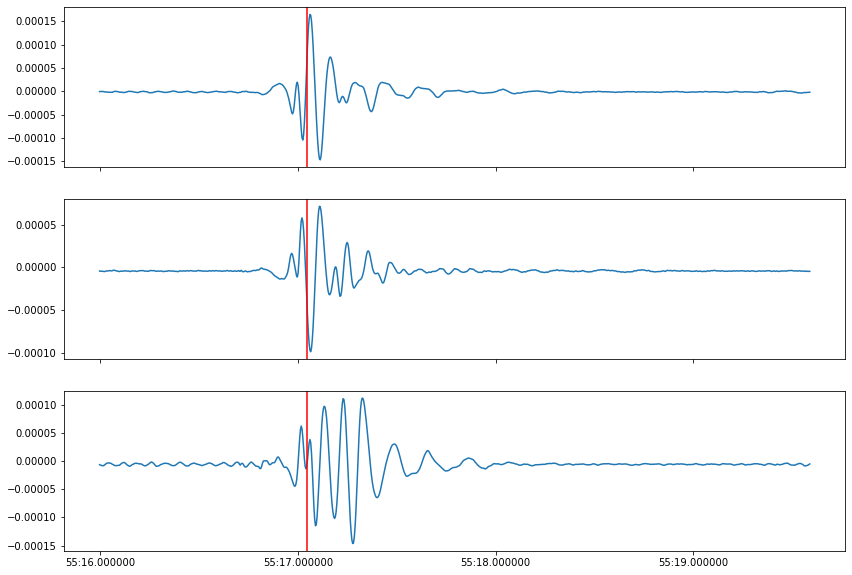

[UTCDateTime(2020, 3, 10, 3, 56, 38, 468866)]


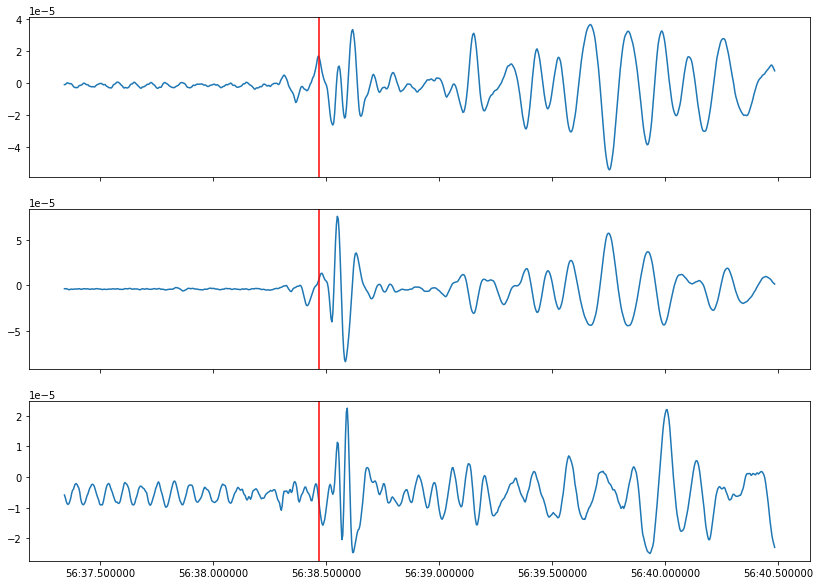

[UTCDateTime(2020, 3, 10, 3, 56, 38, 484866)]


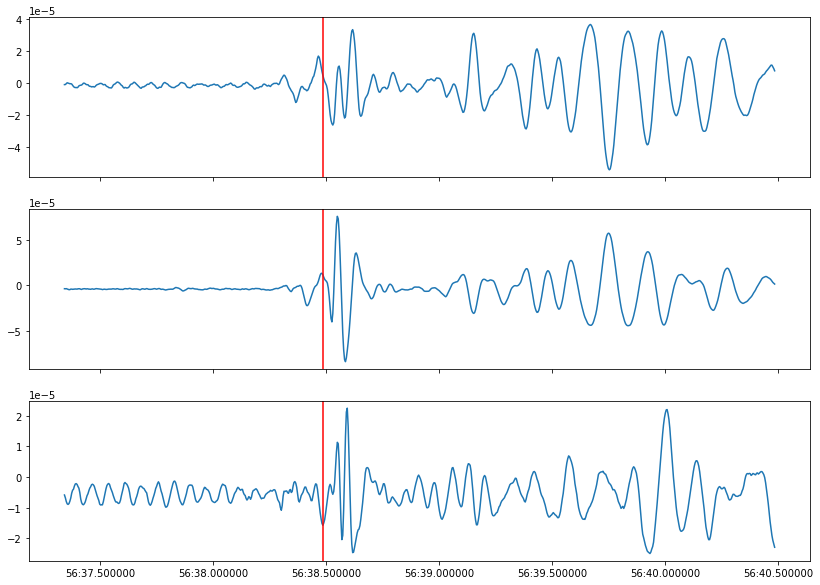

[UTCDateTime(2020, 3, 10, 3, 56, 38, 340866)]


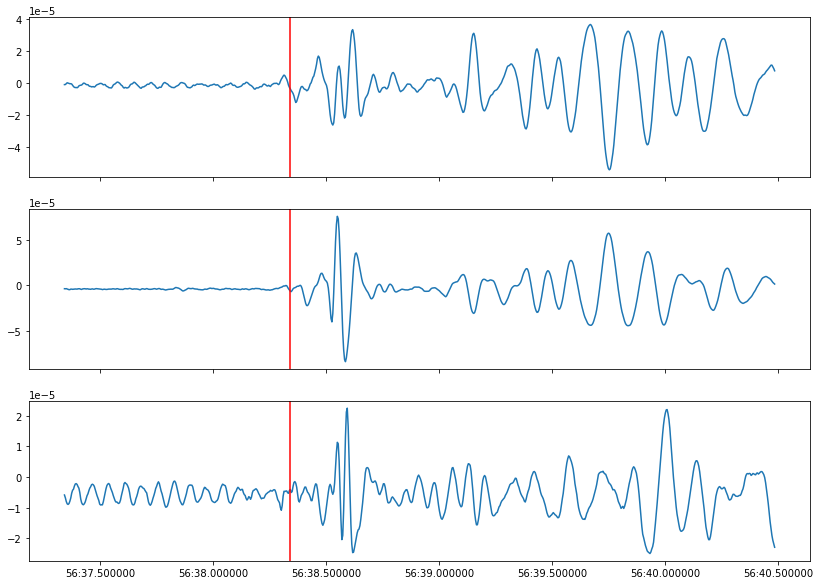

[UTCDateTime(2020, 3, 10, 3, 56, 38, 468866)]


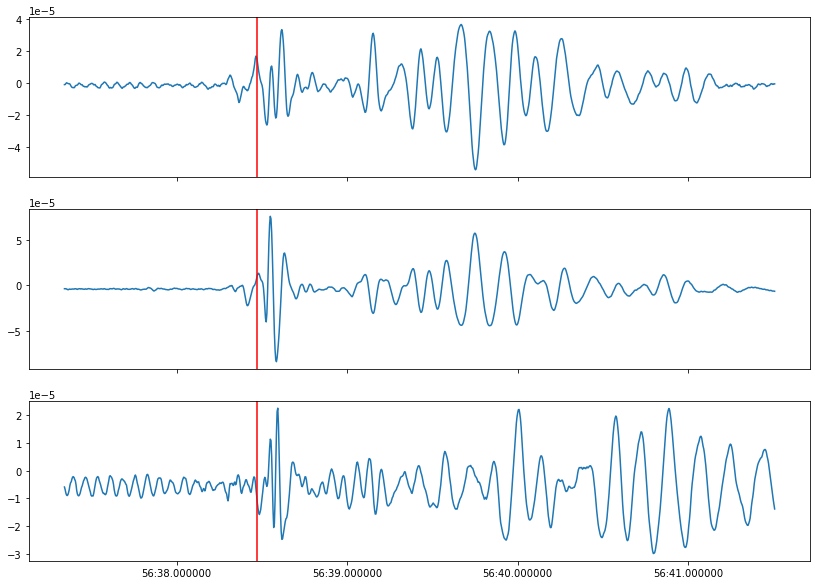

[UTCDateTime(2020, 3, 10, 3, 56, 38, 484866)]


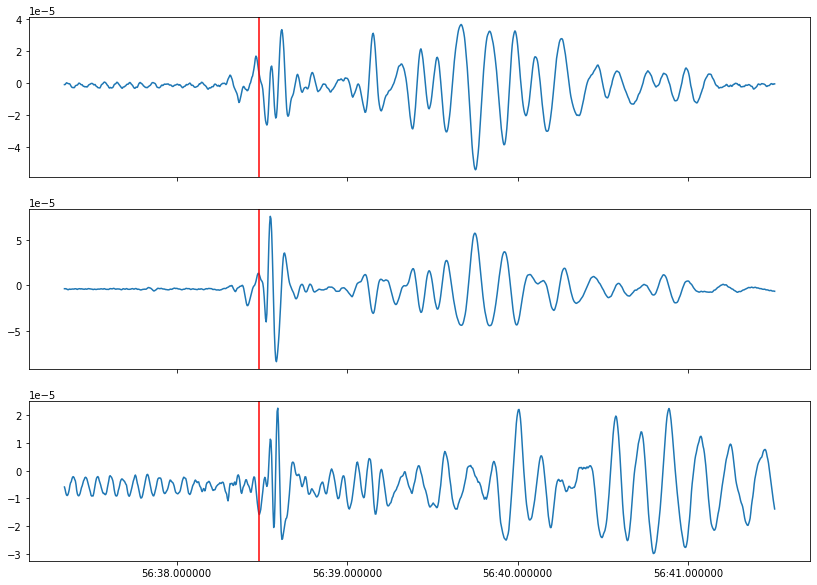

[UTCDateTime(2020, 3, 10, 3, 56, 39, 508866)]


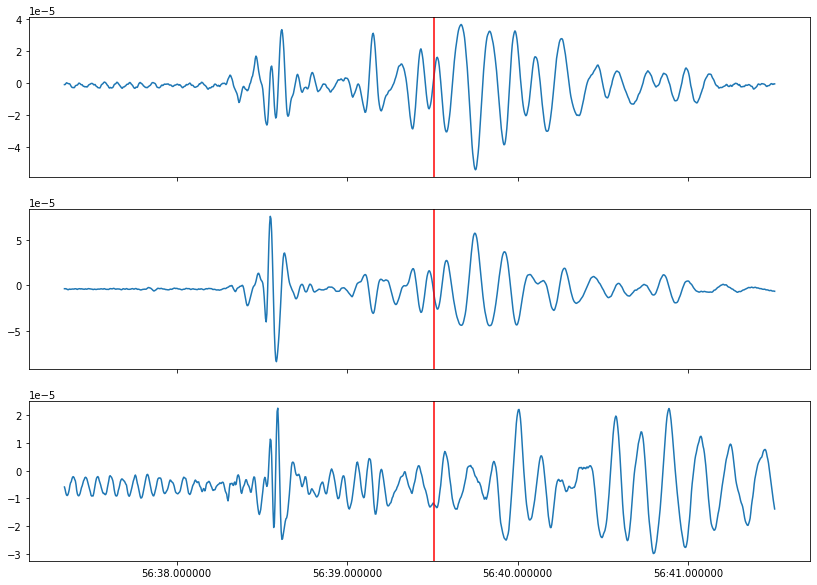

[UTCDateTime(2020, 3, 10, 3, 56, 38, 340866)]


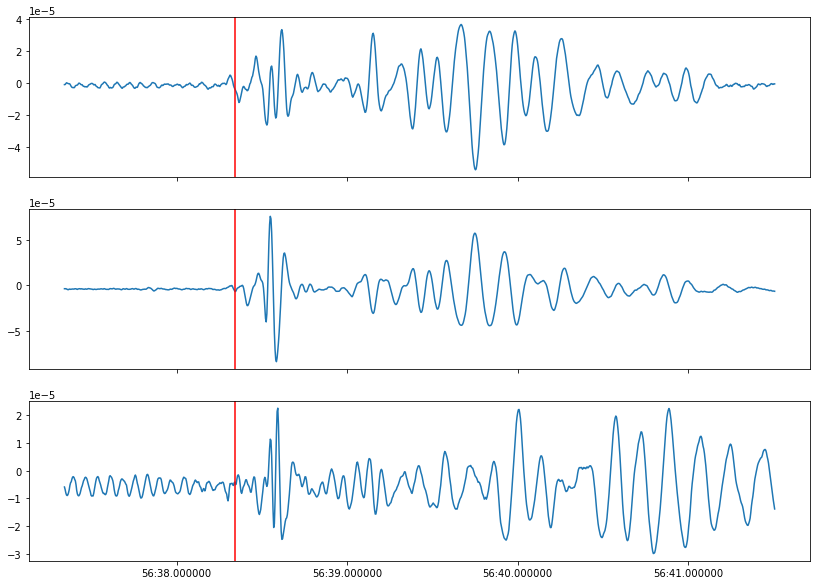

[UTCDateTime(2020, 3, 10, 3, 56, 39, 300865), UTCDateTime(2020, 3, 10, 3, 56, 39, 300865)]


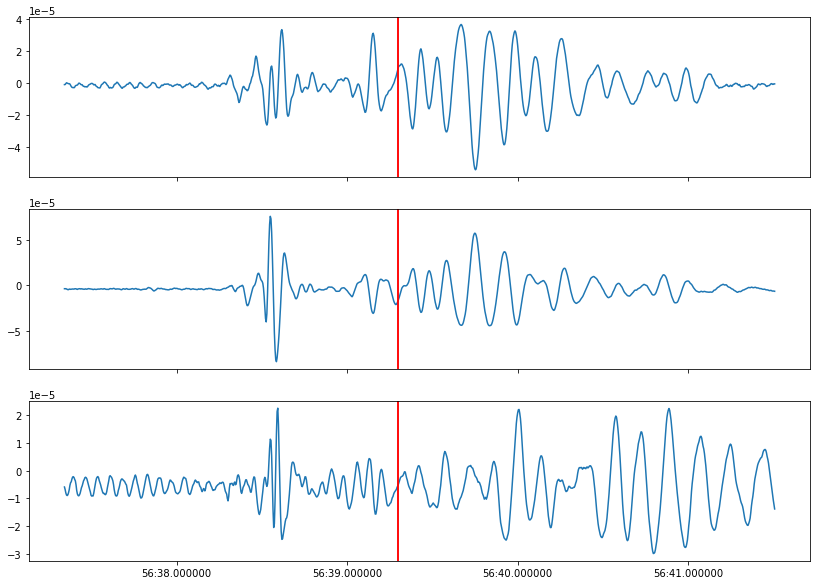

[UTCDateTime(2020, 3, 10, 3, 58, 44, 396873)]


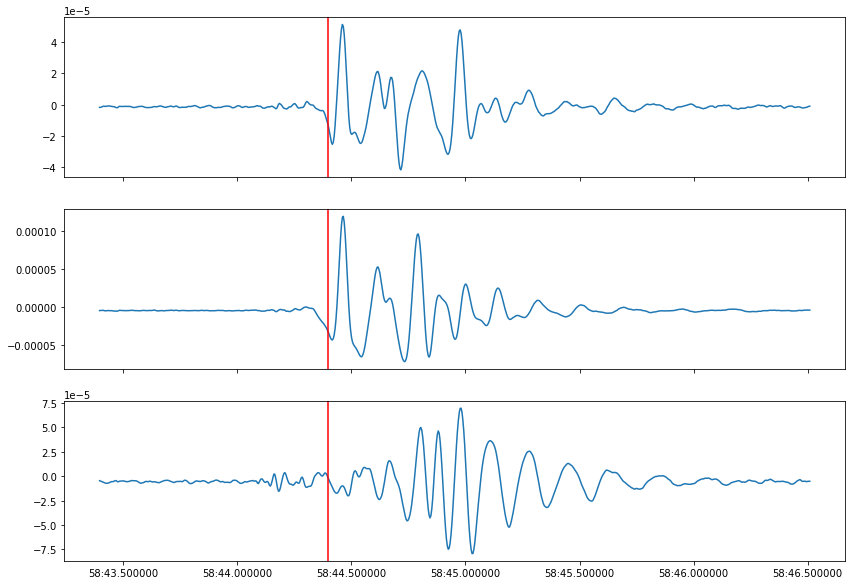

[UTCDateTime(2020, 3, 10, 3, 58, 44, 460873)]


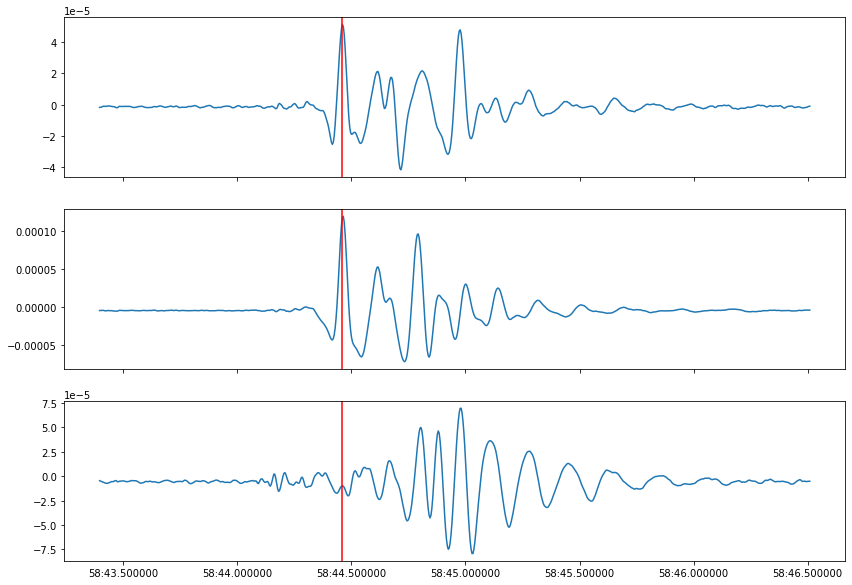

[UTCDateTime(2020, 3, 10, 3, 58, 44, 508873)]


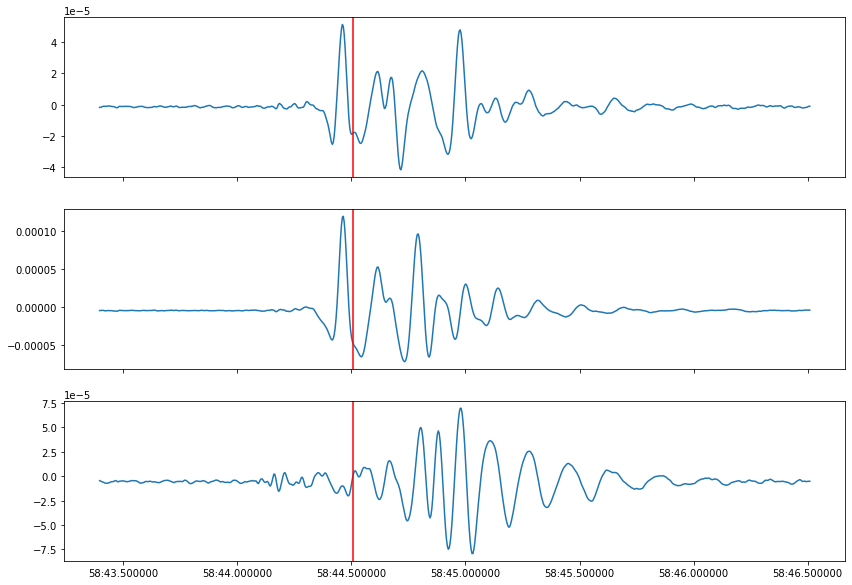

[UTCDateTime(2020, 3, 10, 3, 58, 44, 428873)]


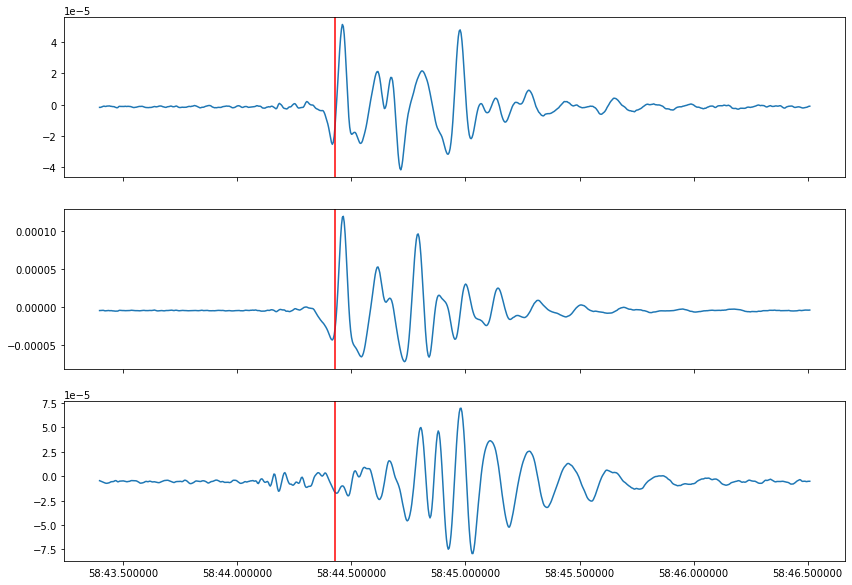

[UTCDateTime(2020, 3, 10, 4, 0, 8, 852878)]


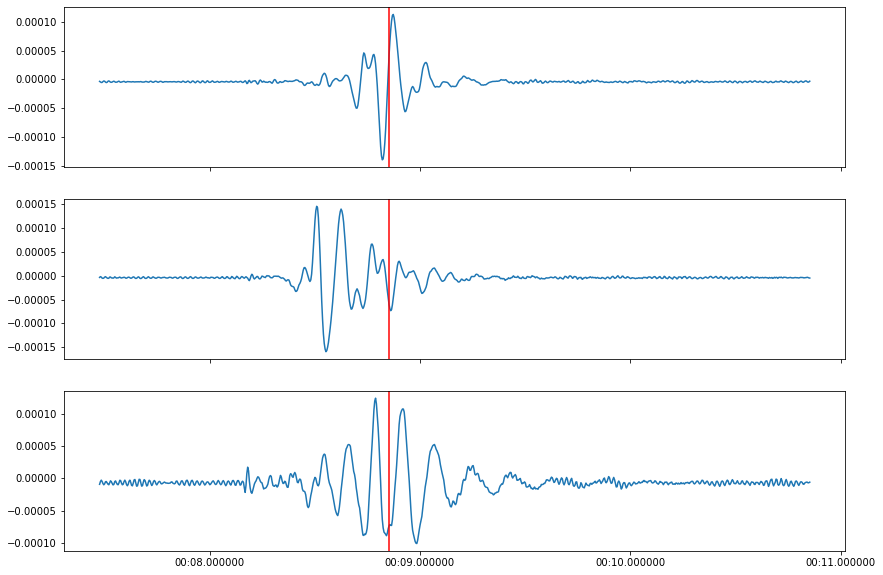

[UTCDateTime(2020, 3, 10, 4, 0, 8, 524879)]


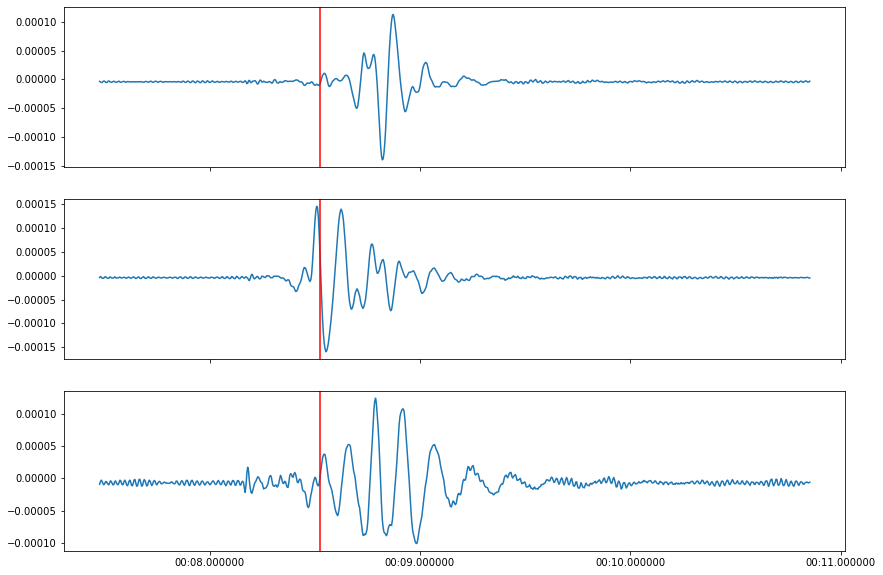

[UTCDateTime(2020, 3, 10, 4, 0, 8, 476878)]


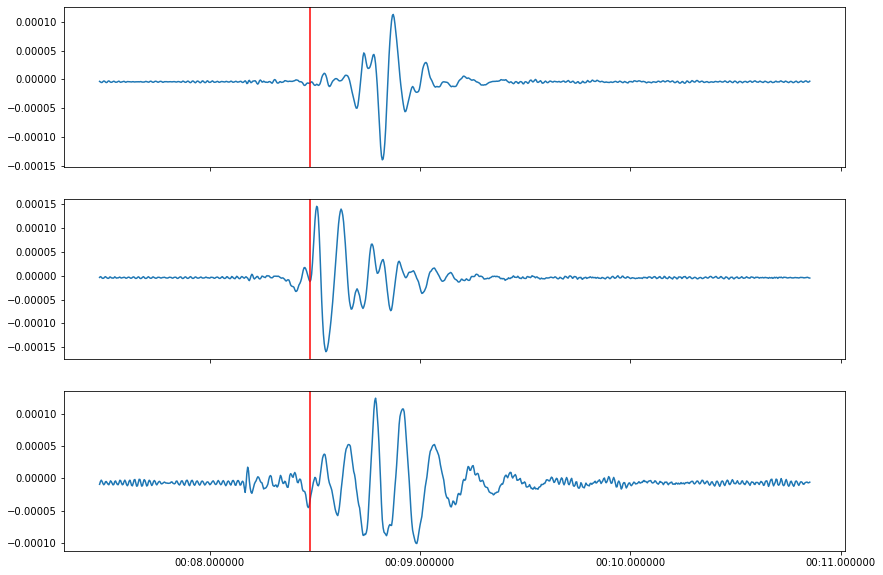

[UTCDateTime(2020, 3, 10, 4, 0, 8, 612878)]


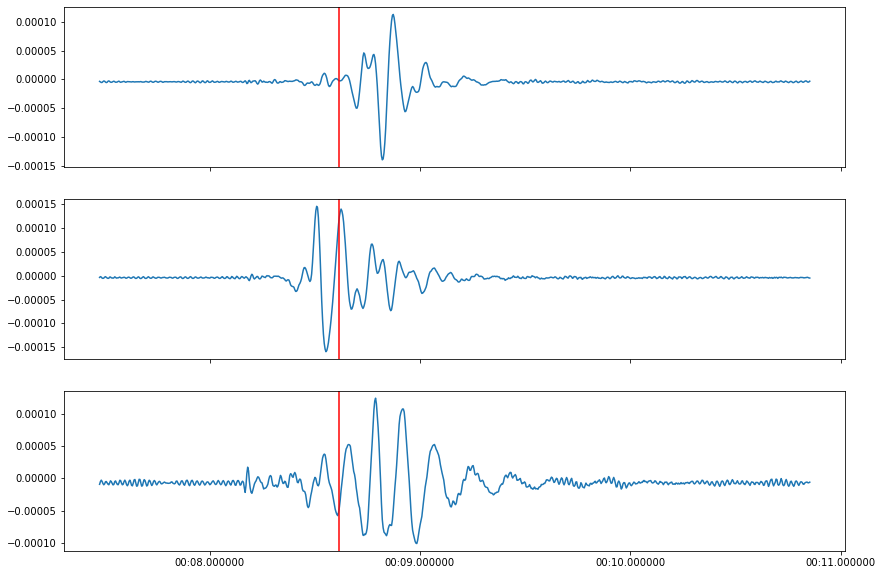

[UTCDateTime(2020, 3, 10, 4, 3, 8, 276890)]


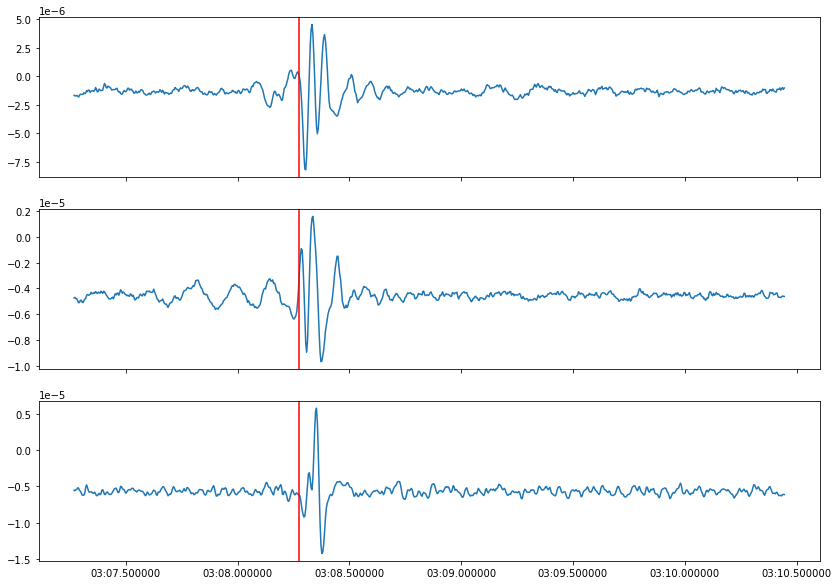

[UTCDateTime(2020, 3, 10, 4, 3, 8, 444890)]


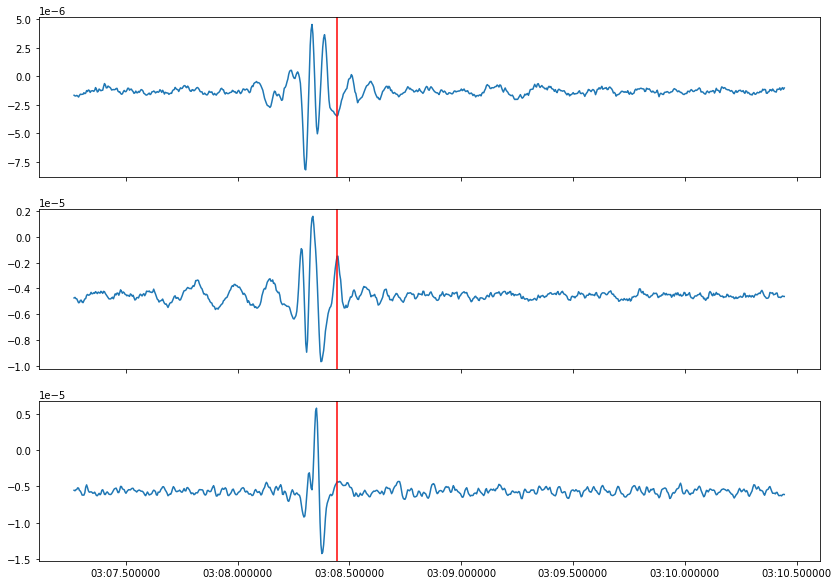

[UTCDateTime(2020, 3, 10, 4, 3, 8, 268890)]


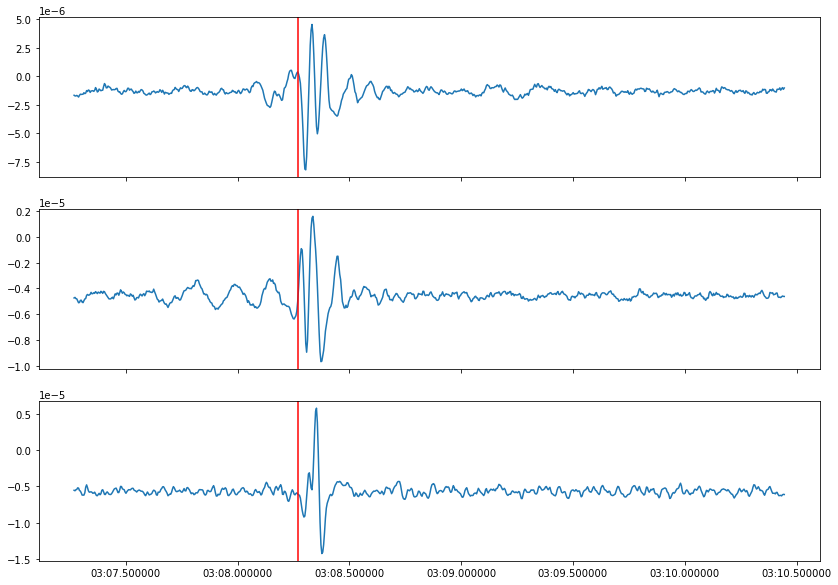

[UTCDateTime(2020, 3, 10, 4, 3, 24, 972890)]


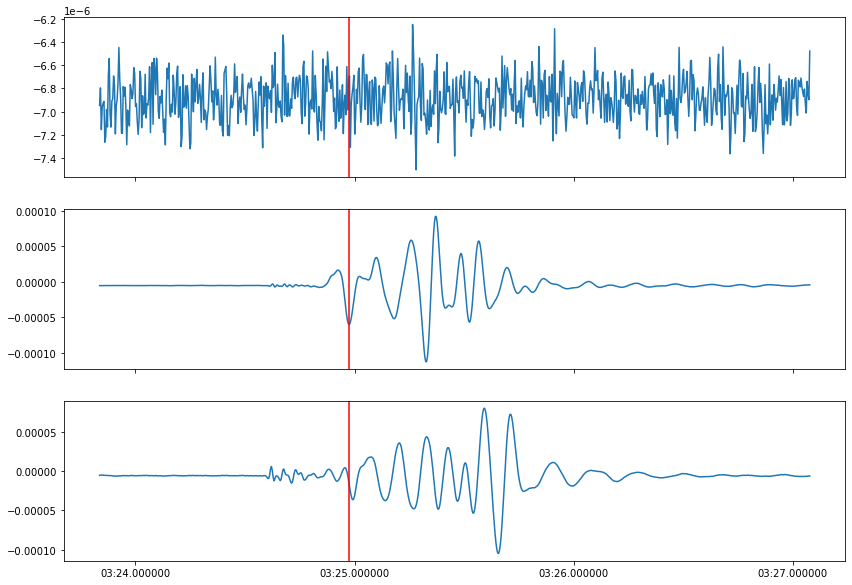

[UTCDateTime(2020, 3, 10, 4, 3, 25, 76890)]


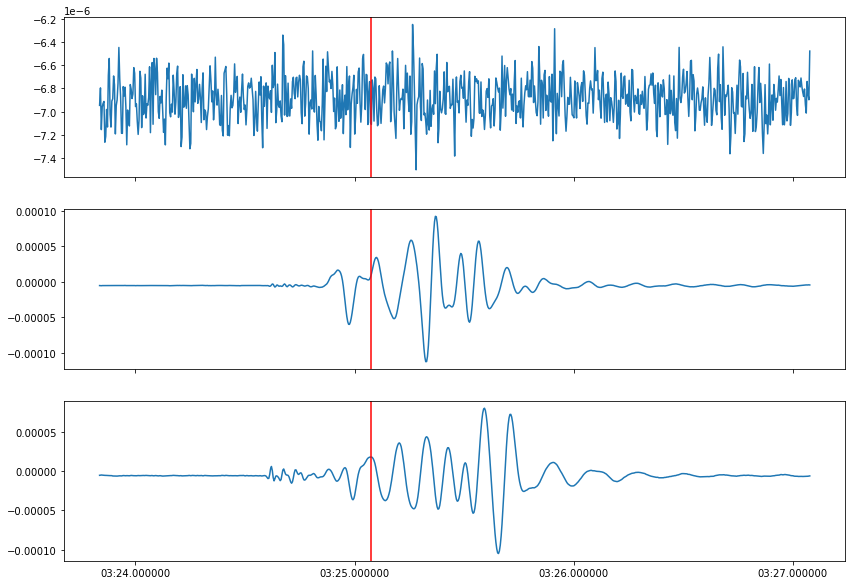

[UTCDateTime(2020, 3, 10, 4, 3, 25, 68890)]


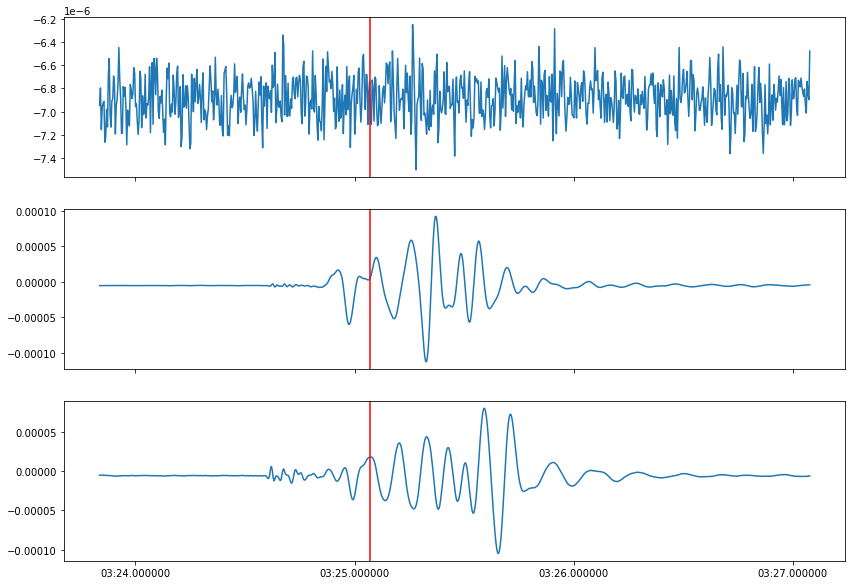

[UTCDateTime(2020, 3, 10, 4, 3, 24, 836890)]


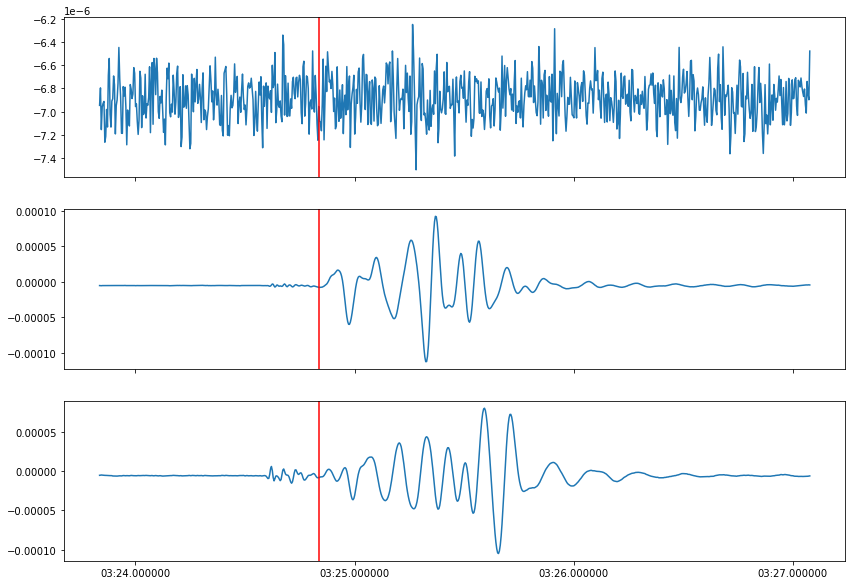

[UTCDateTime(2020, 3, 10, 4, 3, 24, 972890)]


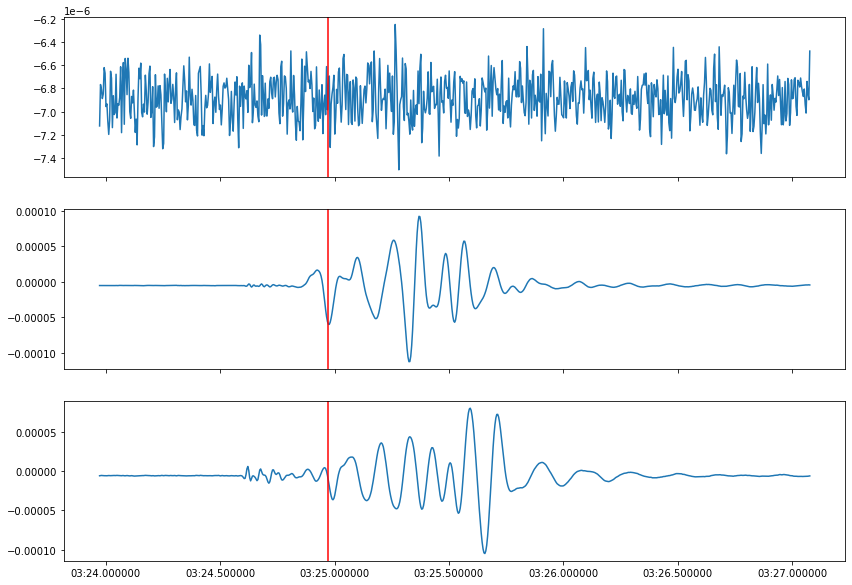

[UTCDateTime(2020, 3, 10, 4, 3, 25, 76890)]


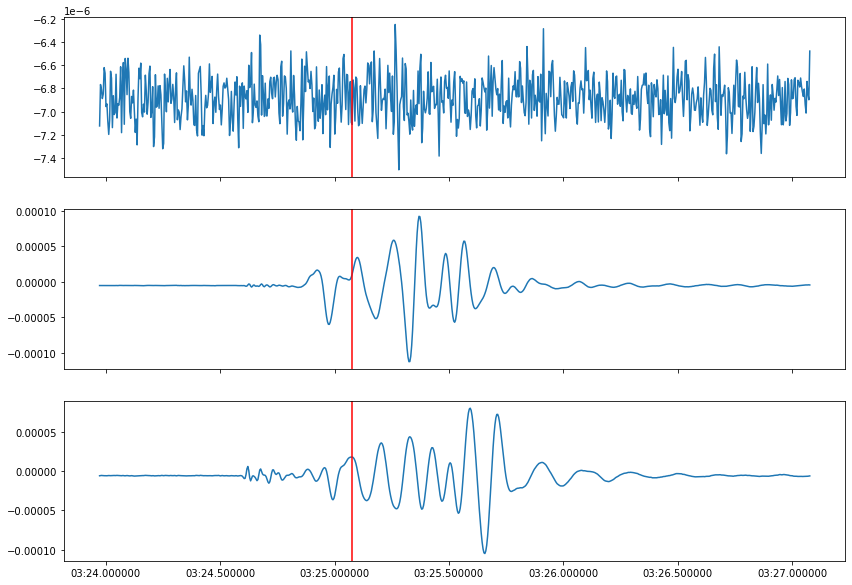

[UTCDateTime(2020, 3, 10, 4, 3, 25, 68890)]


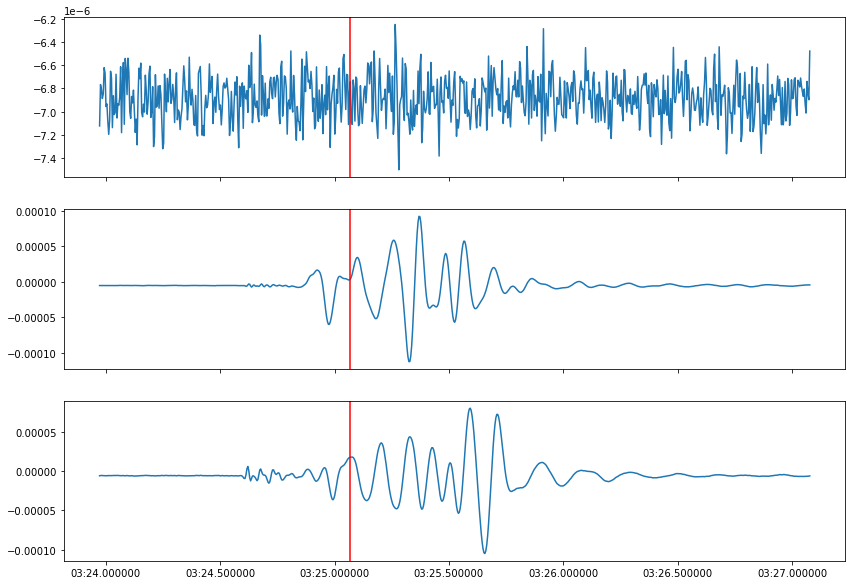

[UTCDateTime(2020, 3, 10, 4, 10, 16, 652915)]


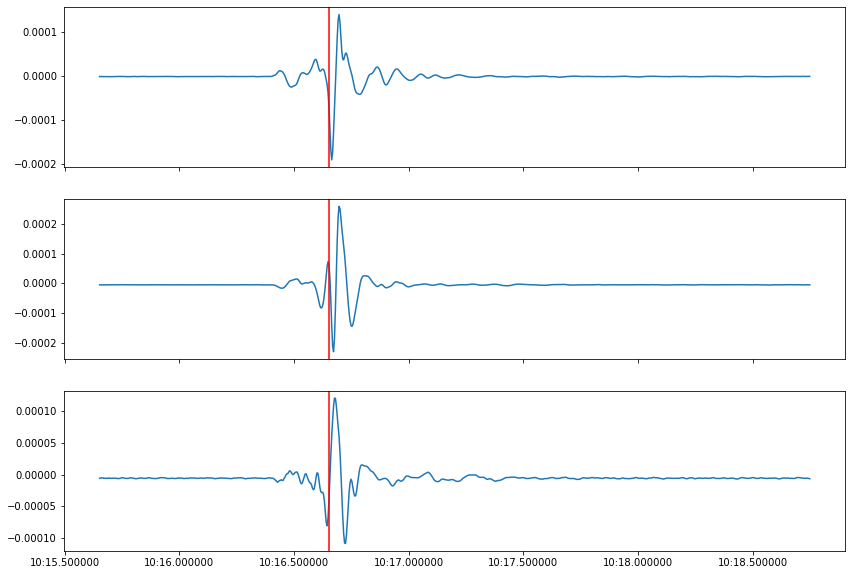

[UTCDateTime(2020, 3, 10, 4, 10, 16, 708915)]


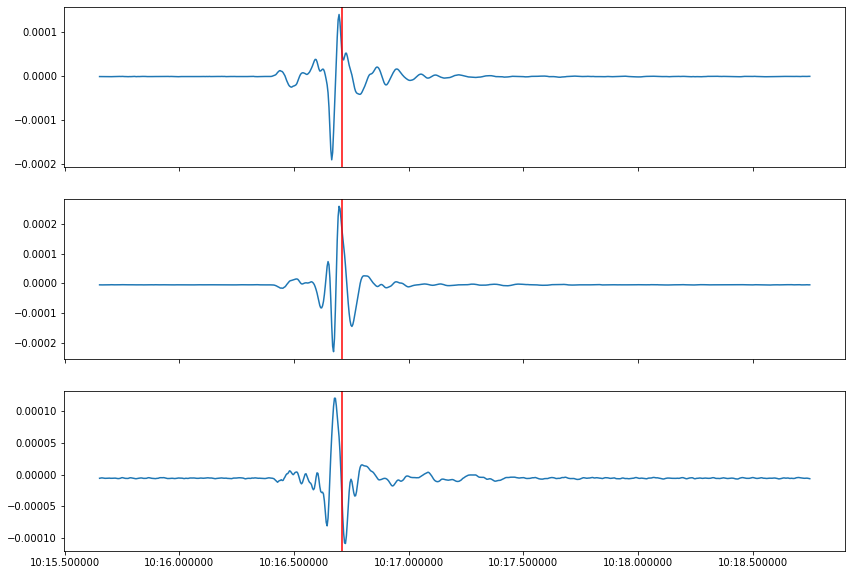

[UTCDateTime(2020, 3, 10, 4, 10, 16, 748915)]


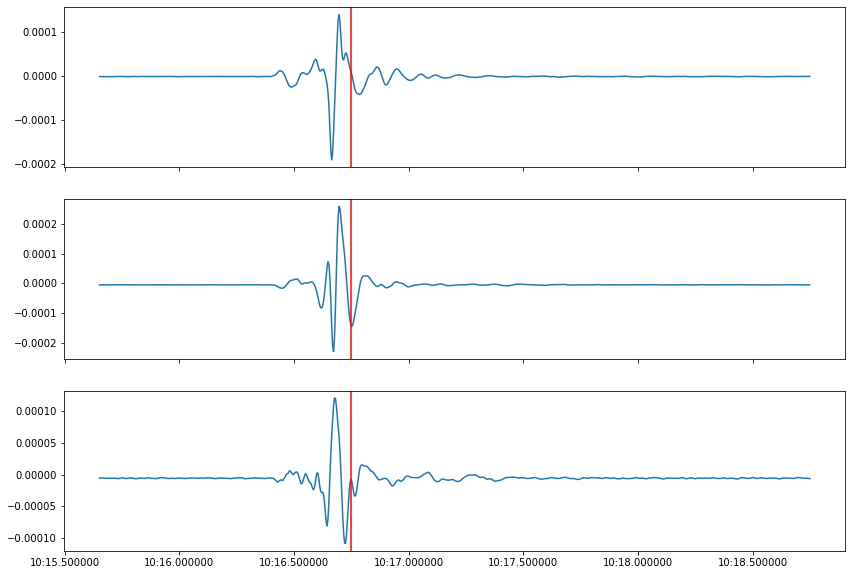

[UTCDateTime(2020, 3, 10, 4, 10, 16, 652915)]


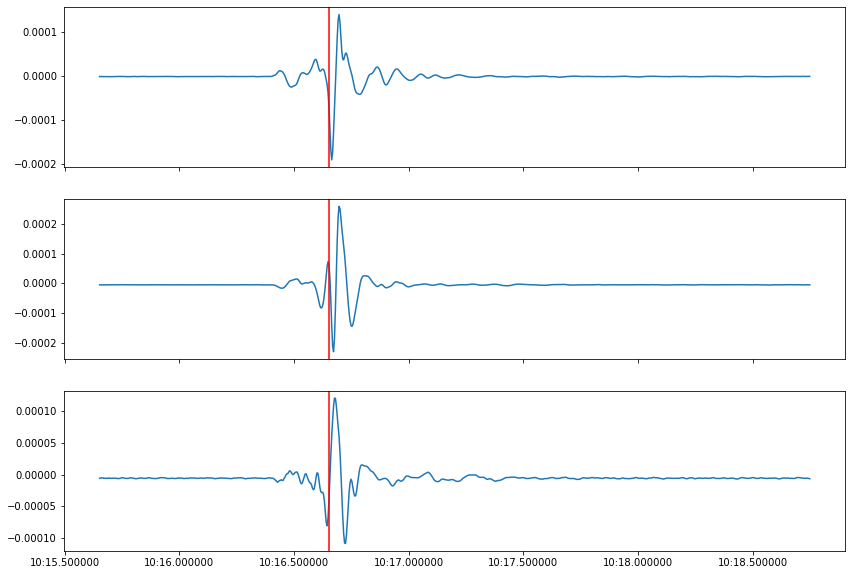

[UTCDateTime(2020, 3, 10, 4, 13, 18, 948928)]


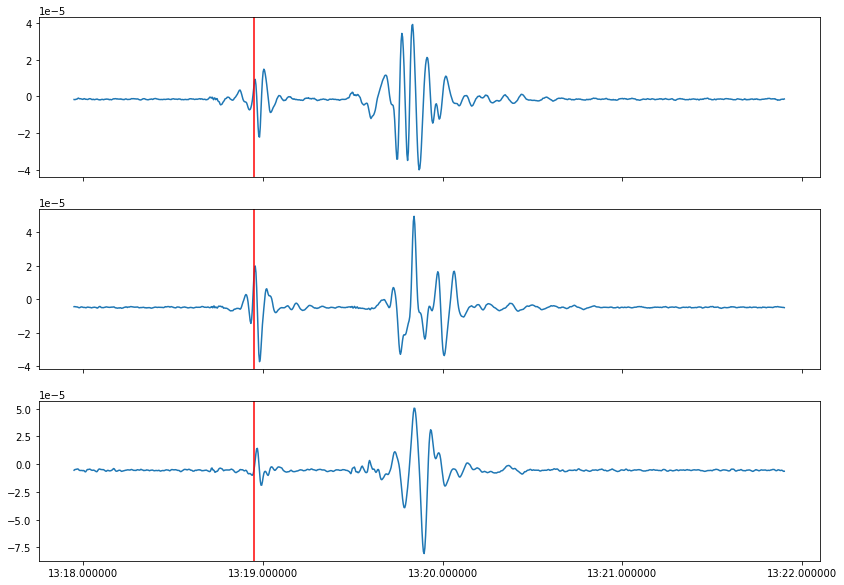

[UTCDateTime(2020, 3, 10, 4, 13, 19, 804927)]


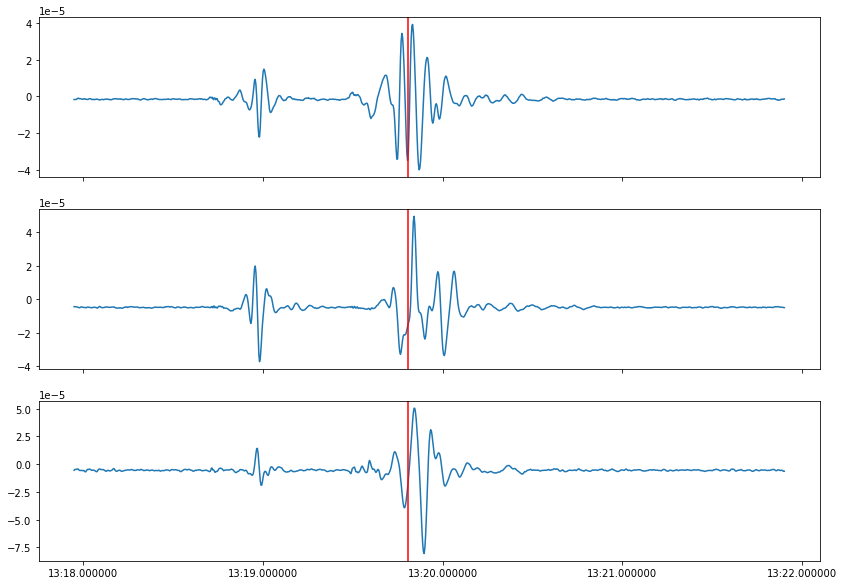

[UTCDateTime(2020, 3, 10, 4, 13, 18, 996928)]


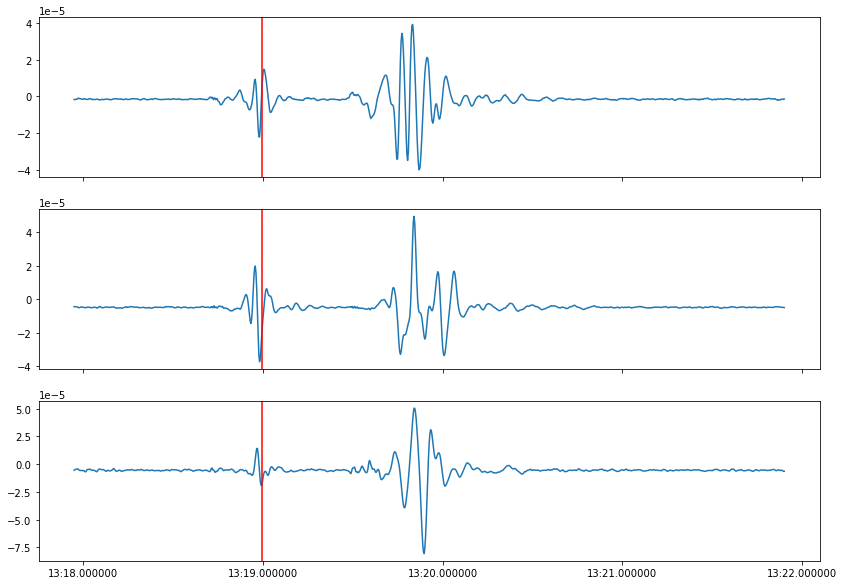

[UTCDateTime(2020, 3, 10, 4, 13, 19, 900928)]


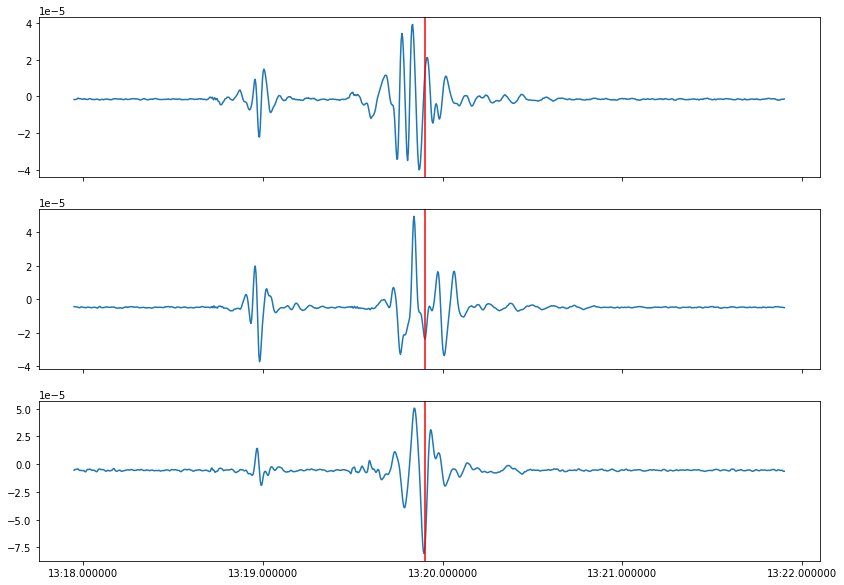

[UTCDateTime(2020, 3, 10, 4, 13, 18, 972928)]


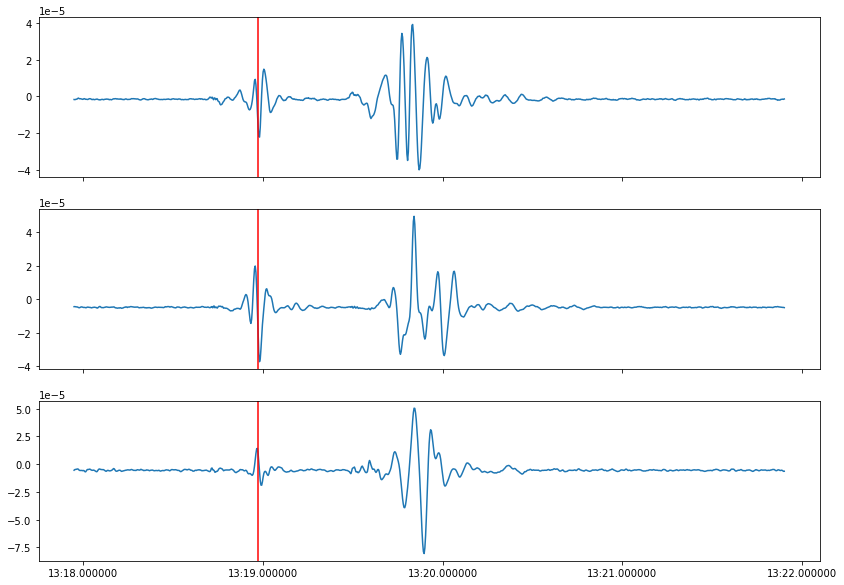

[UTCDateTime(2020, 3, 10, 4, 13, 19, 572928)]


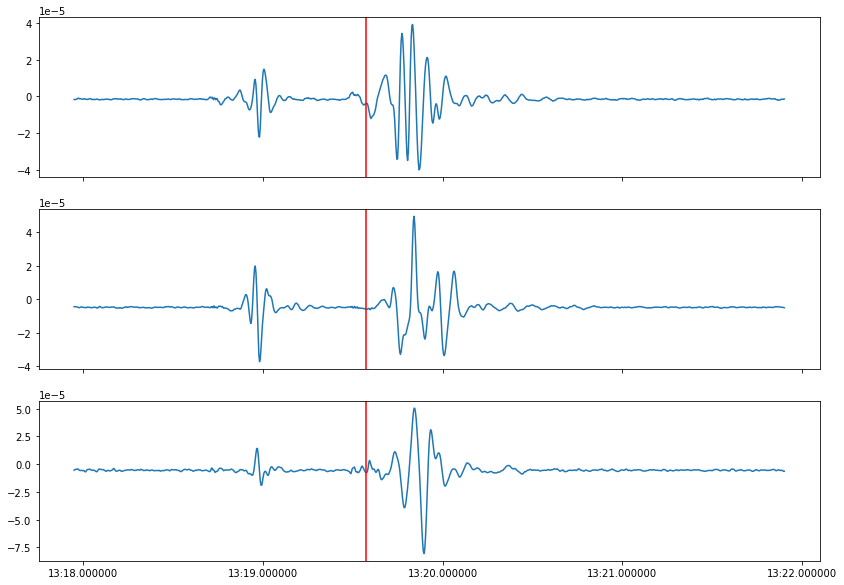

[UTCDateTime(2020, 3, 10, 4, 20, 18, 140952)]


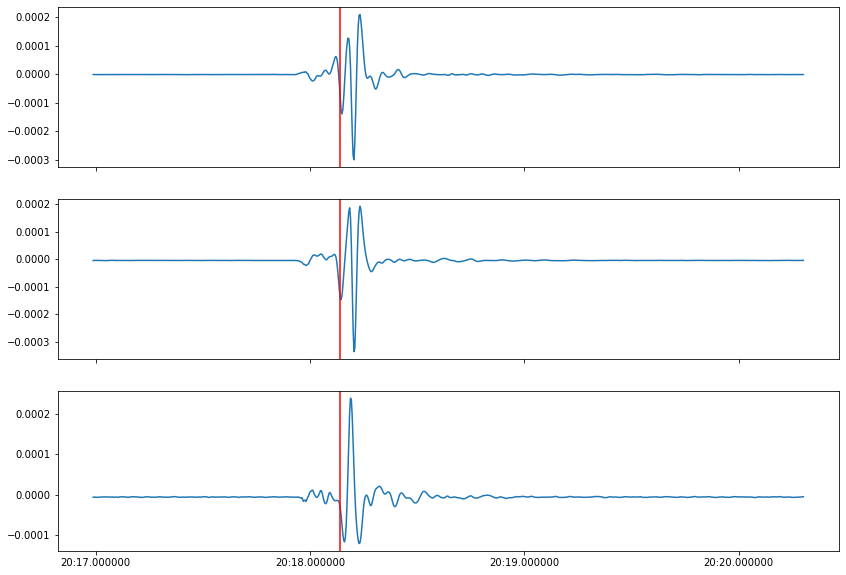

[UTCDateTime(2020, 3, 10, 4, 20, 18, 300952)]


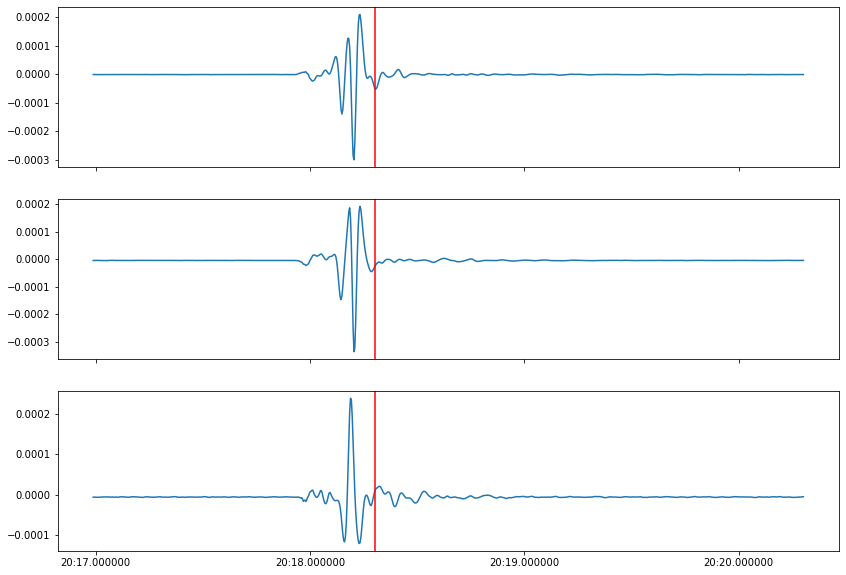

[UTCDateTime(2020, 3, 10, 4, 20, 17, 988952)]


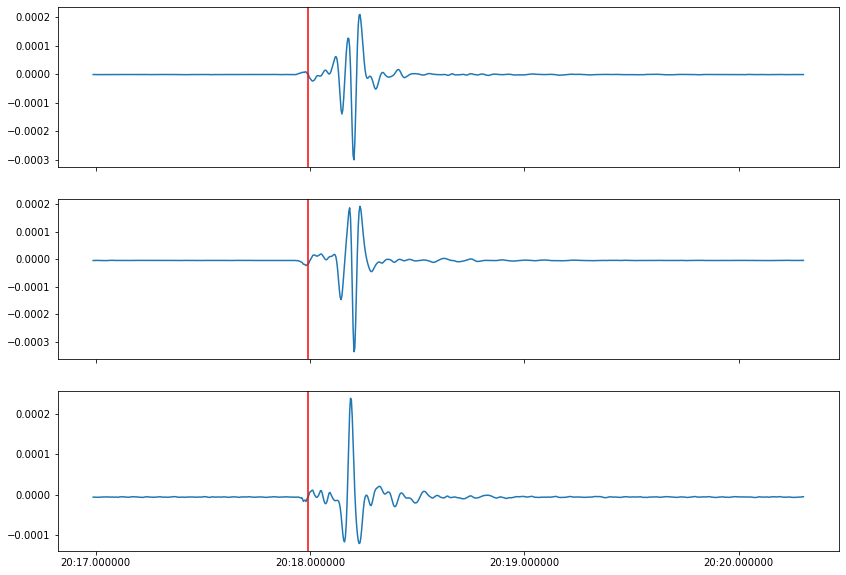

[UTCDateTime(2020, 3, 10, 4, 38, 31, 365019)]


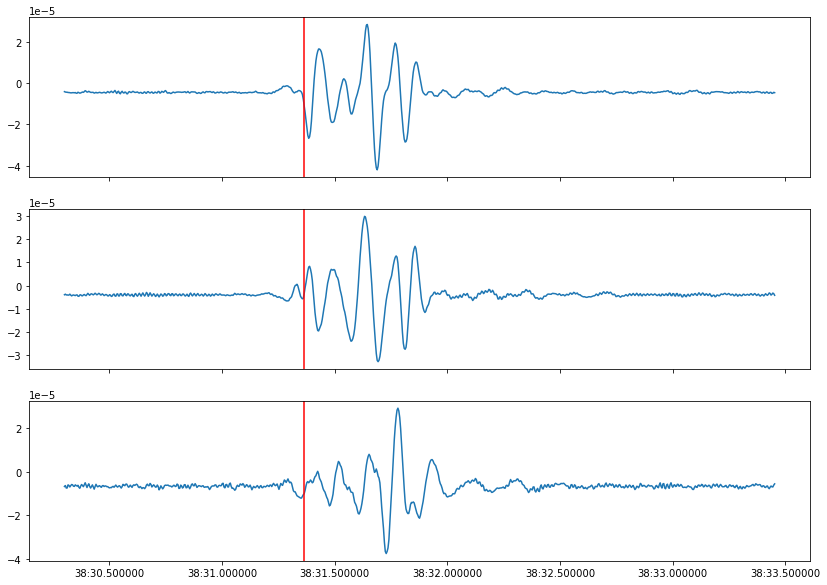

[UTCDateTime(2020, 3, 10, 4, 38, 31, 453019)]


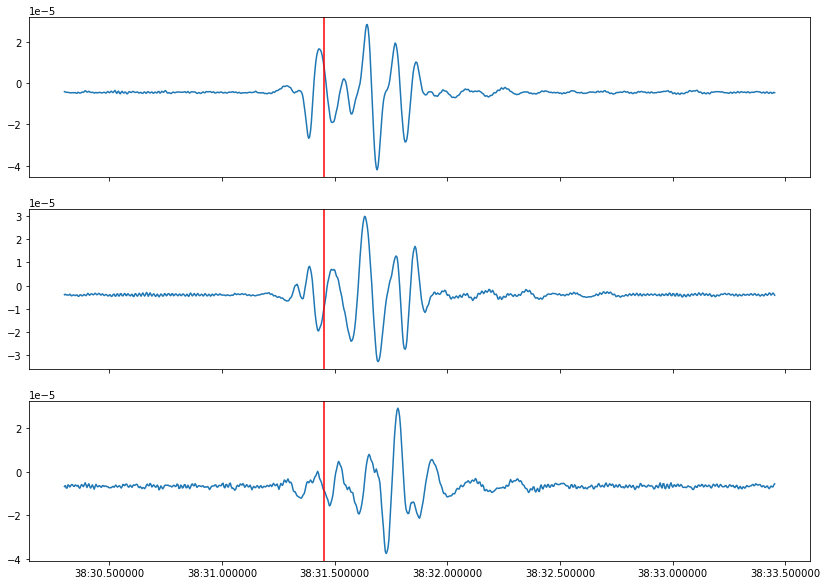

[UTCDateTime(2020, 3, 10, 4, 38, 31, 301020)]


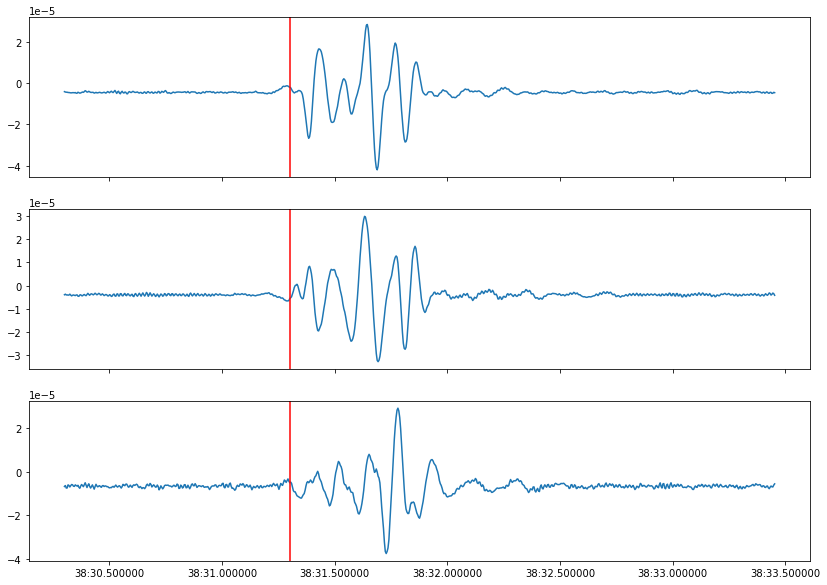

[UTCDateTime(2020, 3, 10, 4, 43, 41, 173039)]


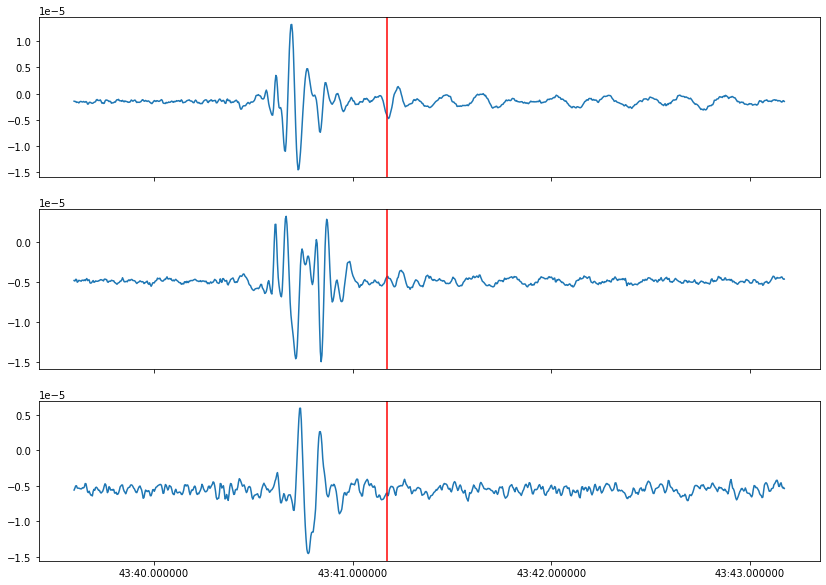

[UTCDateTime(2020, 3, 10, 4, 43, 40, 733039)]


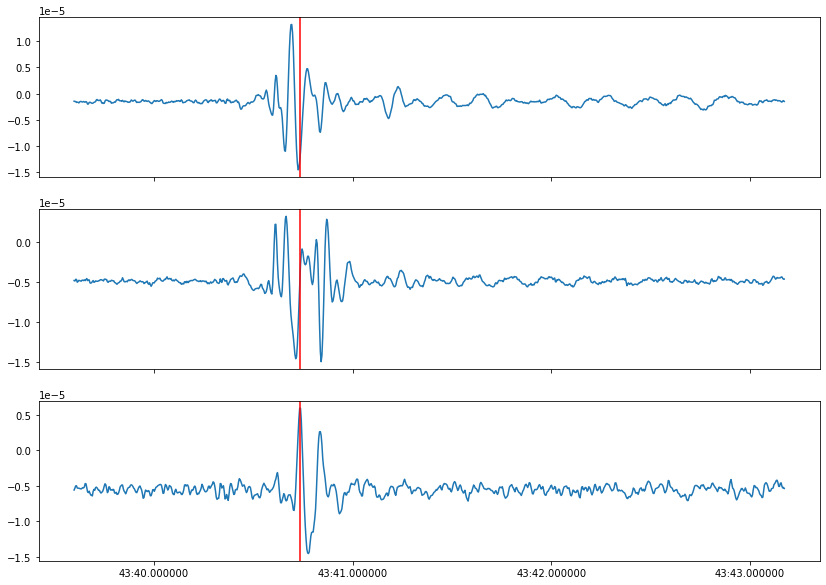

[UTCDateTime(2020, 3, 10, 4, 43, 40, 797039)]


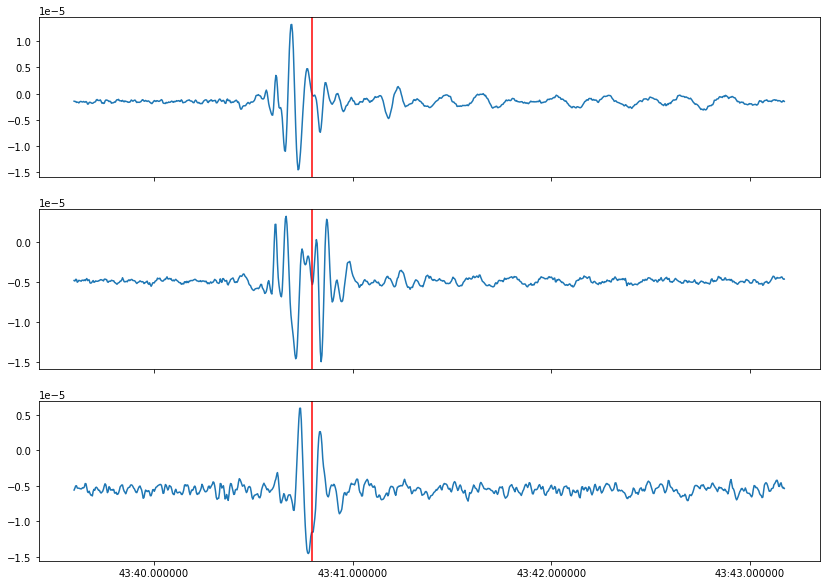

[UTCDateTime(2020, 3, 10, 4, 43, 40, 597039)]


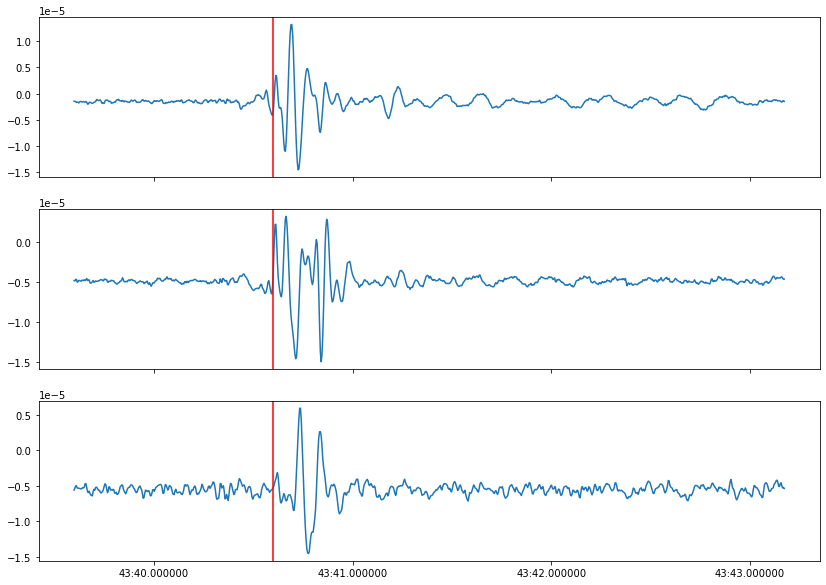

[UTCDateTime(2020, 3, 10, 4, 43, 41, 173039)]


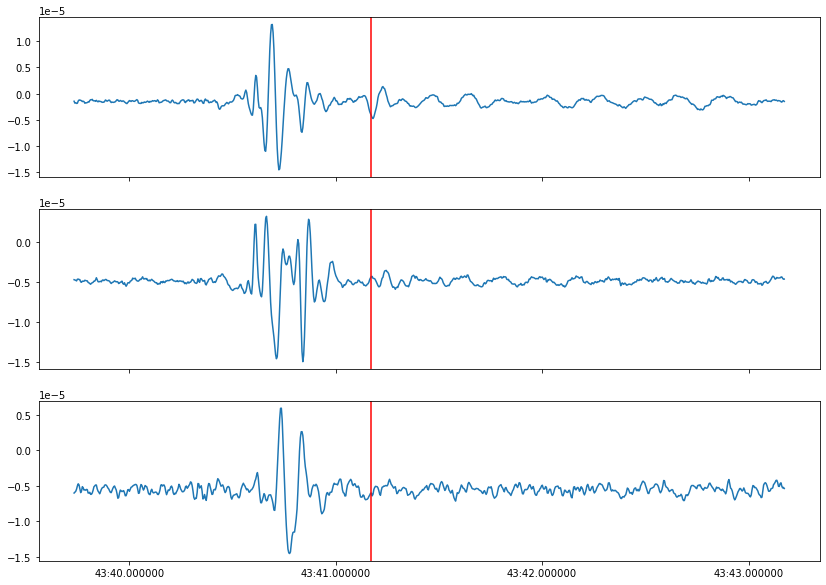

[UTCDateTime(2020, 3, 10, 4, 43, 40, 733039)]


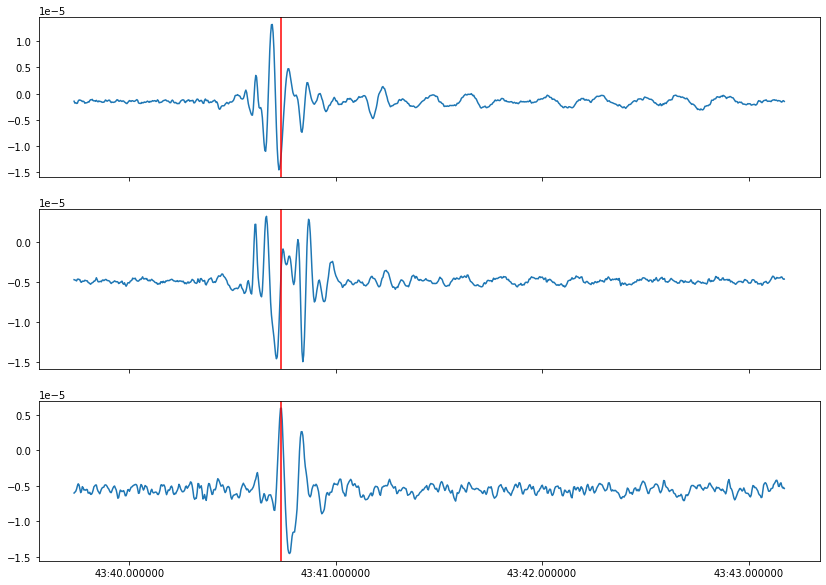

[UTCDateTime(2020, 3, 10, 4, 43, 40, 797039)]


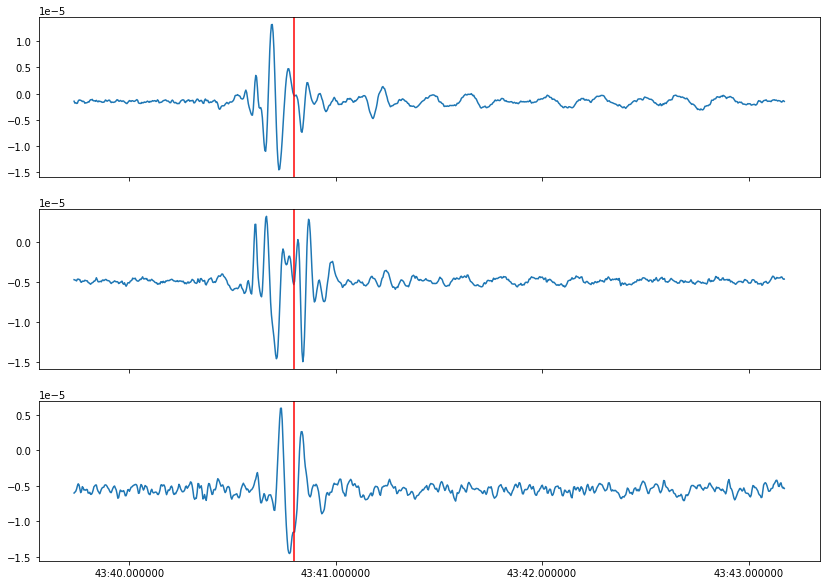

[UTCDateTime(2020, 3, 10, 4, 58, 34, 221092)]


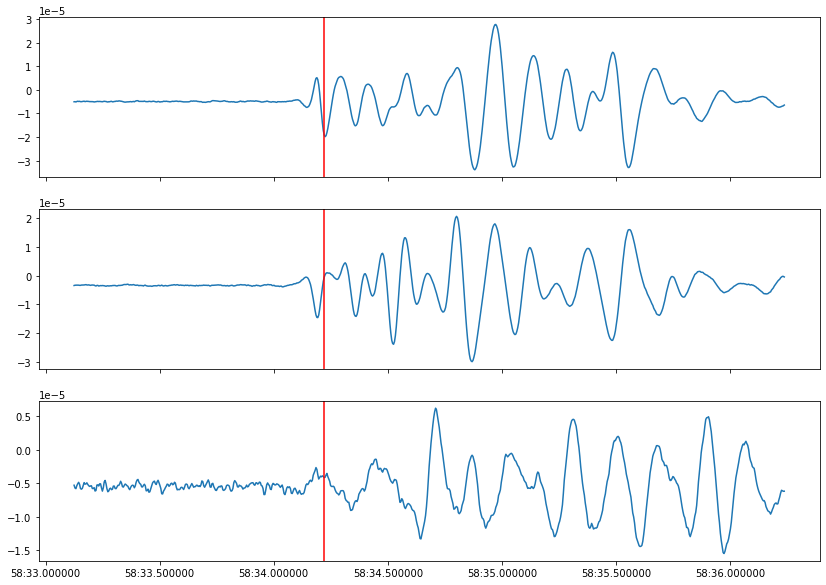

[UTCDateTime(2020, 3, 10, 4, 58, 34, 125092)]


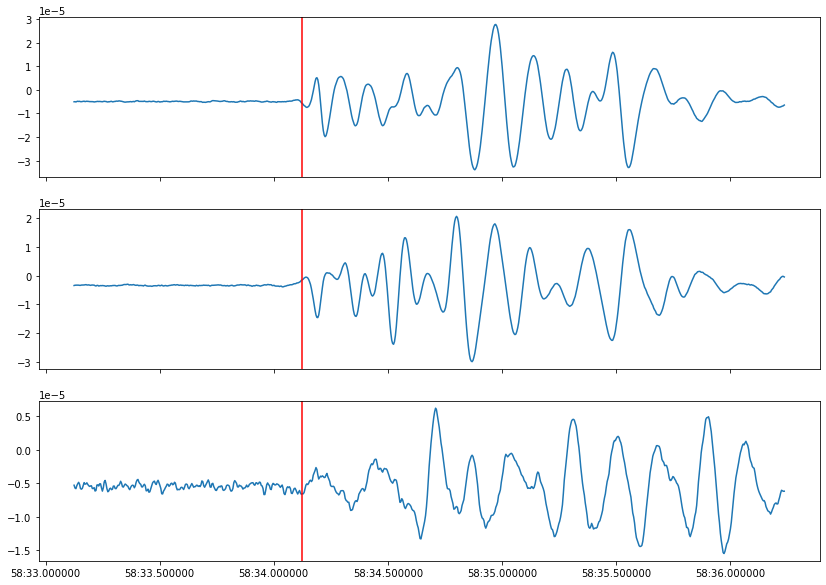

[UTCDateTime(2020, 3, 10, 4, 58, 34, 237093)]


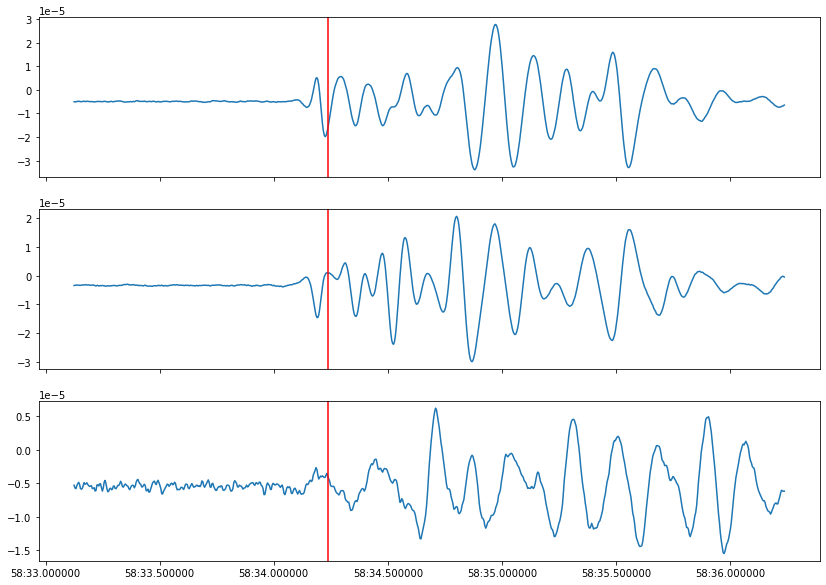

[UTCDateTime(2020, 3, 10, 5, 1, 34, 861103)]


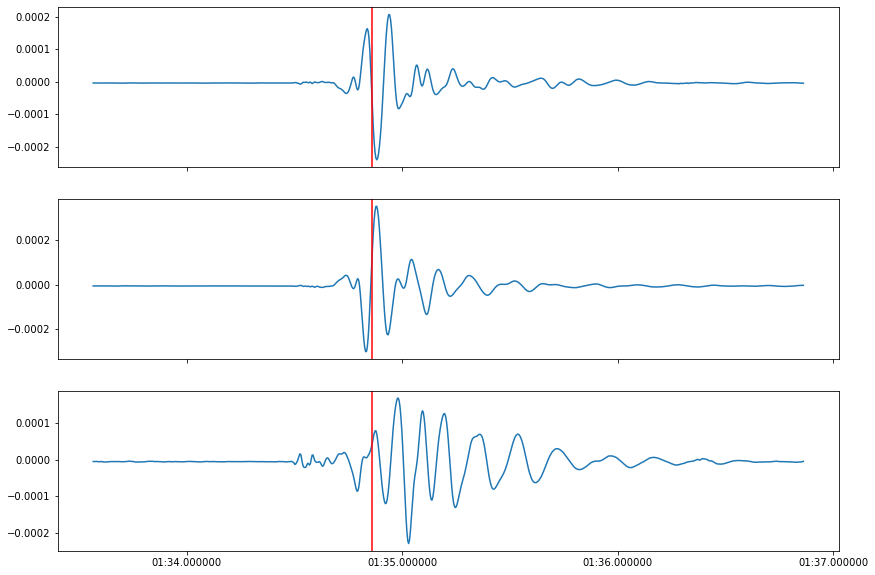

[UTCDateTime(2020, 3, 10, 5, 1, 34, 837103)]


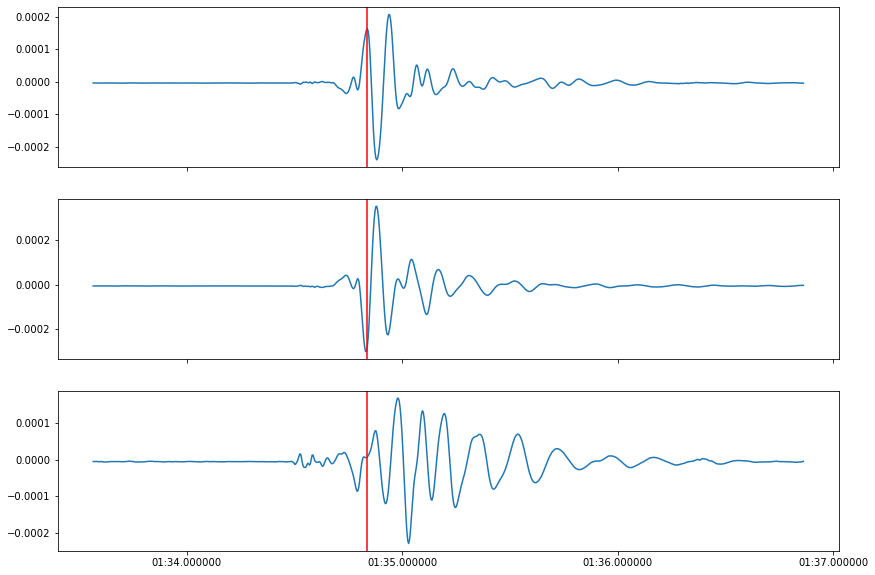

KeyboardInterrupt: 

In [37]:
from obspy import read, Stream
from phasepapy.phasepicker import ktpicker, fbpicker, aicdpicker
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

def plot_picks(ax, tr, picks, color="red"):
    for pick in picks:
        t = pick._get_datetime()
        ax.axvline(mdates.date2num(t), color=color, linestyle="-")

wf_dir = "/Volumes/SanDisk_2TB/X7_Jan-Feb2020_sac_daily_250Hz/"
for event in catalog.events:
    tmin = min([p.time for p in event.picks])
    tmax = max([p.time for p in event.picks])
    stations = list(set([p.waveform_id.station_code for p in event.picks]))
    st = Stream()
    for sta in stations:
        st += read(os.path.join(wf_dir,sta,"*%s*" % tmin.strftime("%Y%m%d")), 
                  starttime = tmin - 1, endtime = tmax + 2)
        sta_pick = [p.time for p in event.picks if p.waveform_id.station_code == sta]
        print(sta_pick)
        # Plot with picks
        fig, axs = plt.subplots(3, 1, sharex=True, figsize=(14,10))
        axs[0].plot_date(st[0].times("matplotlib"), st[0].data, marker=None, linestyle="-")
        plot_picks(axs[0], st[0], sta_pick, color="red")
        axs[1].plot_date(st[1].times("matplotlib"), st[1].data, marker=None, linestyle="-")
        plot_picks(axs[1], st[1], sta_pick, color="red")
        axs[2].plot_date(st[2].times("matplotlib"), st[2].data, marker=None, linestyle="-")
        plot_picks(axs[2], st[2], sta_pick, color="red")
        plt.show()

In [112]:
len(catalog)

245

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


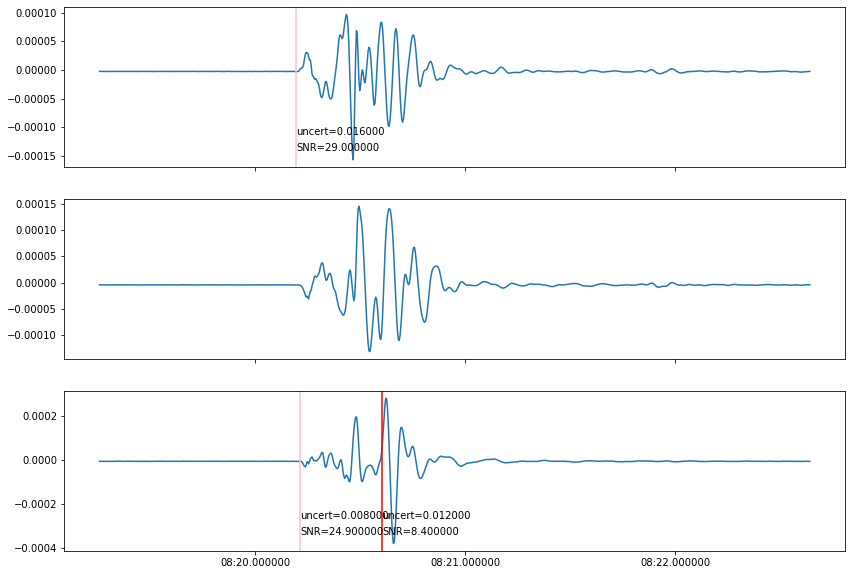

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


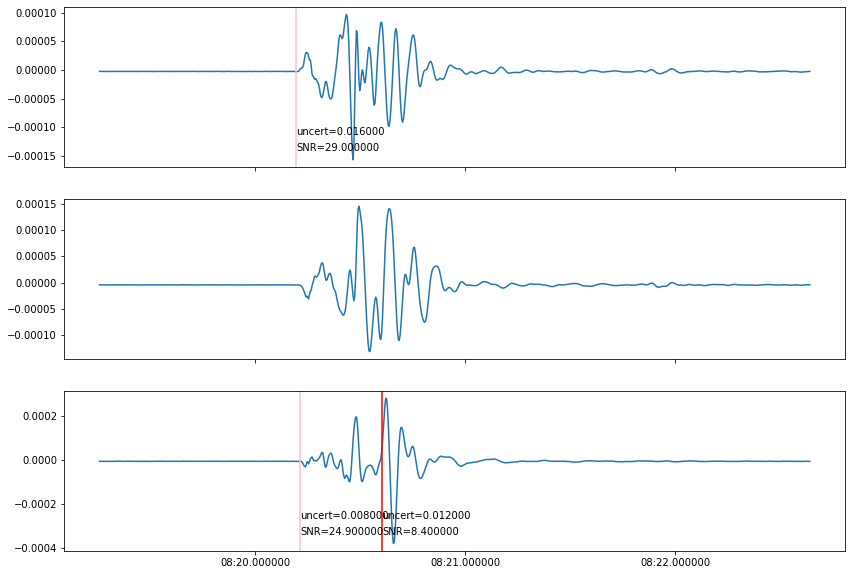

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


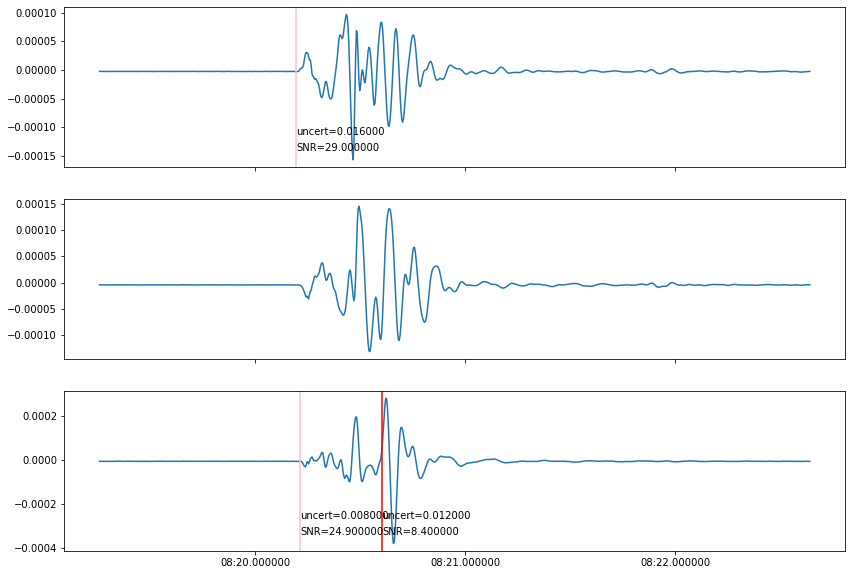

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


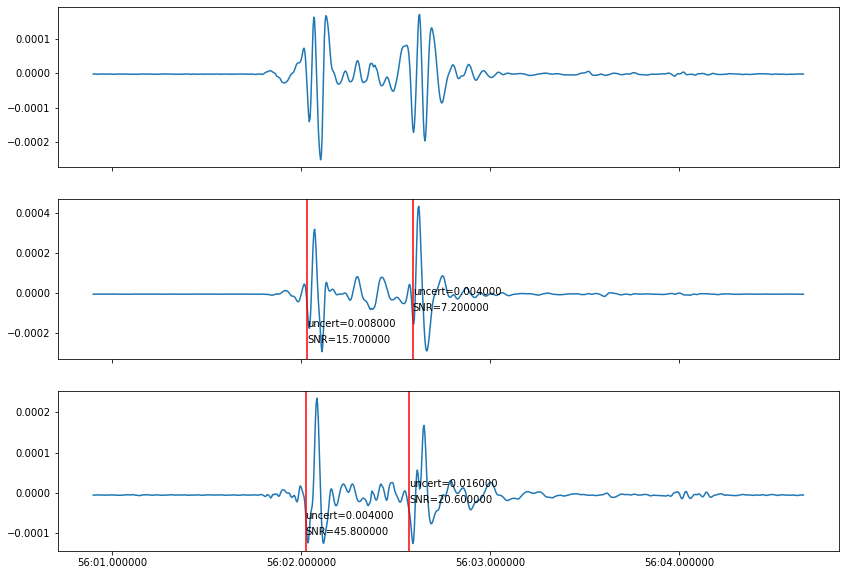

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


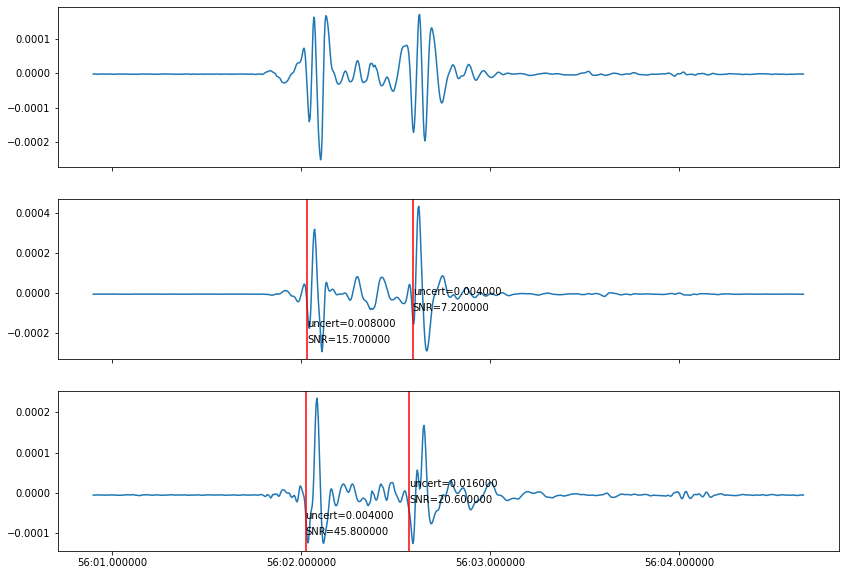

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


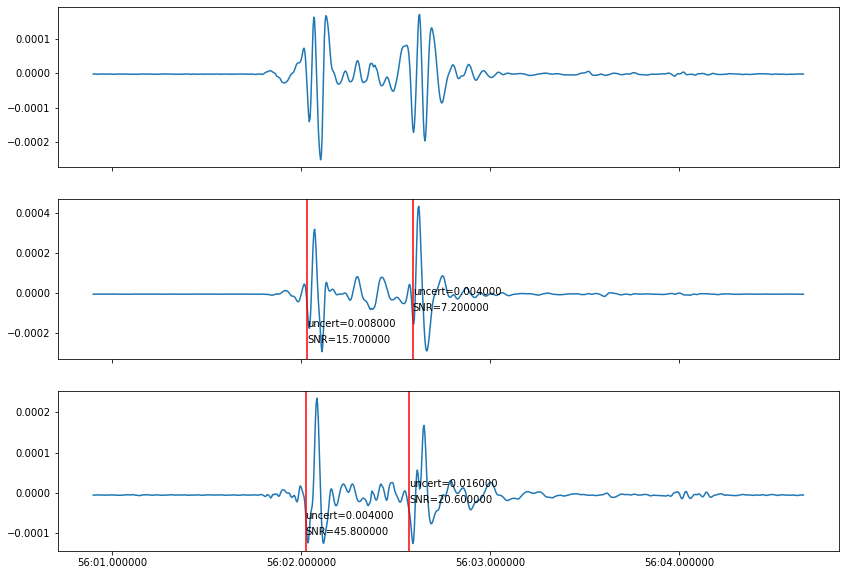

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


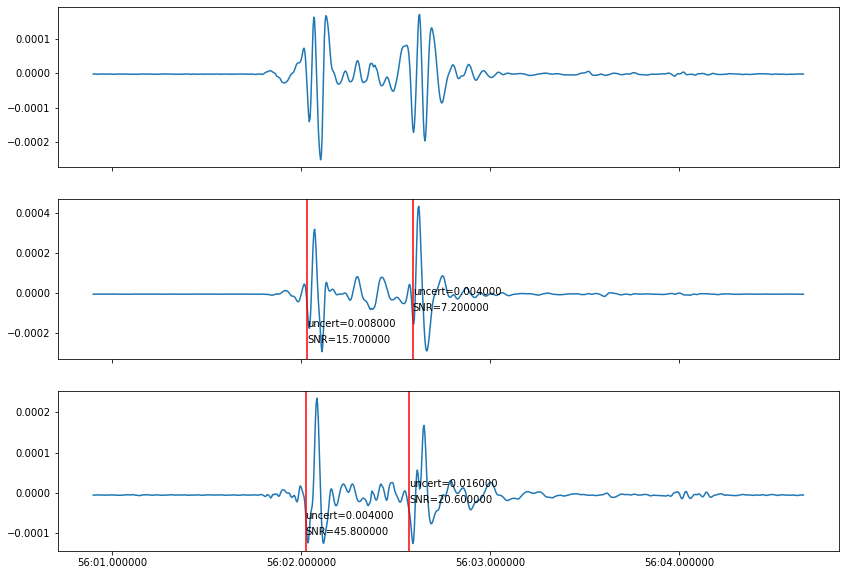

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


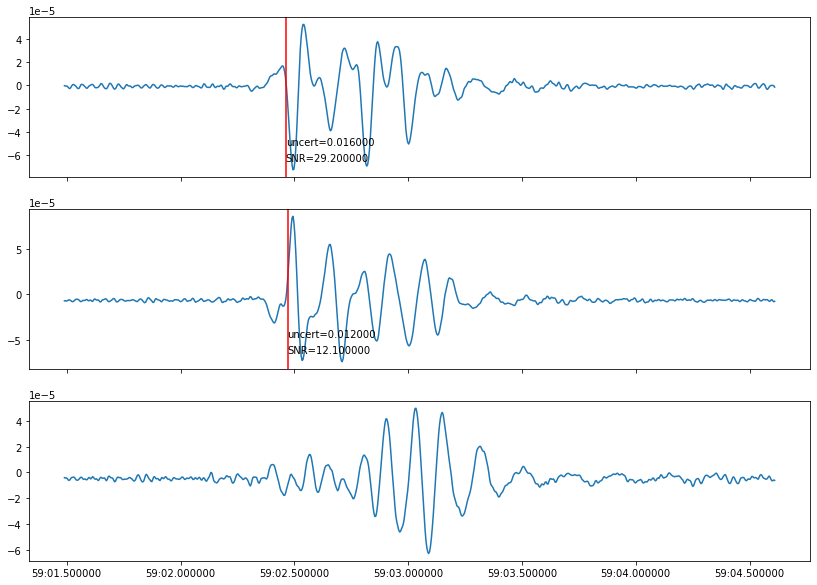

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


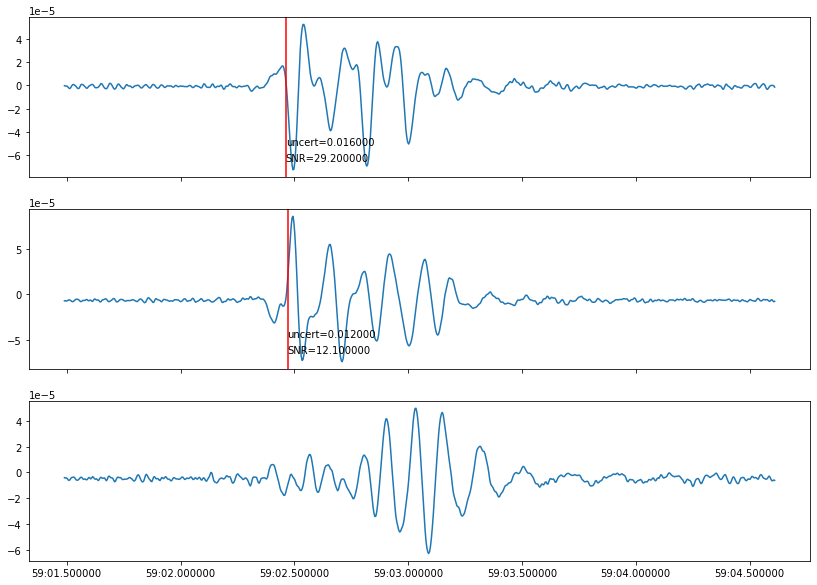

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


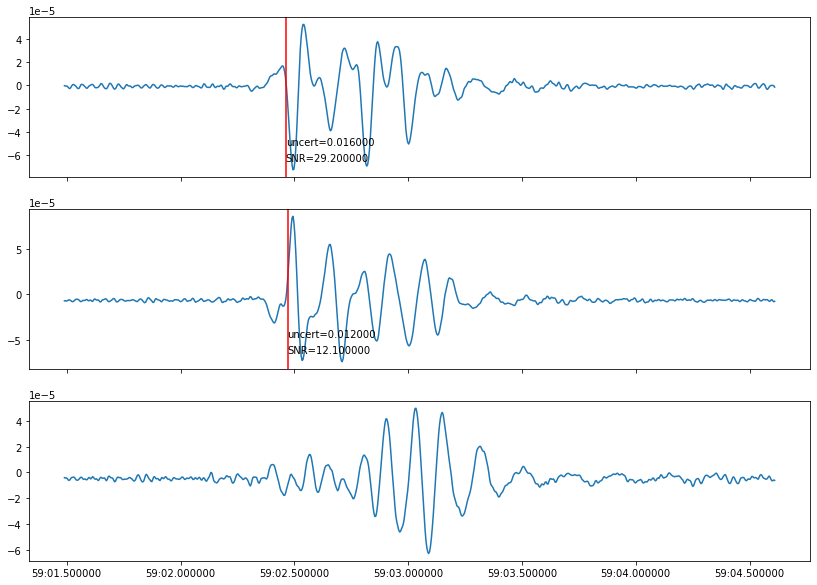

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


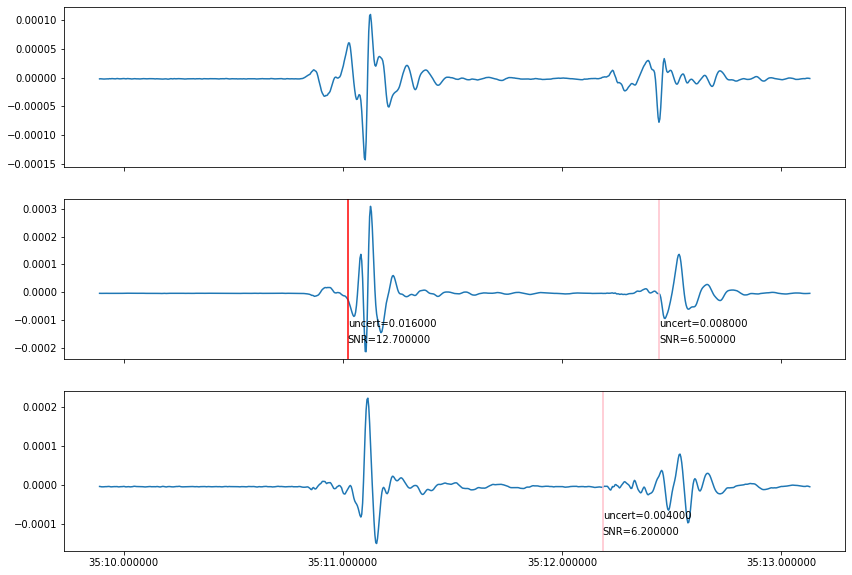

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


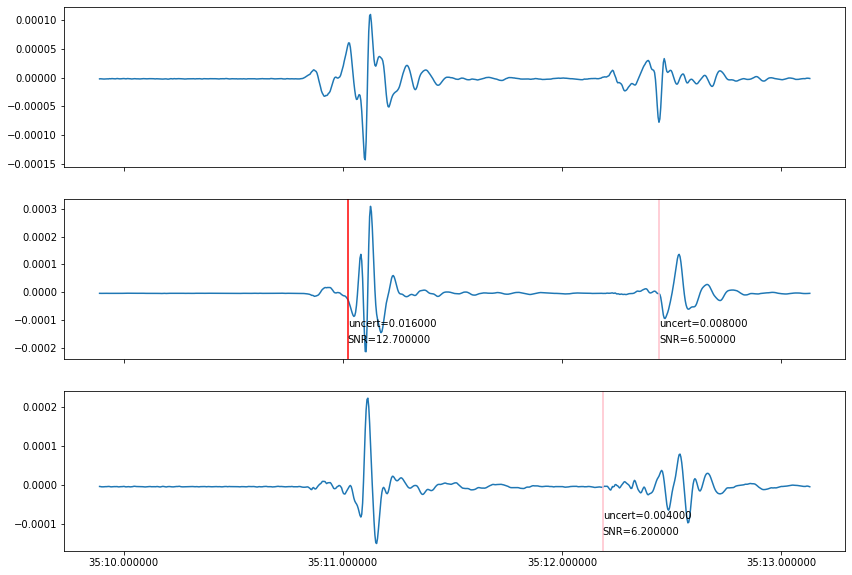

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


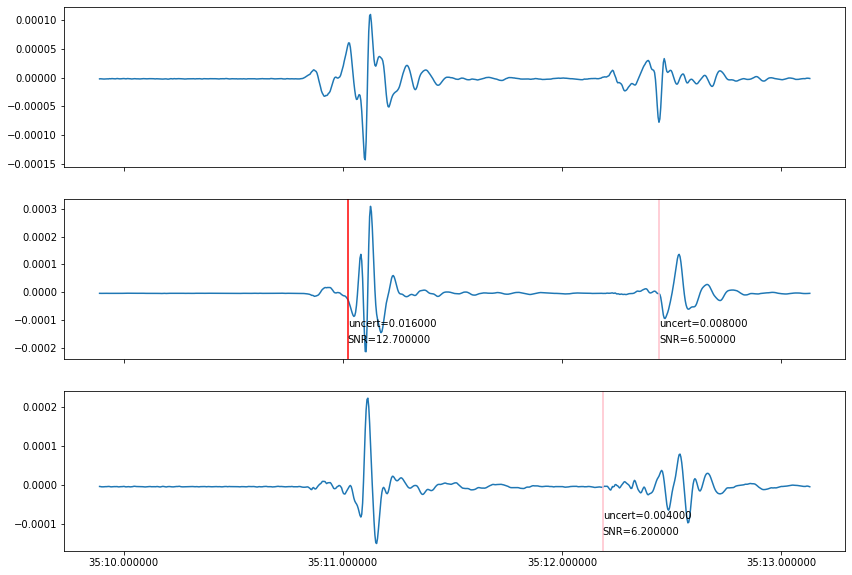

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


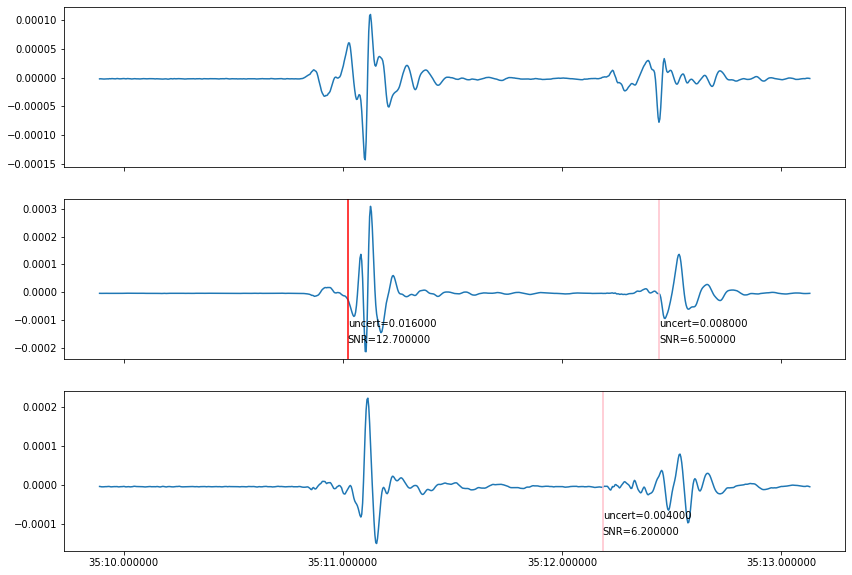

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


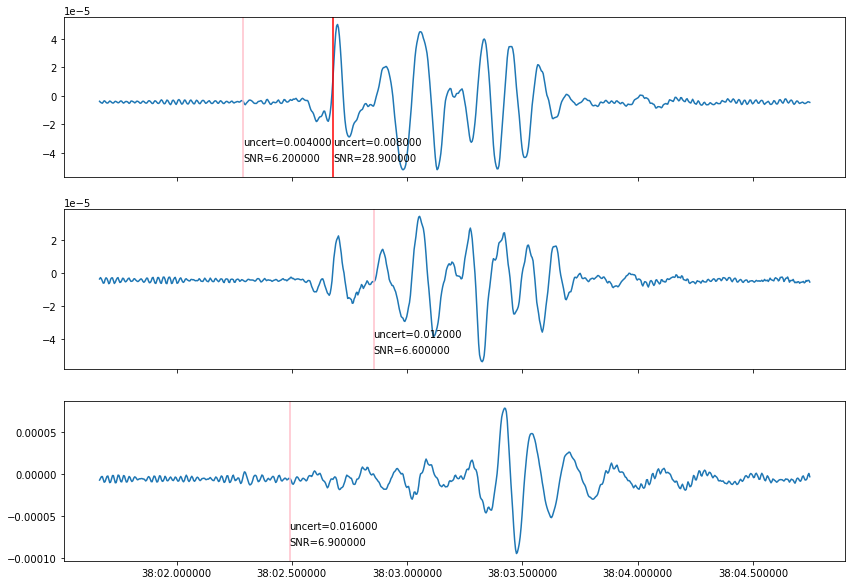

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


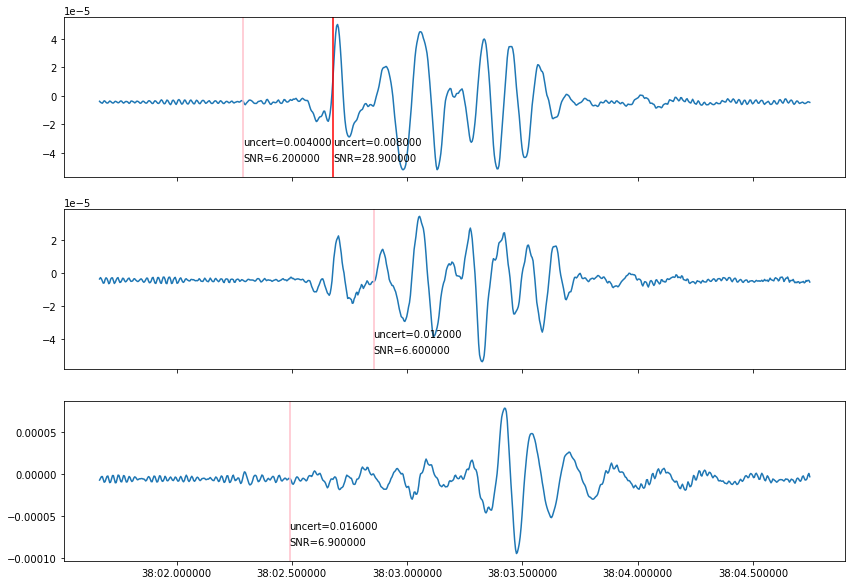

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


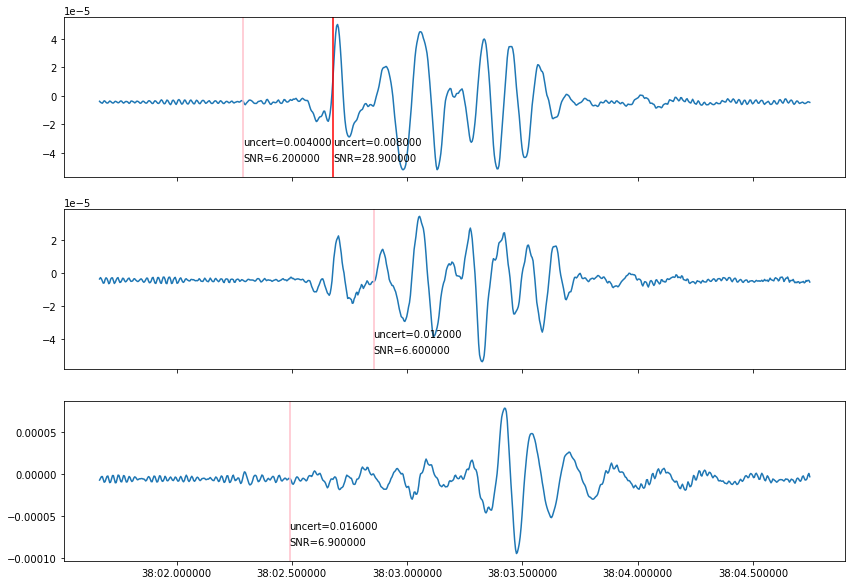

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


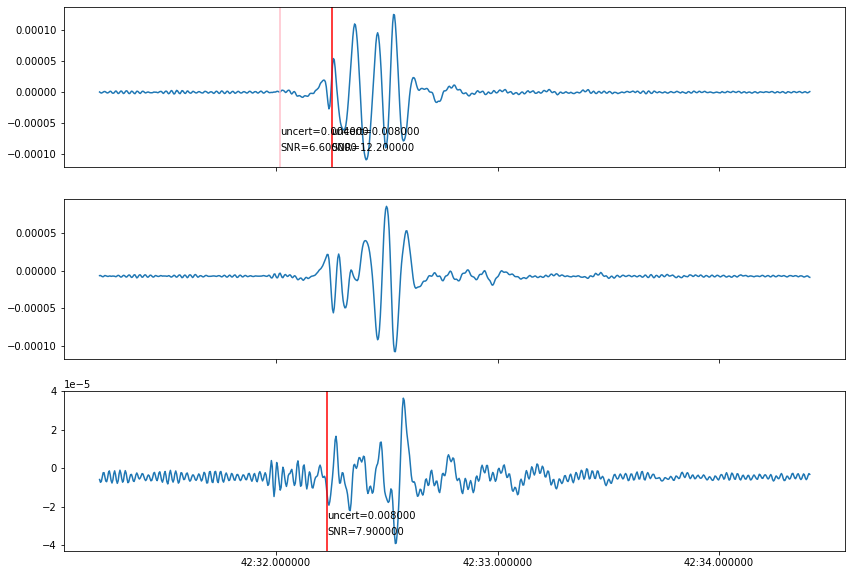

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


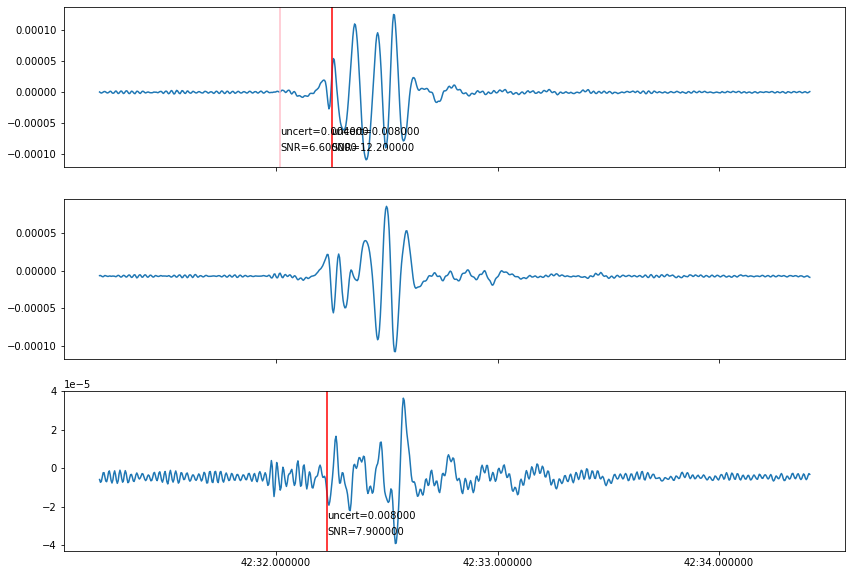

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


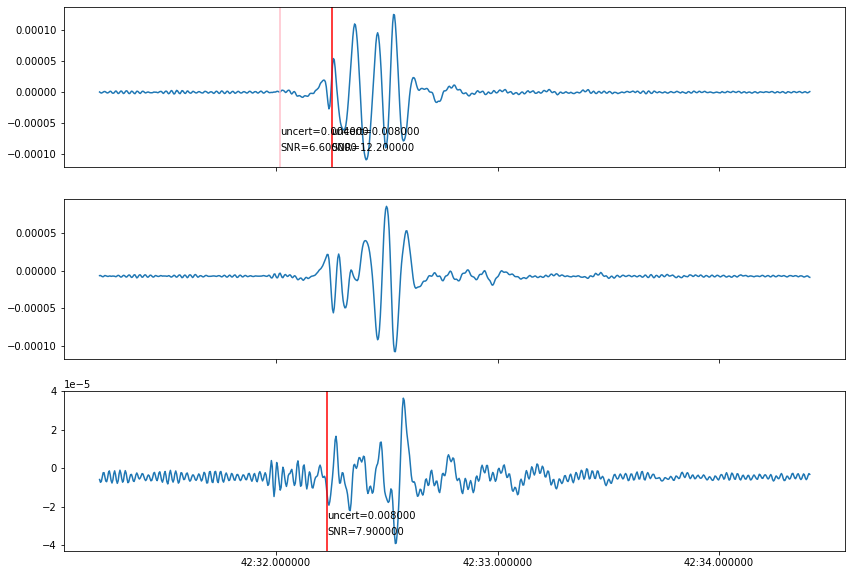

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

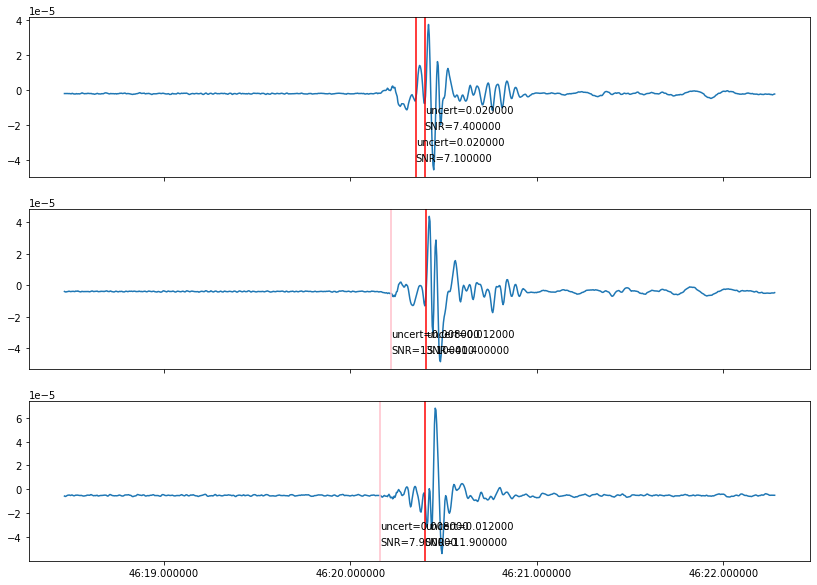

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

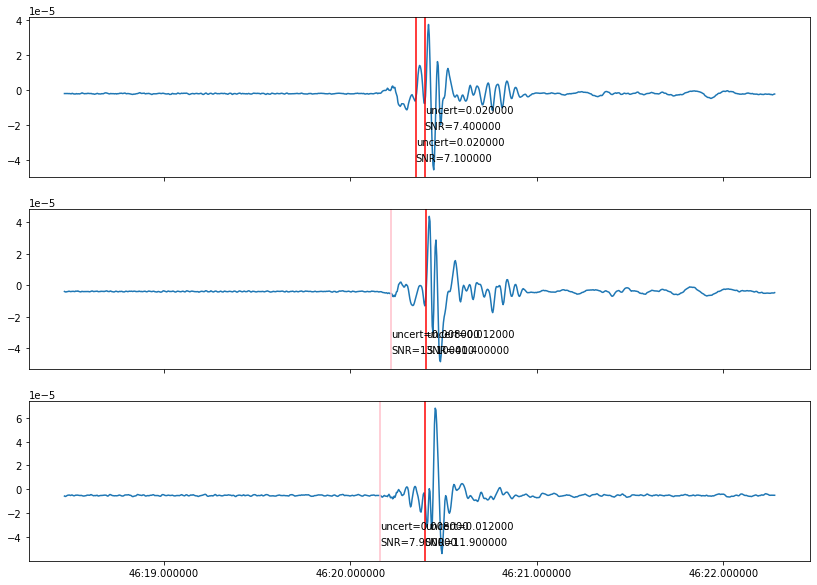

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

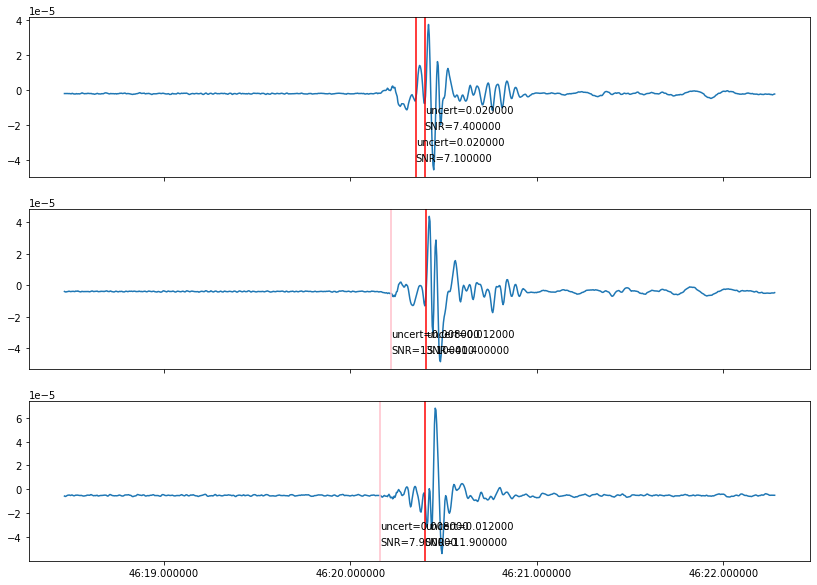

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

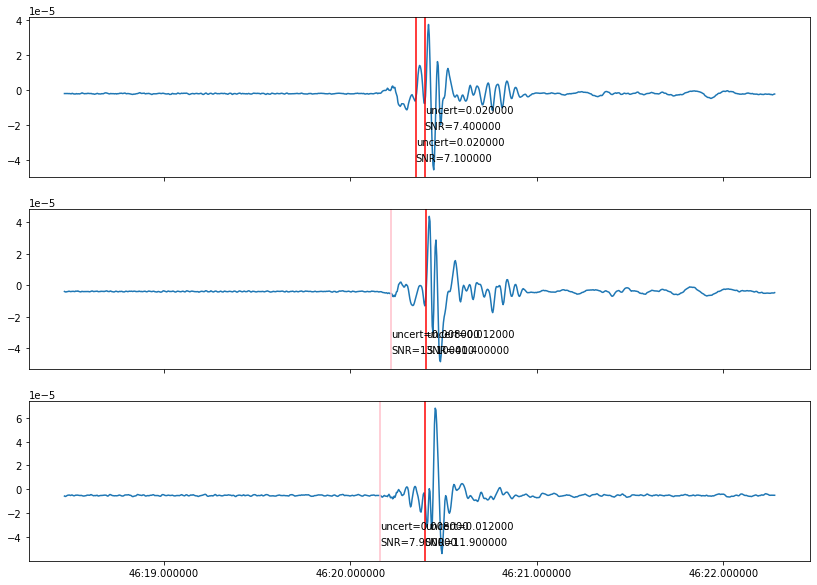

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


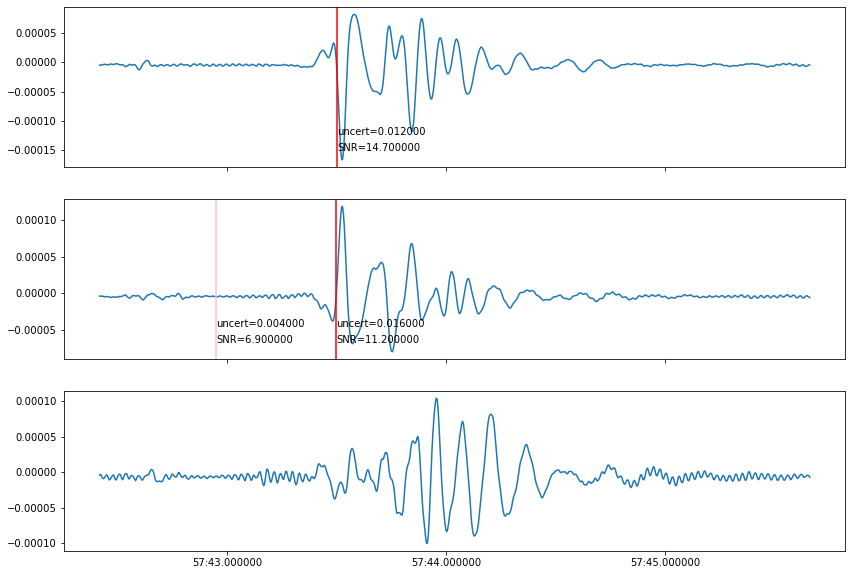

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


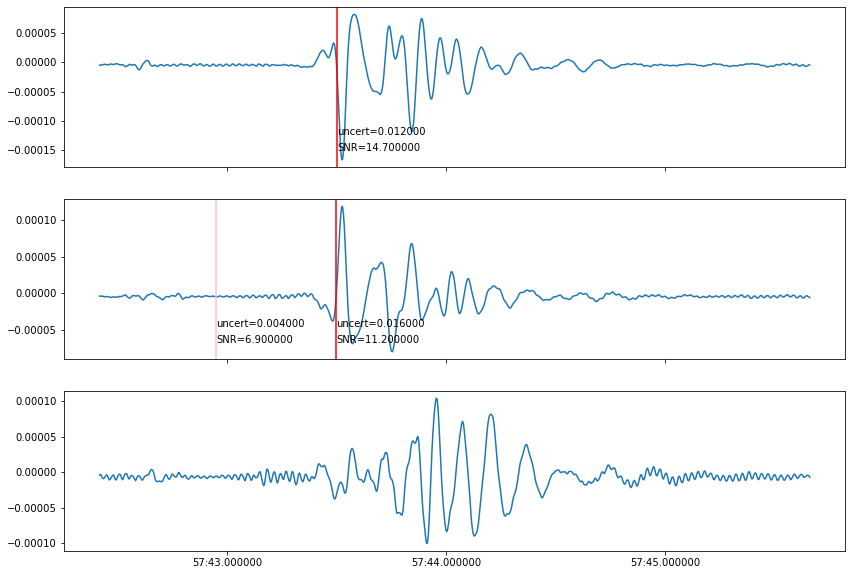

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


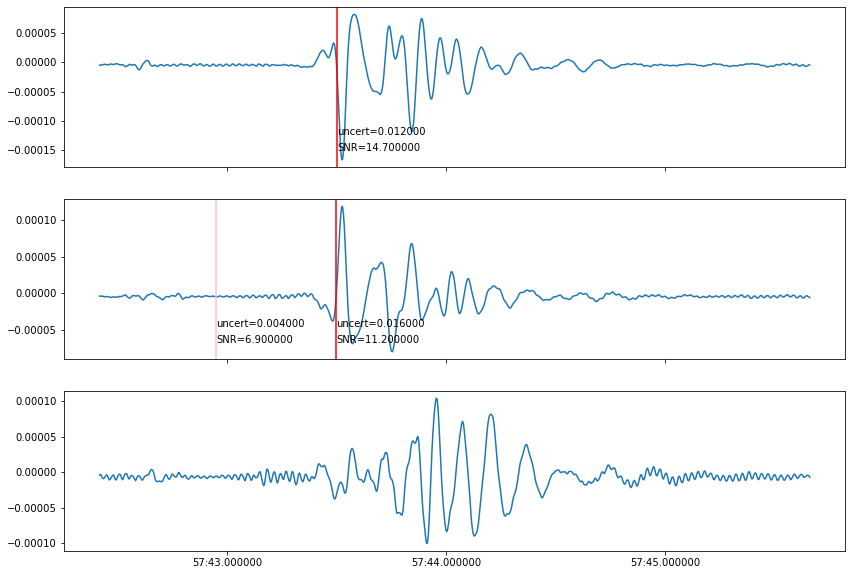

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


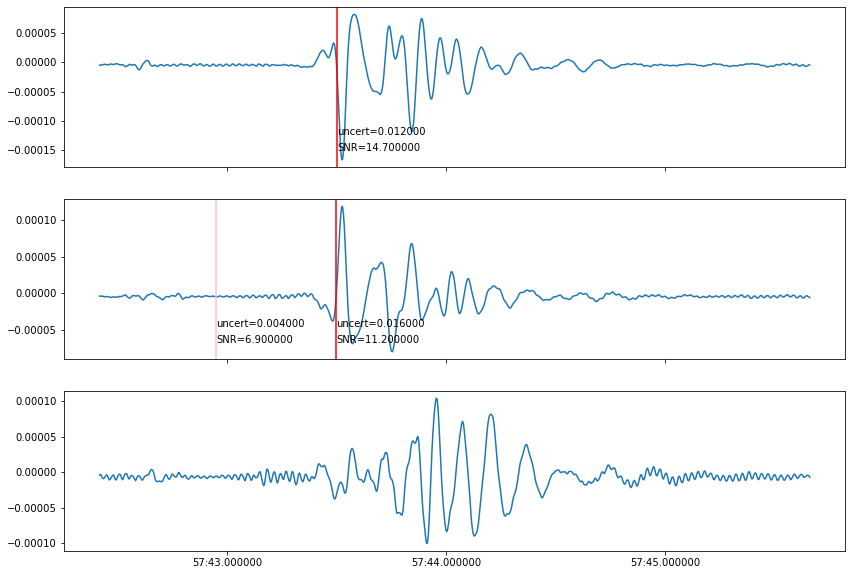

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


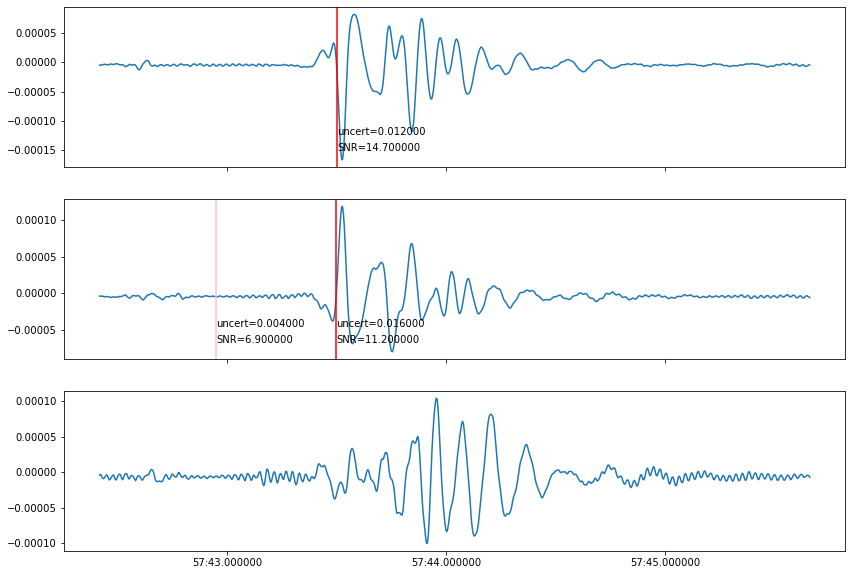

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


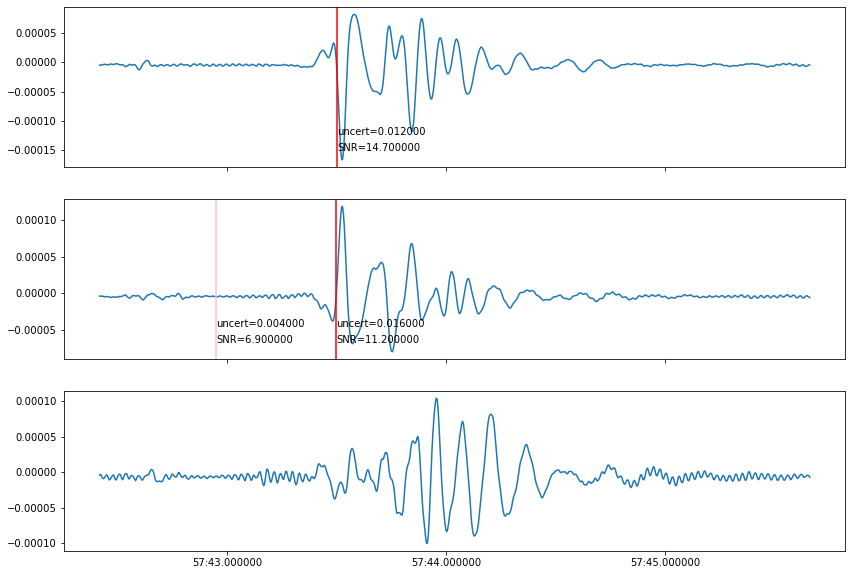

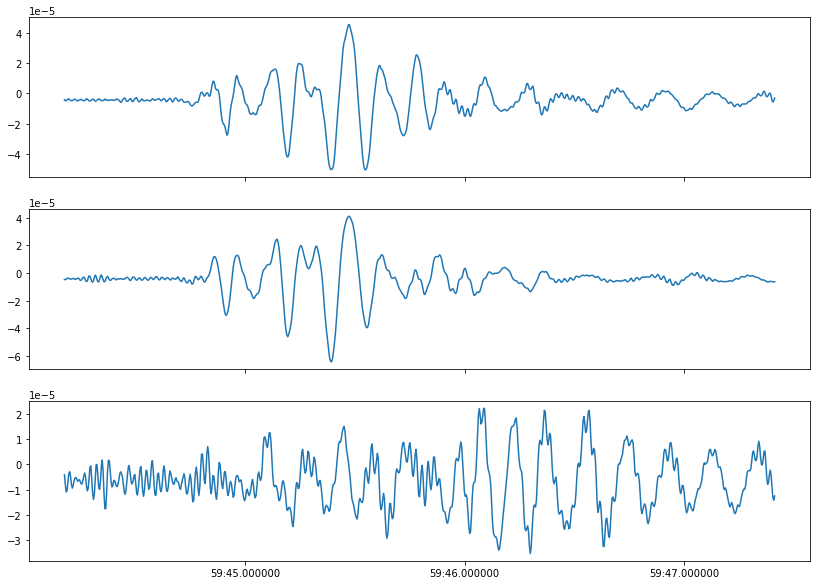

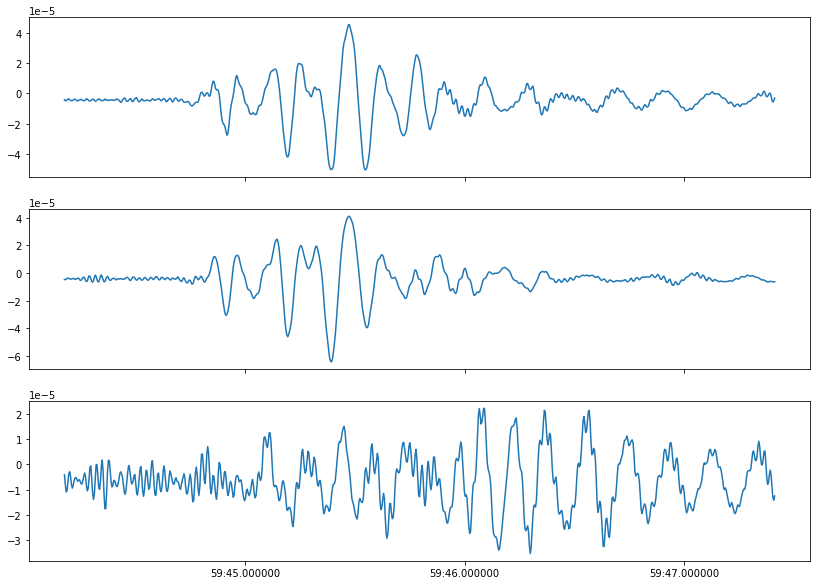

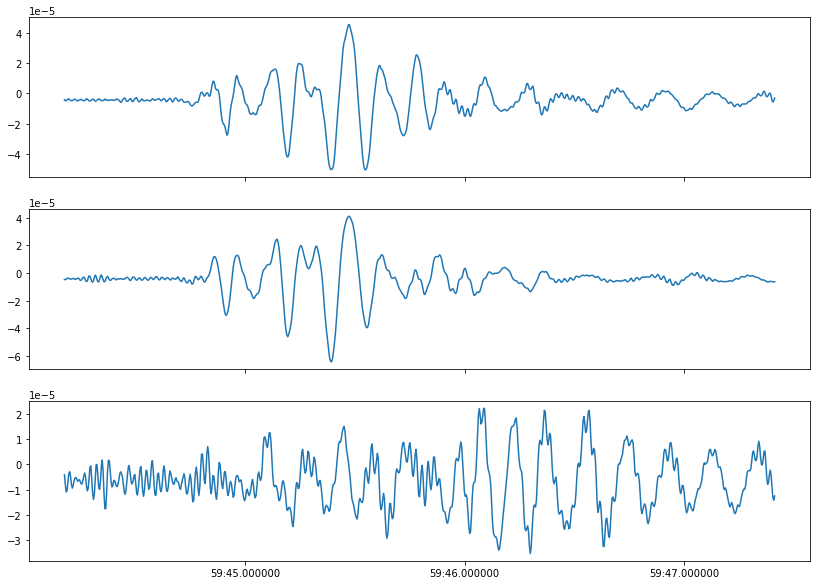

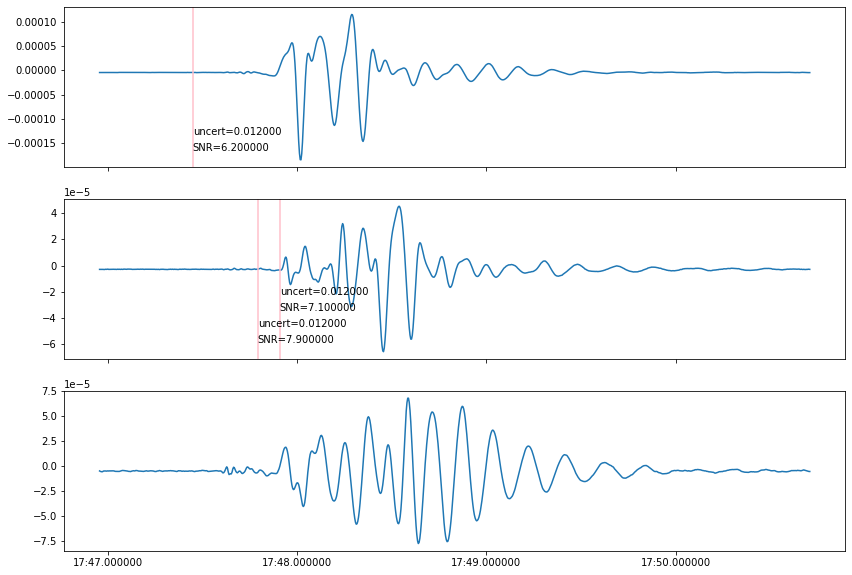

...

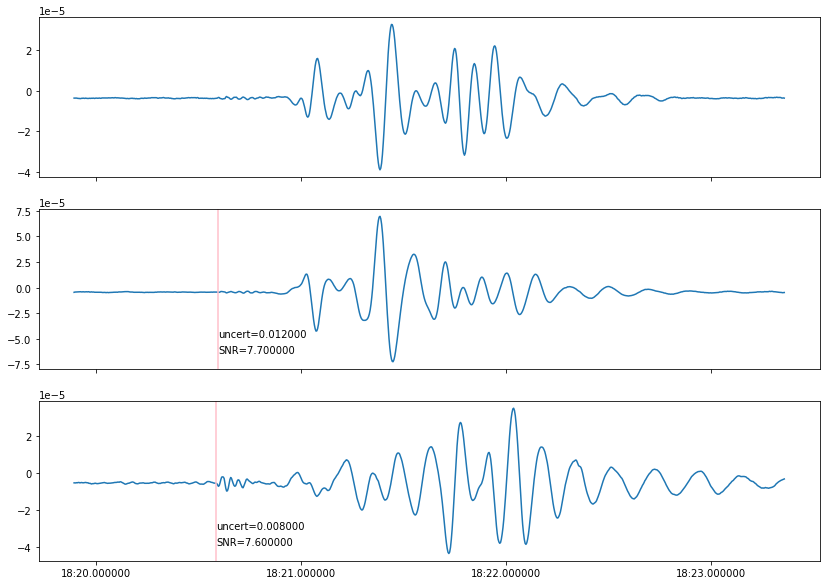

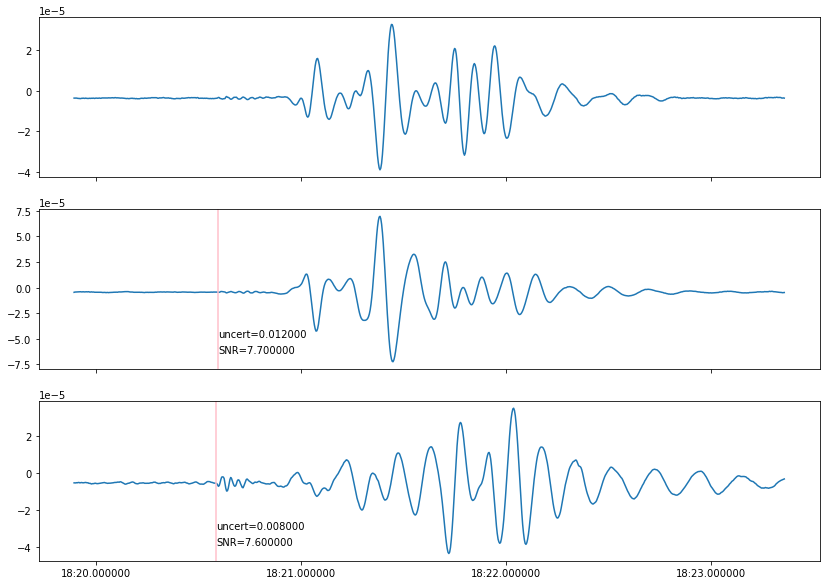

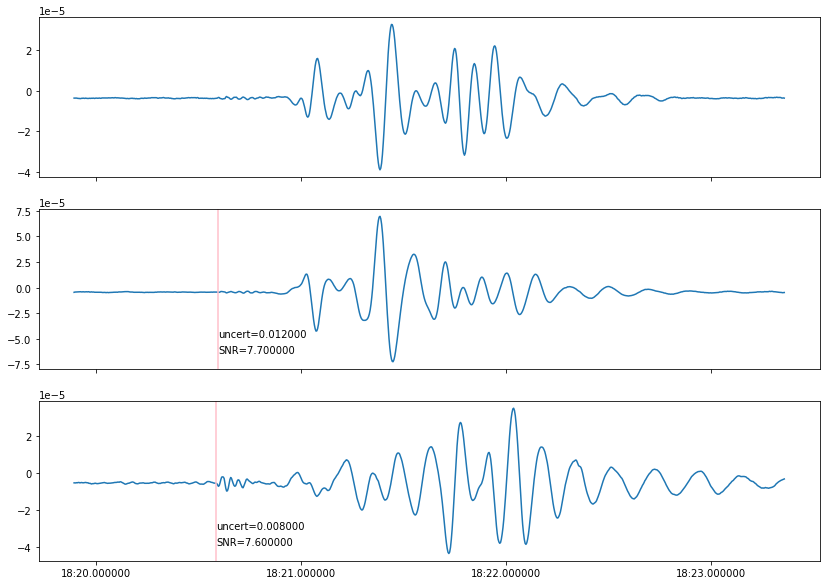

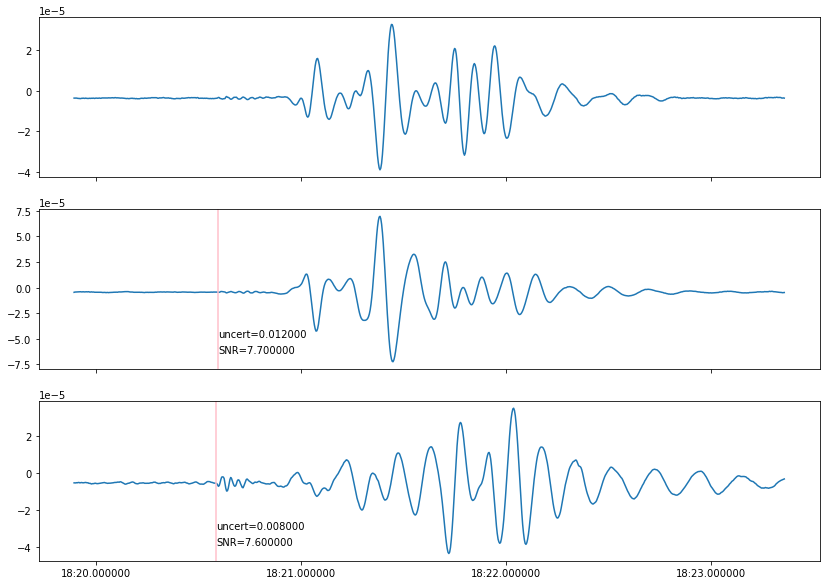

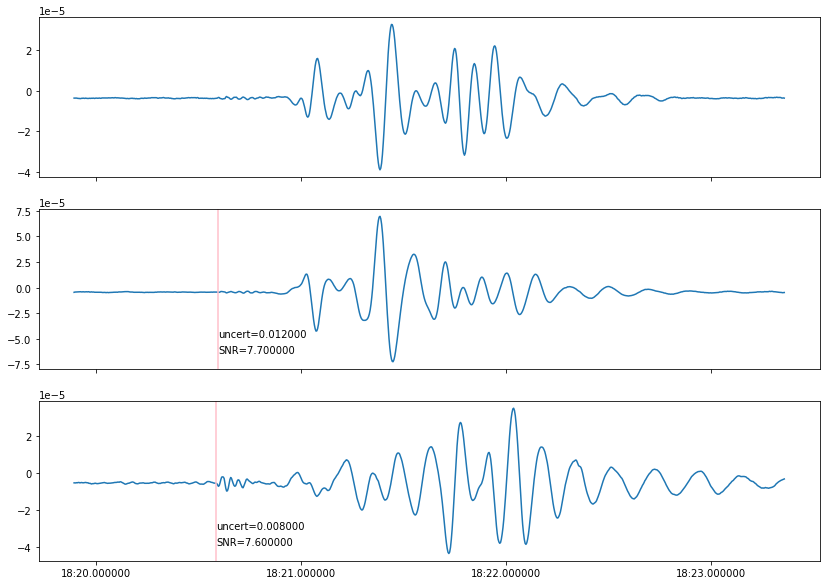

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

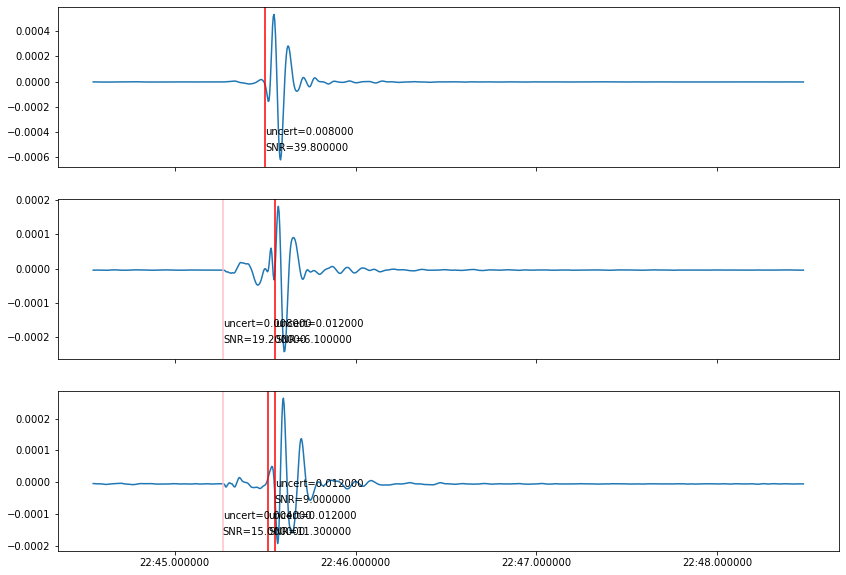

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

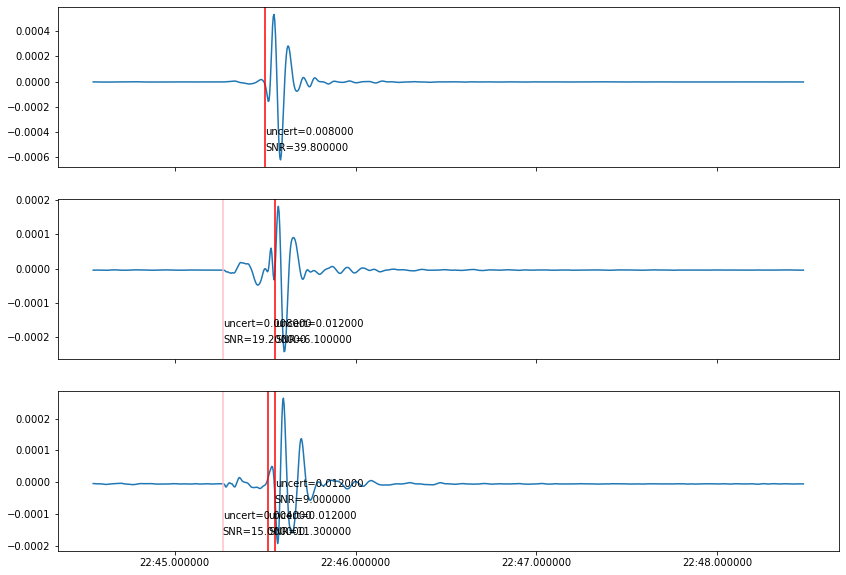

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

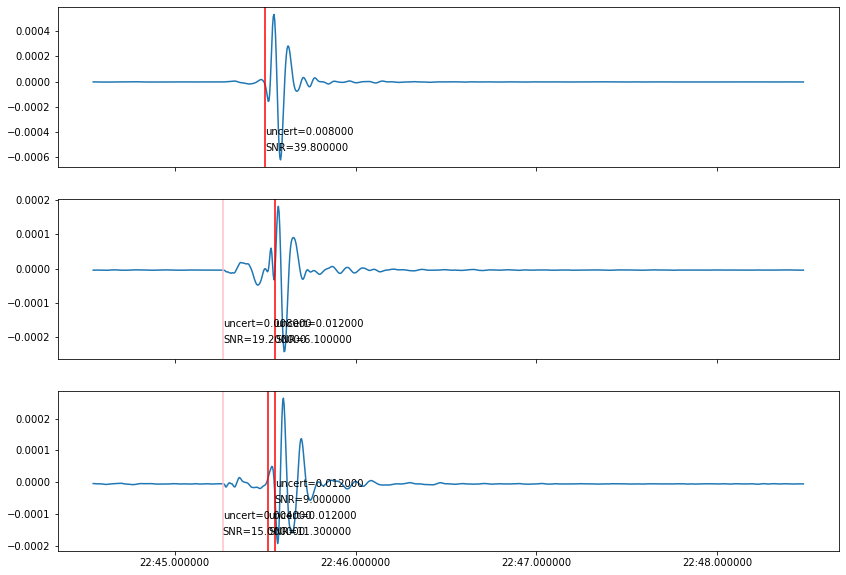

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

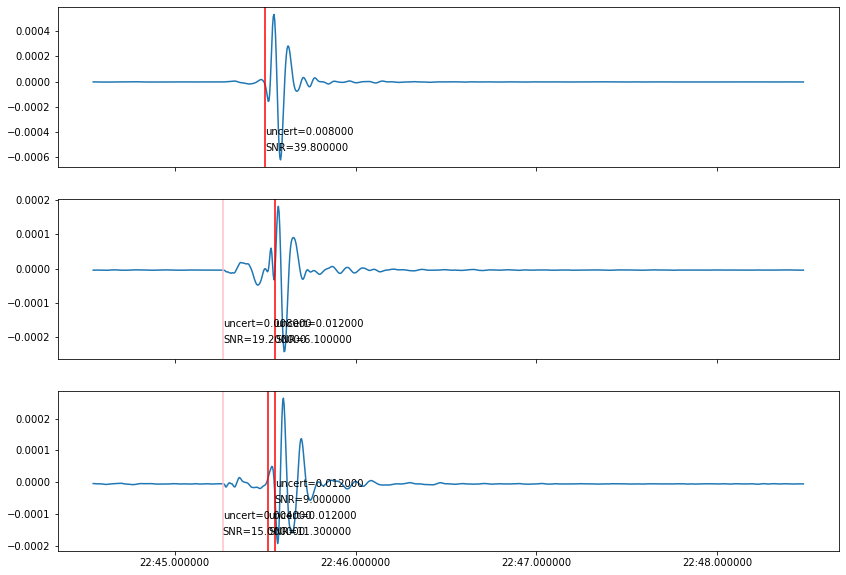

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

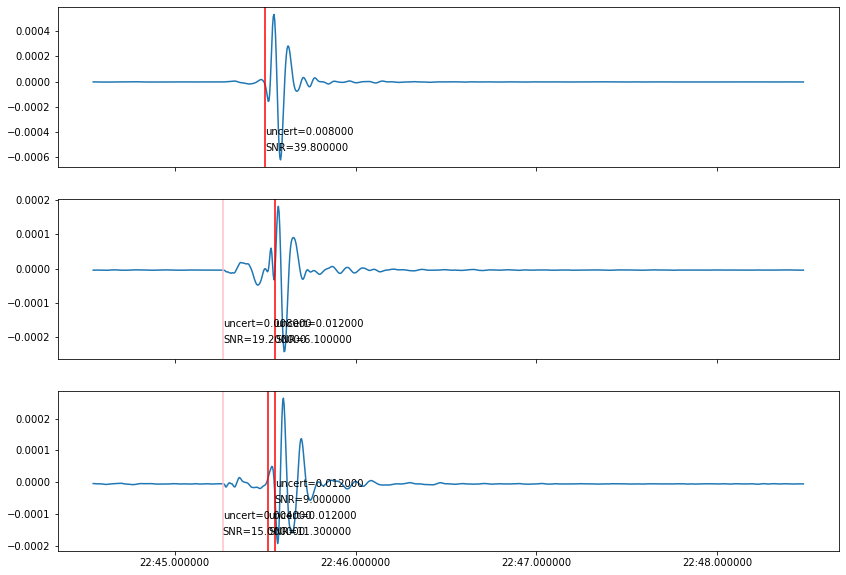

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

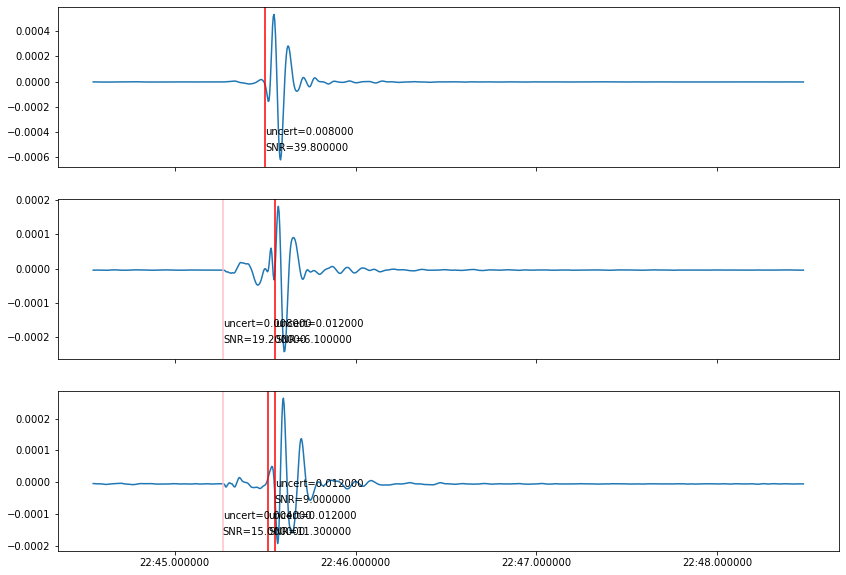

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid va

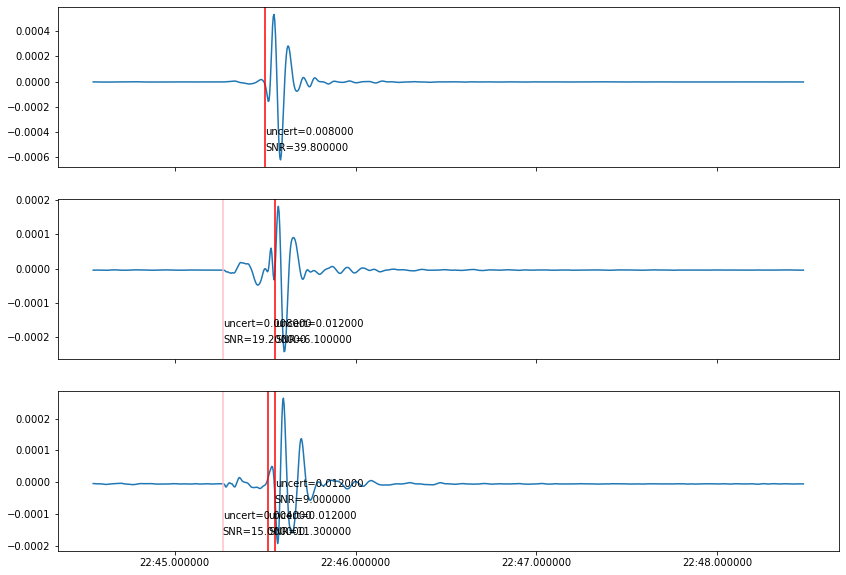

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


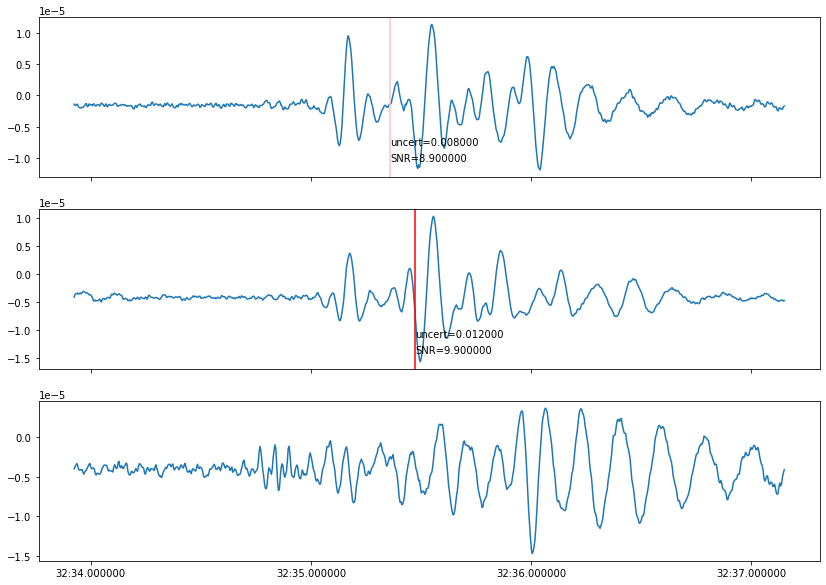

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


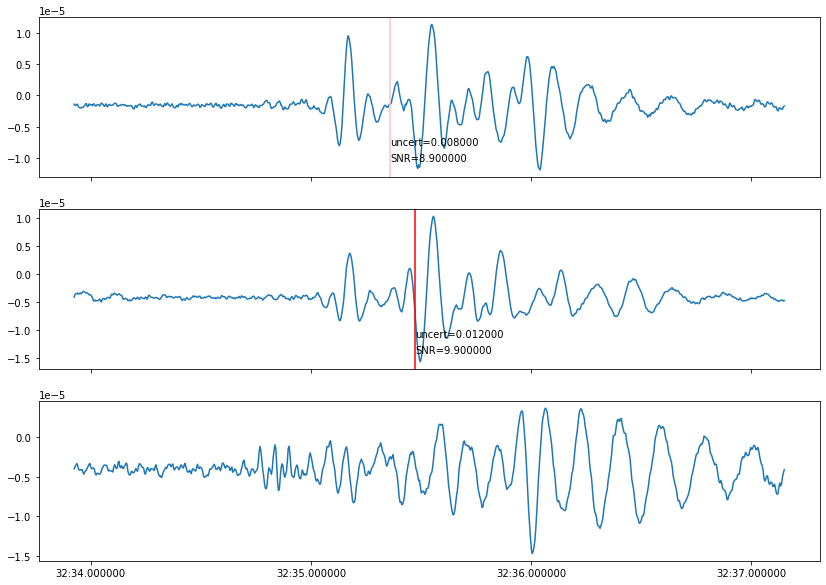

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


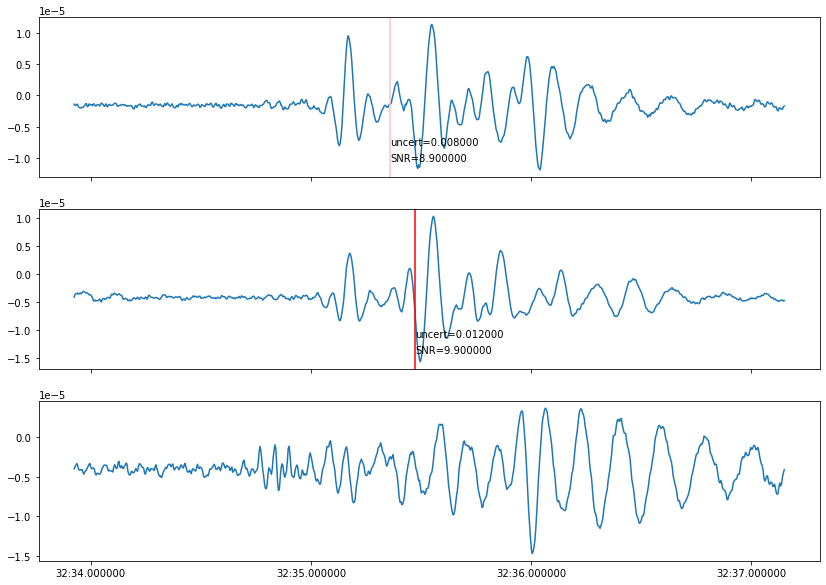

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


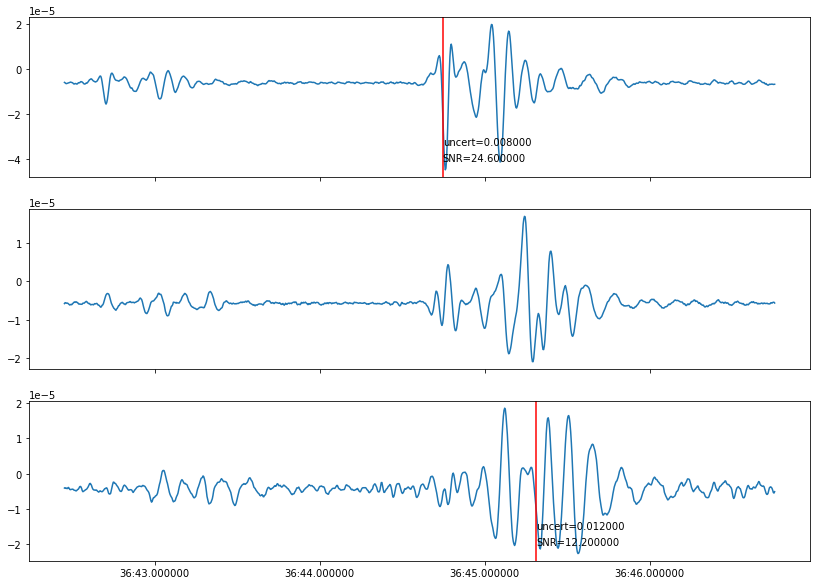

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


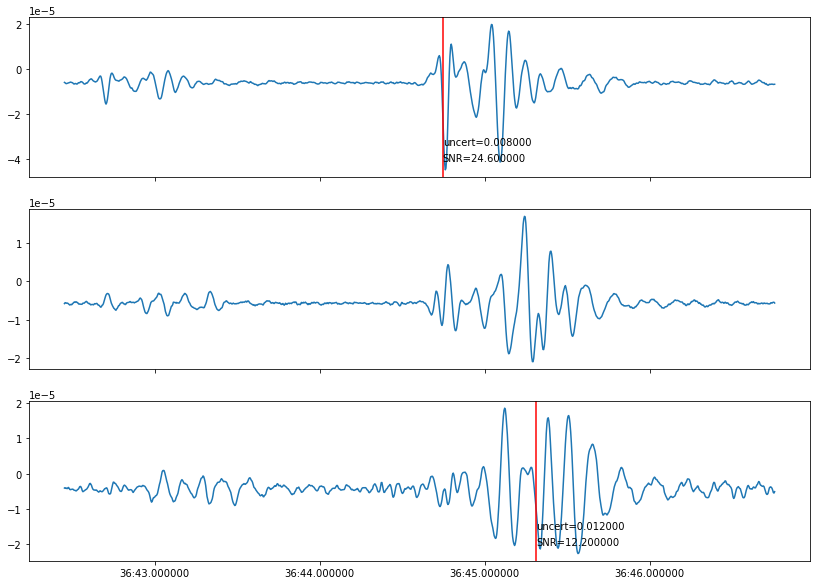

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


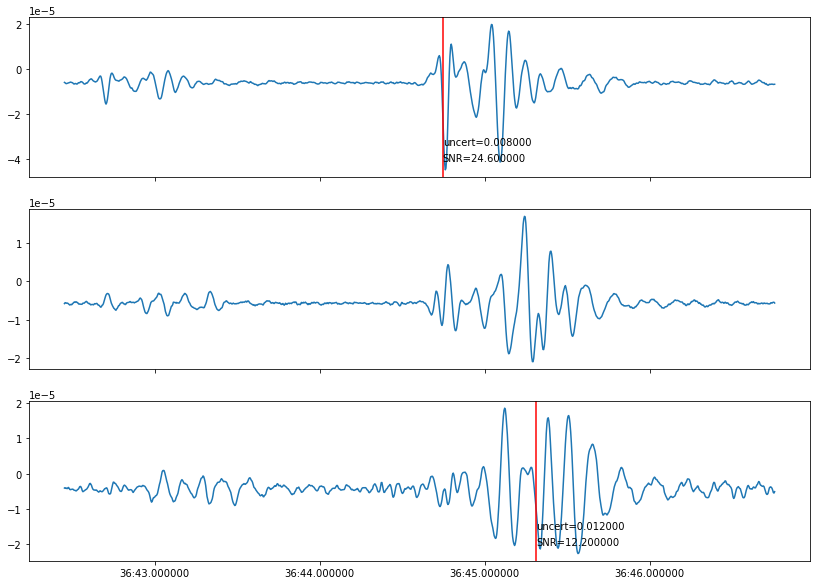

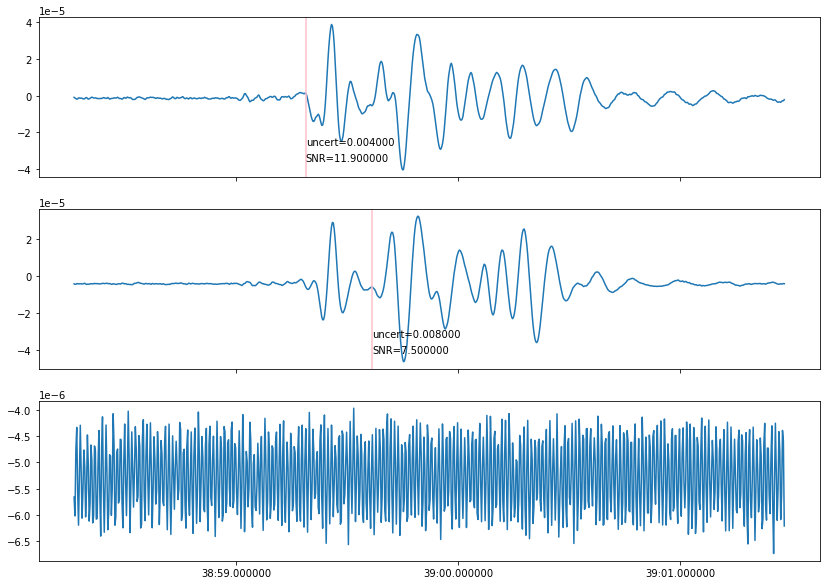

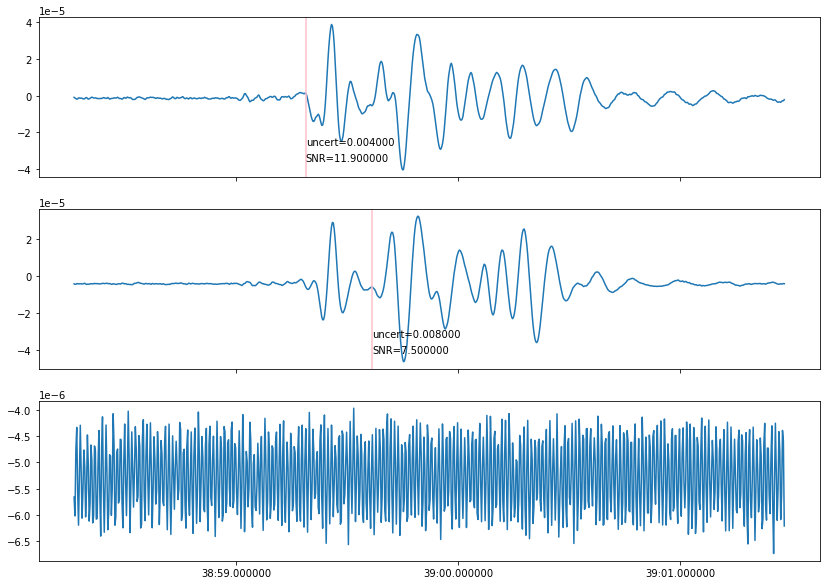

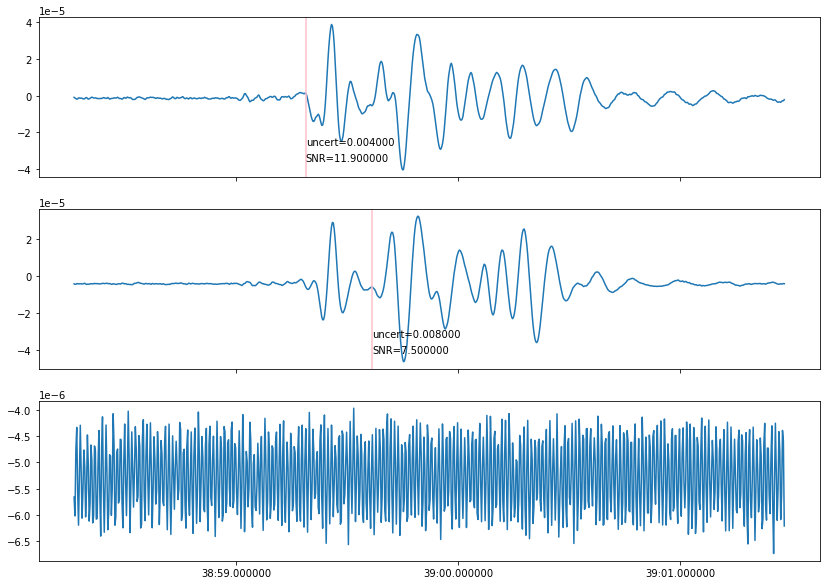

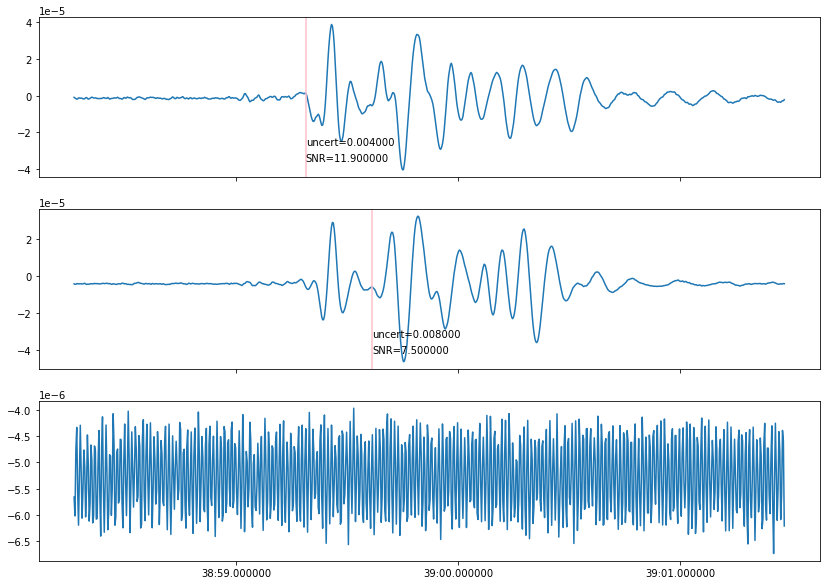

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


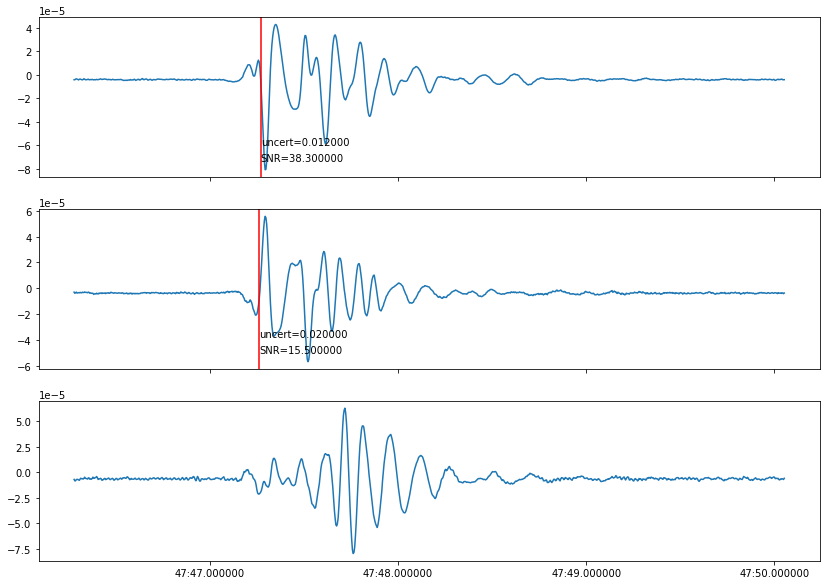

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


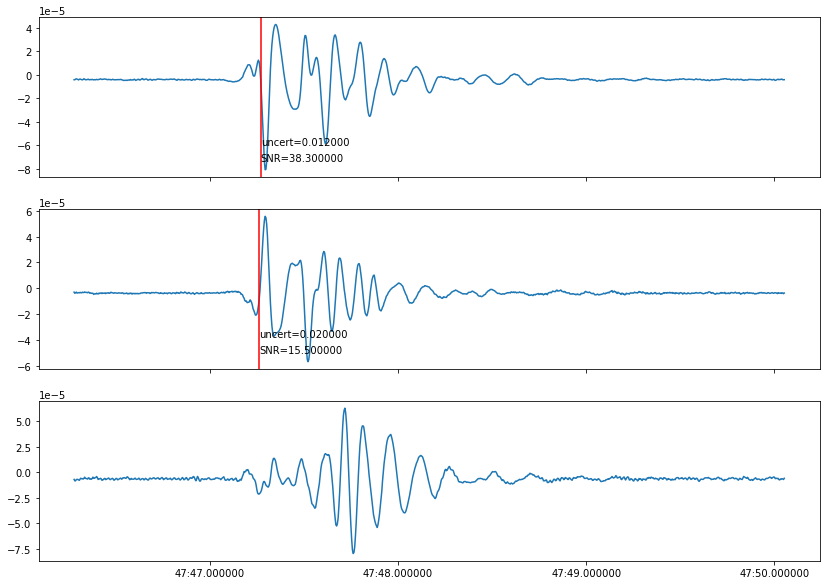

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


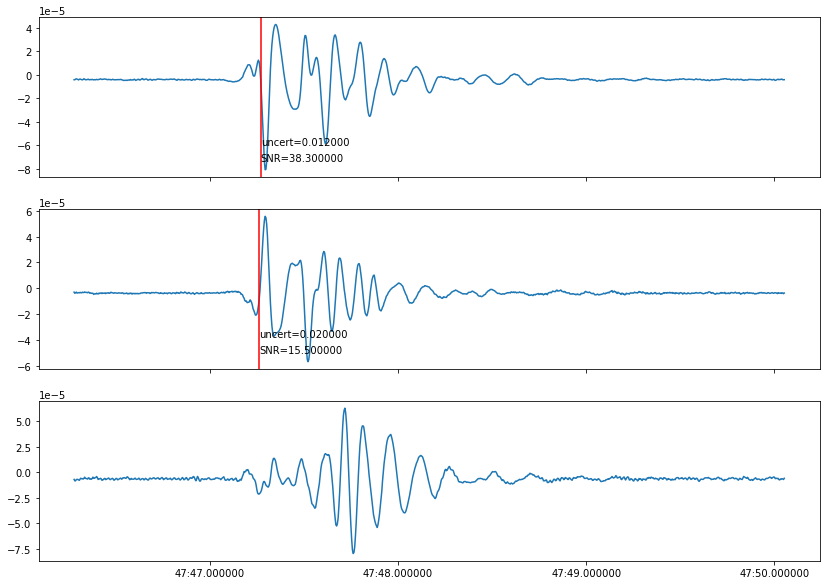

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


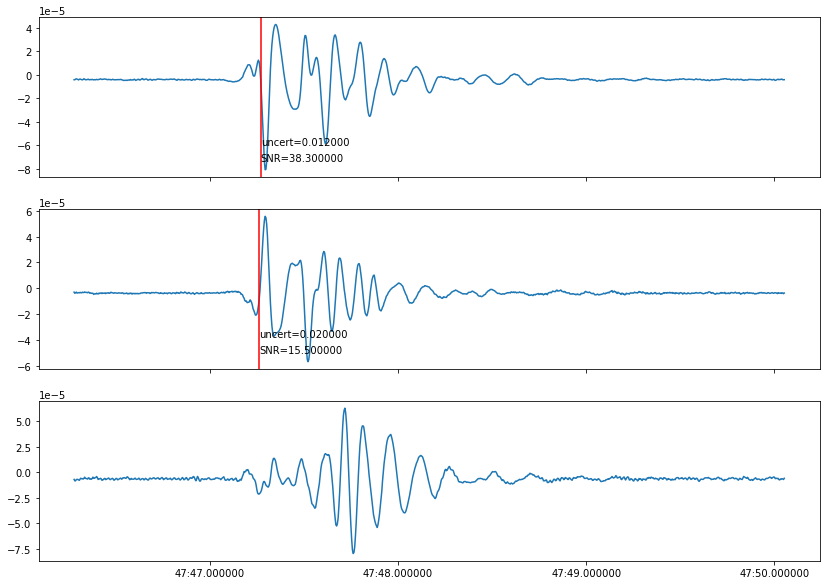

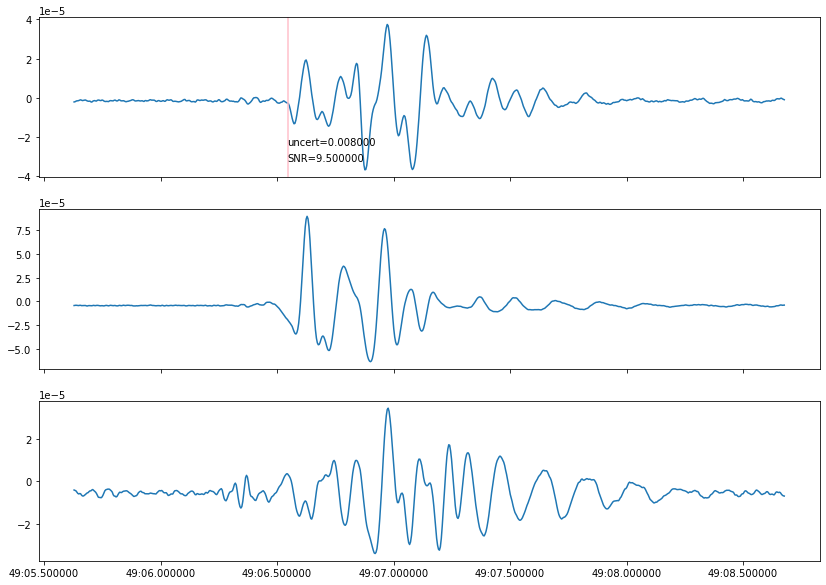

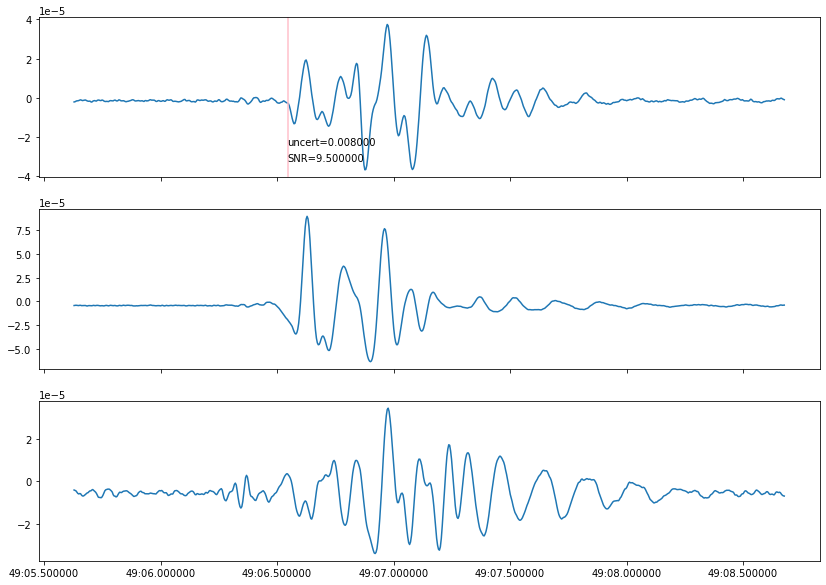

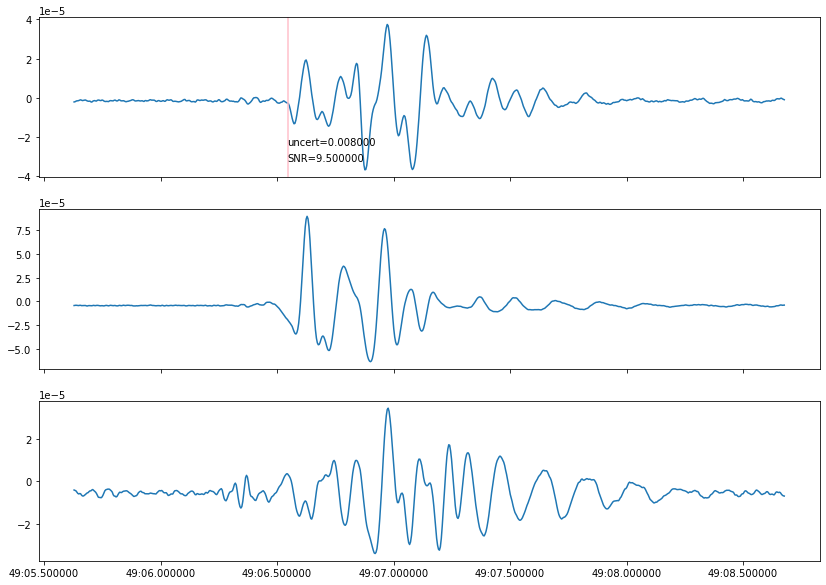

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


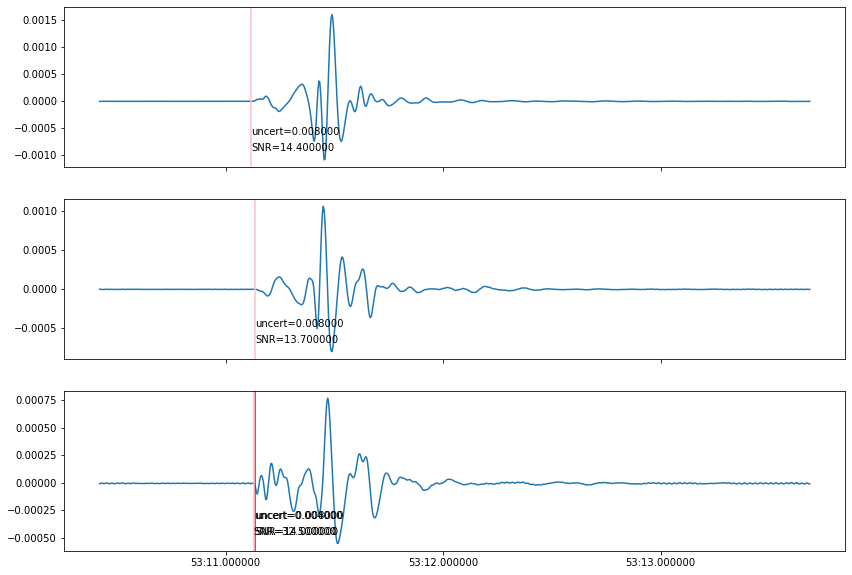

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


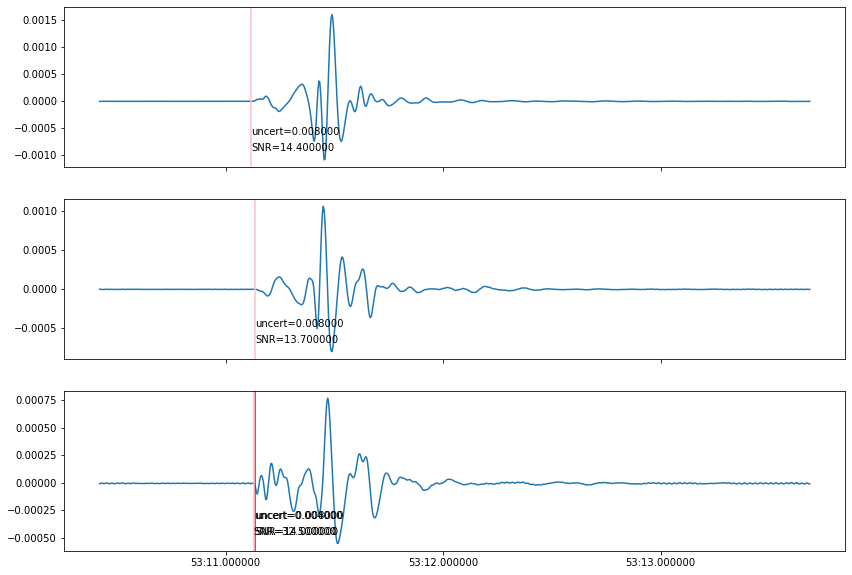

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


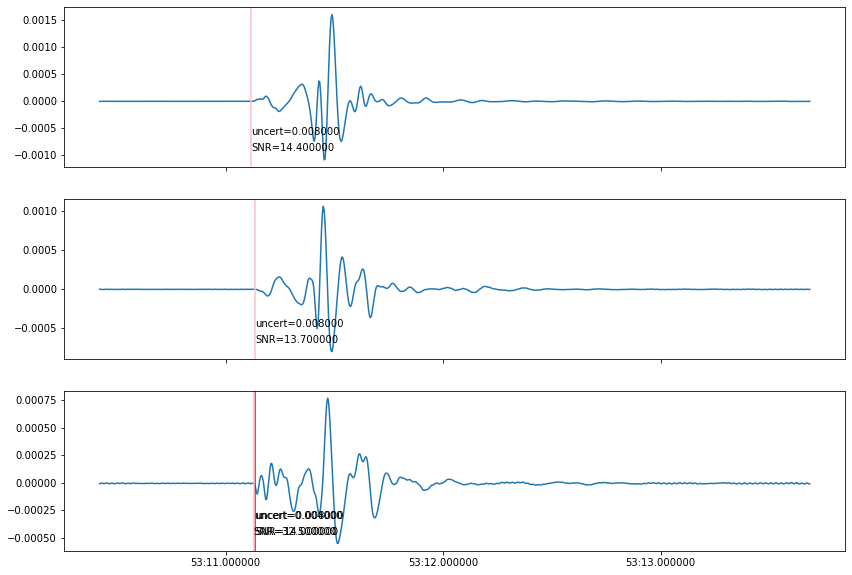

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


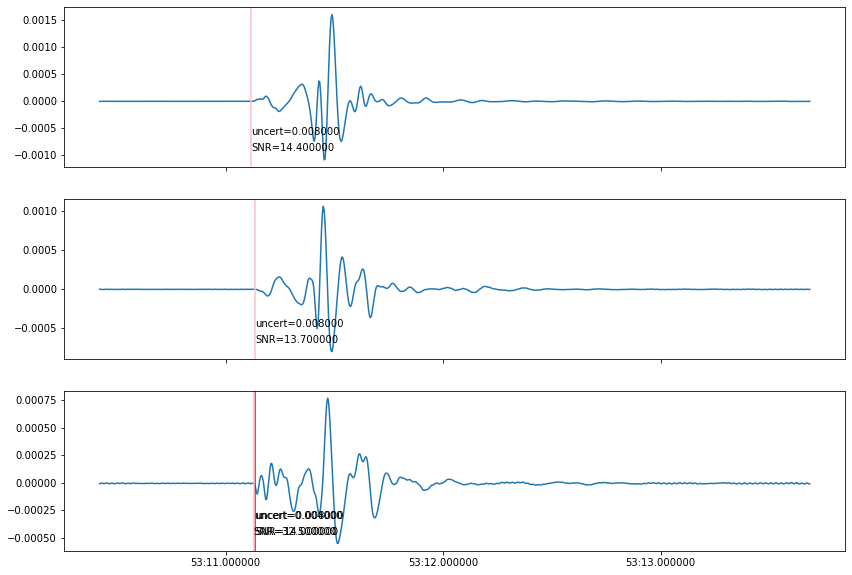

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


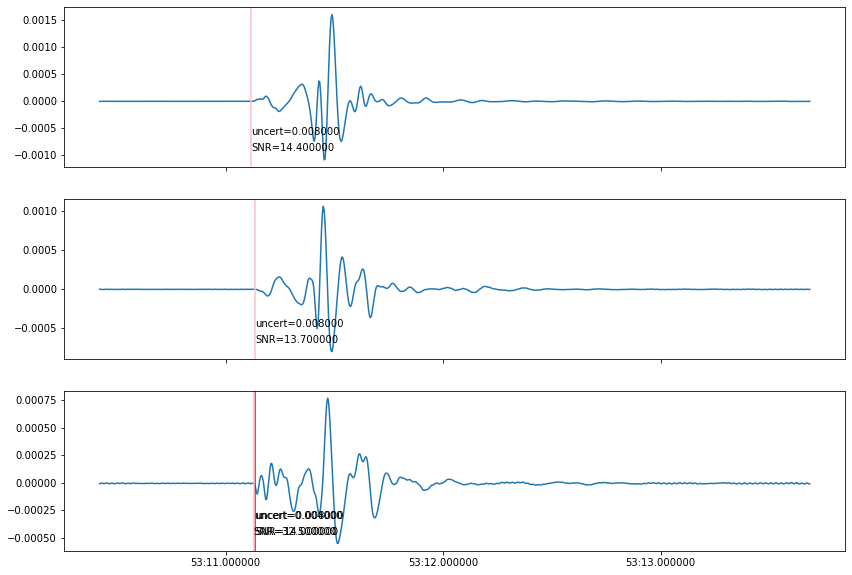

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


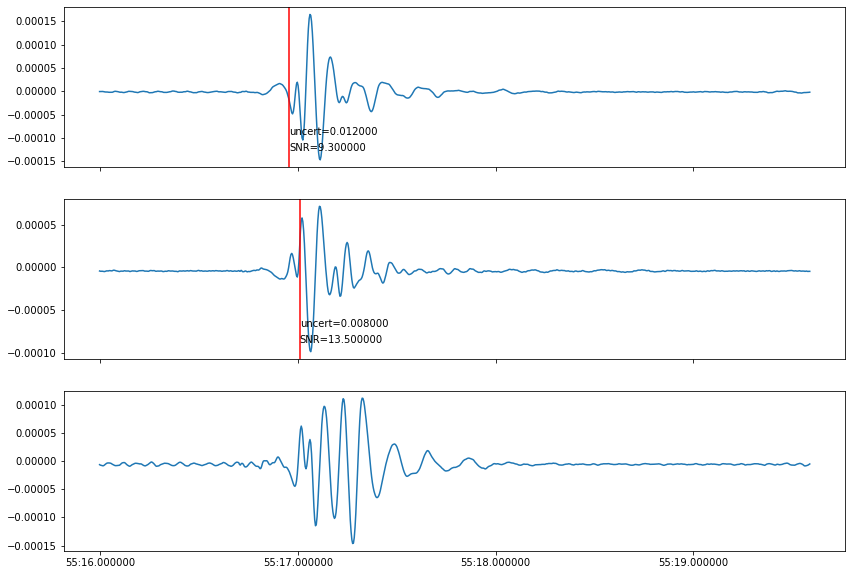

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


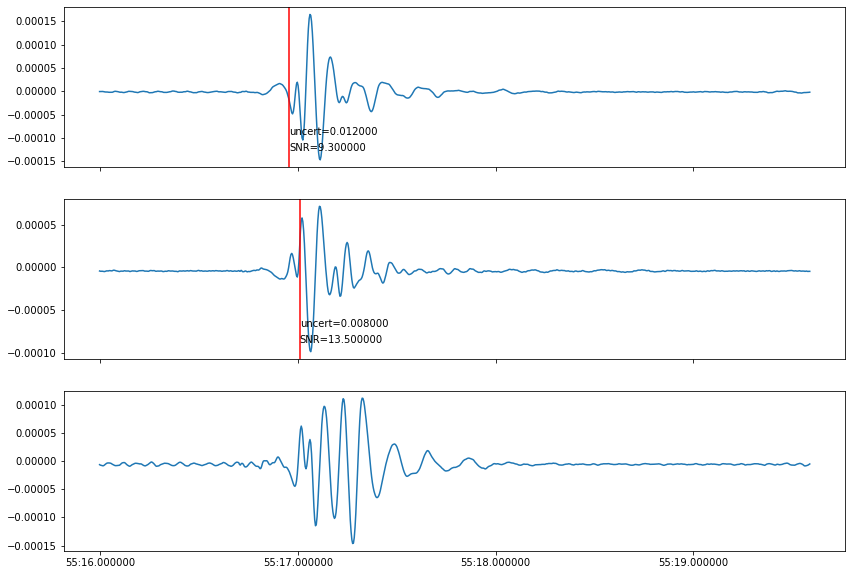

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


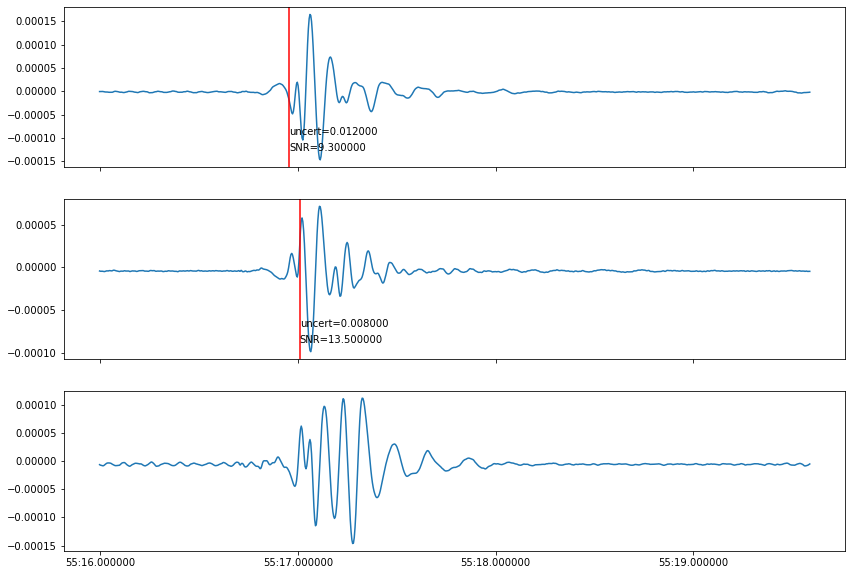

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


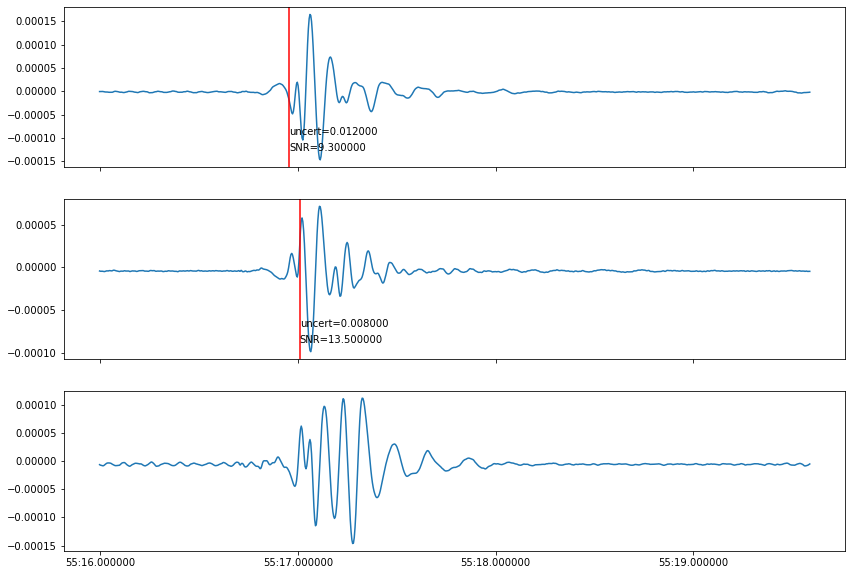

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


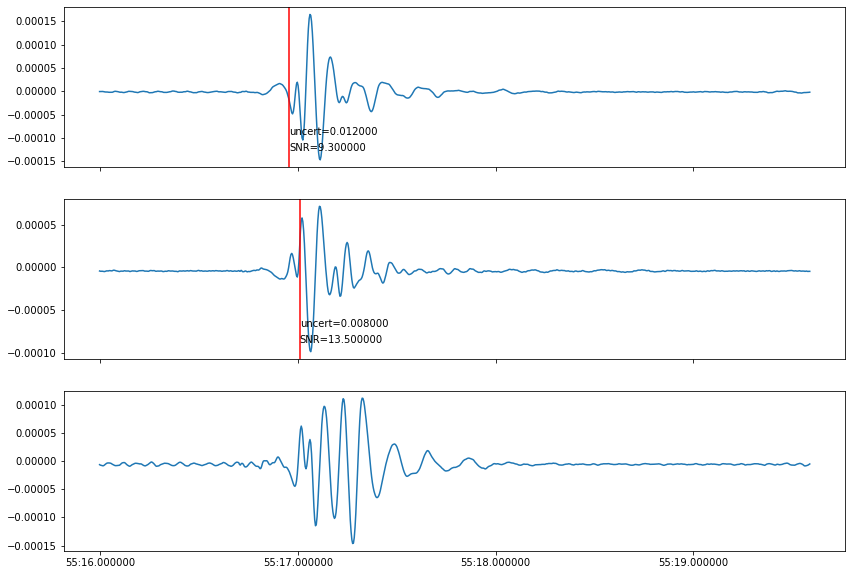

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


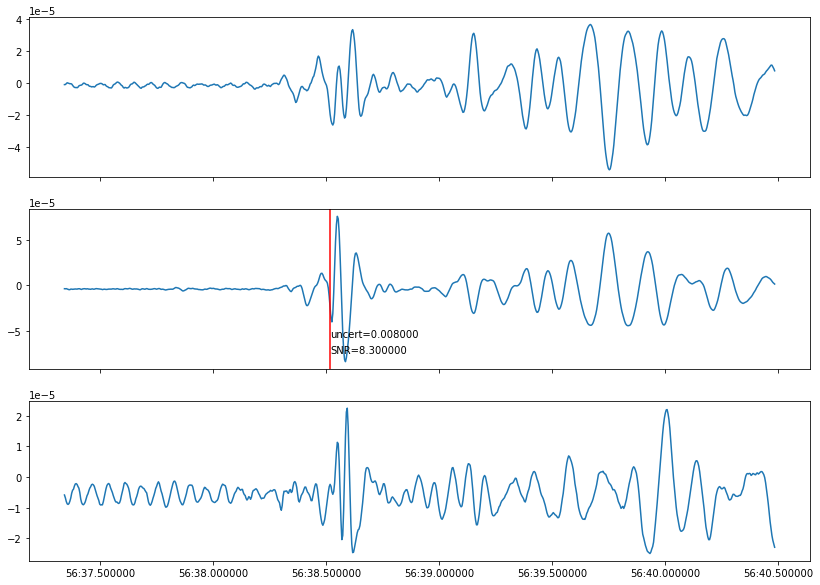

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


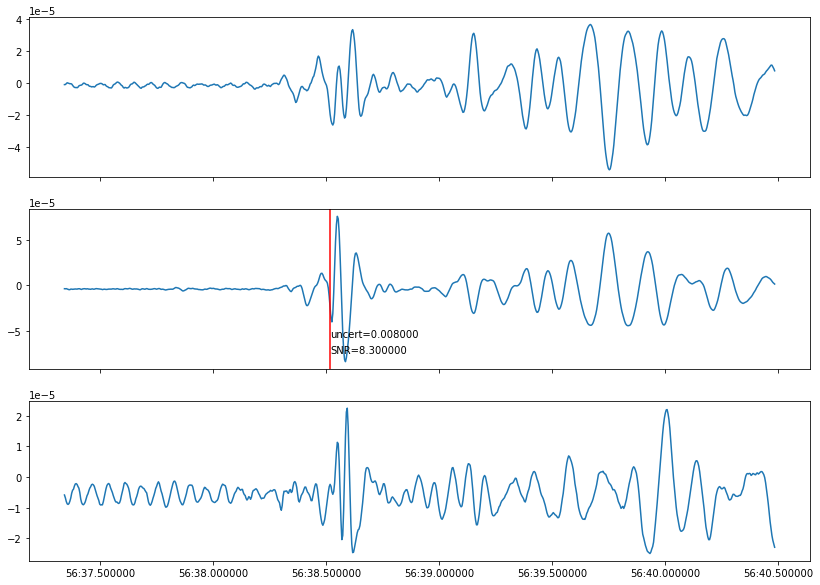

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


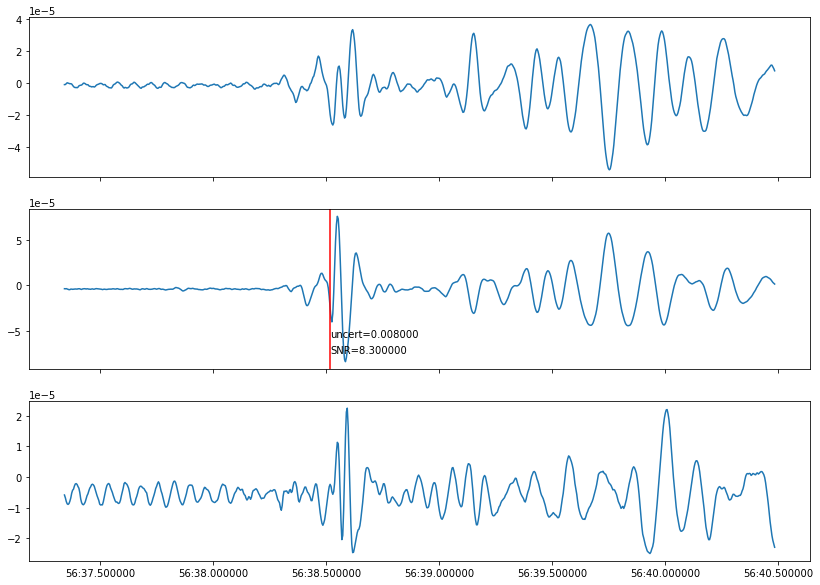

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


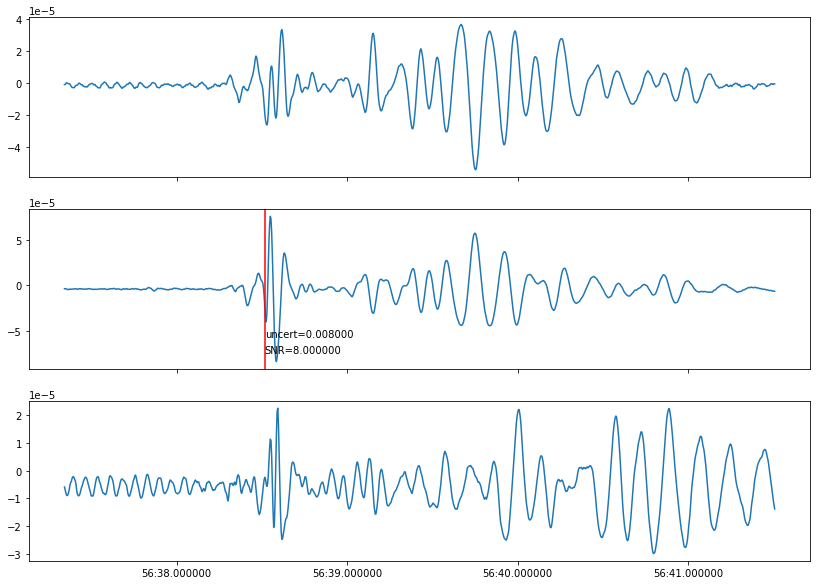

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


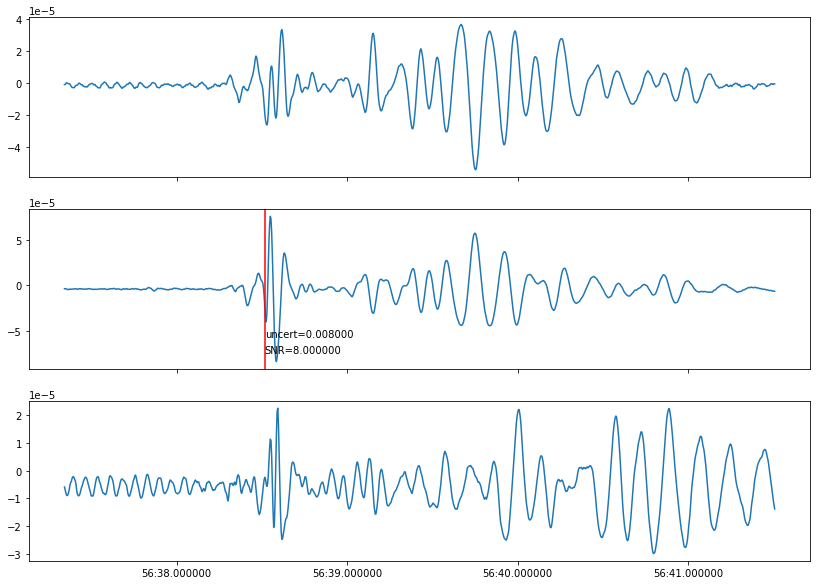

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


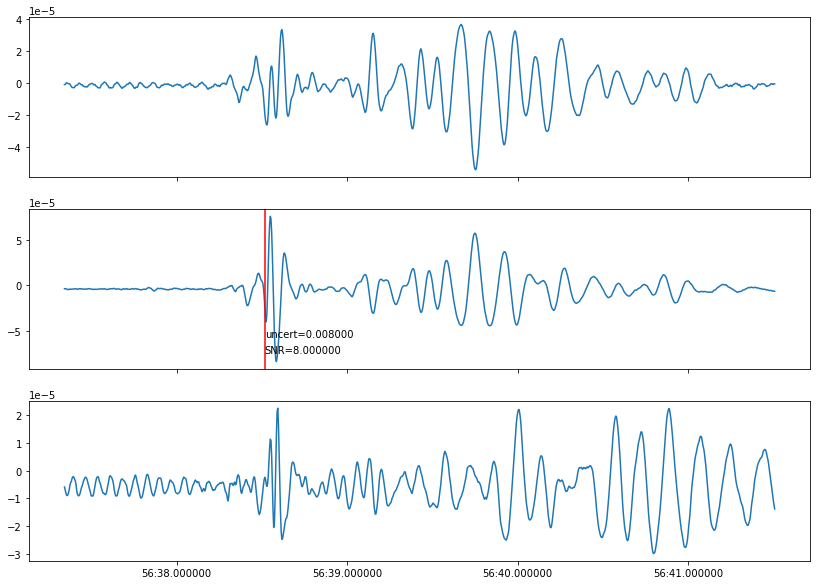

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


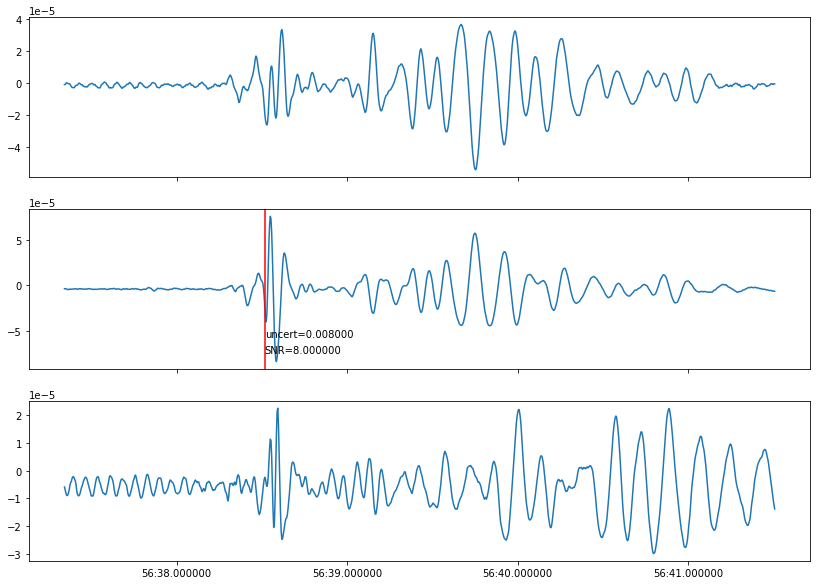

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


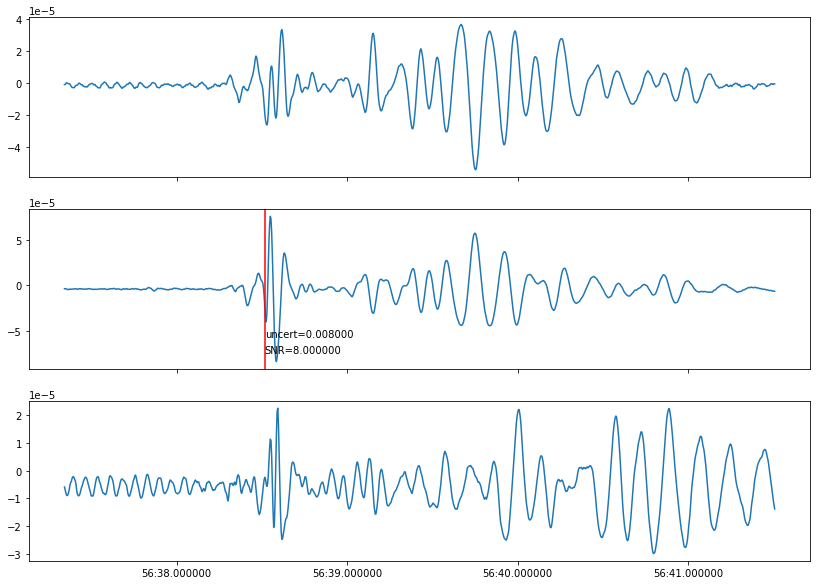

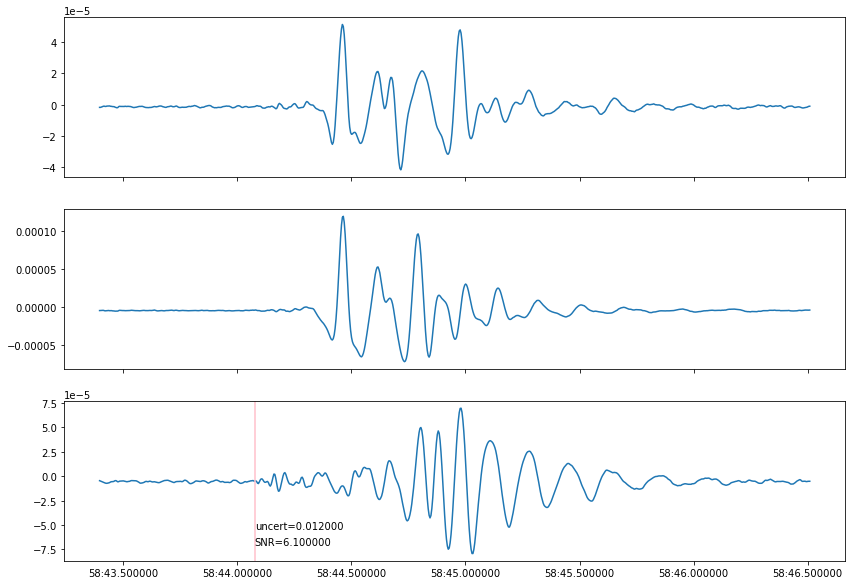

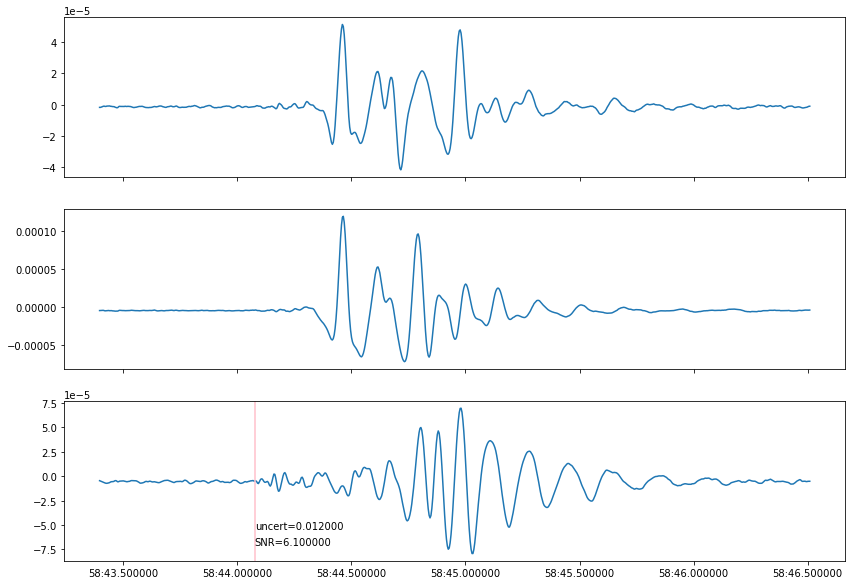

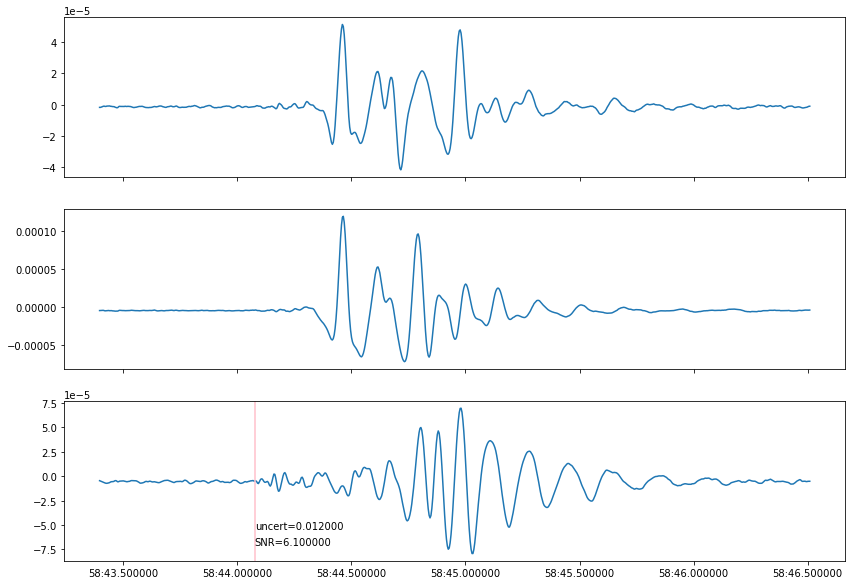

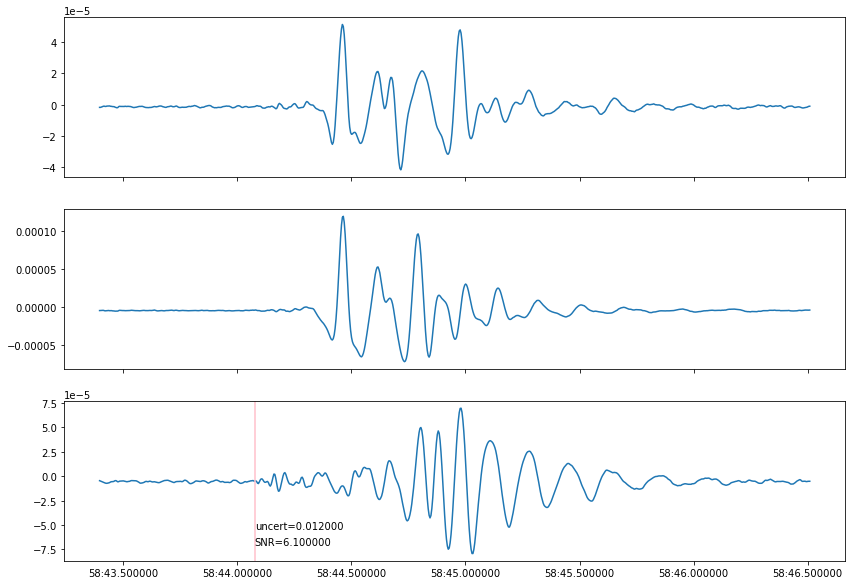

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


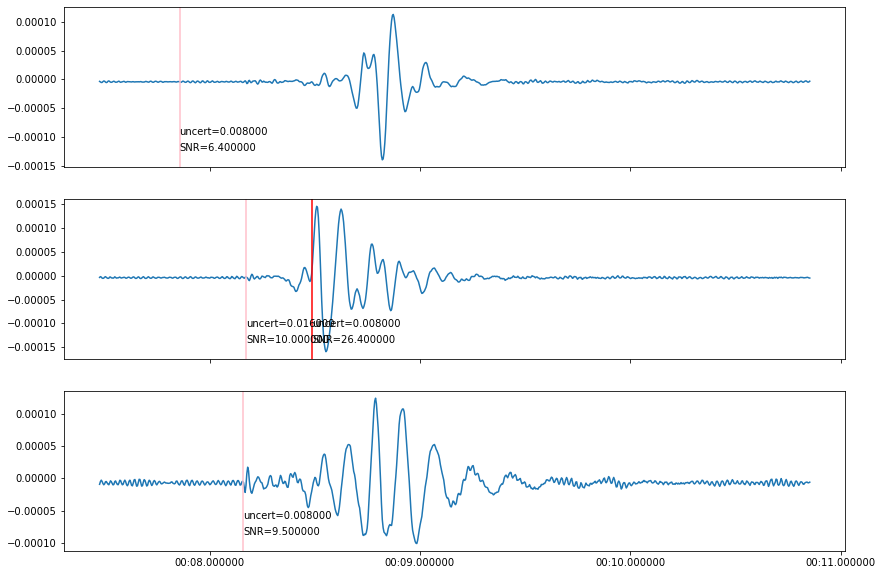

/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/genevieve/opt/anaconda3/envs/obspy1/lib/python3.7/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


KeyboardInterrupt: 

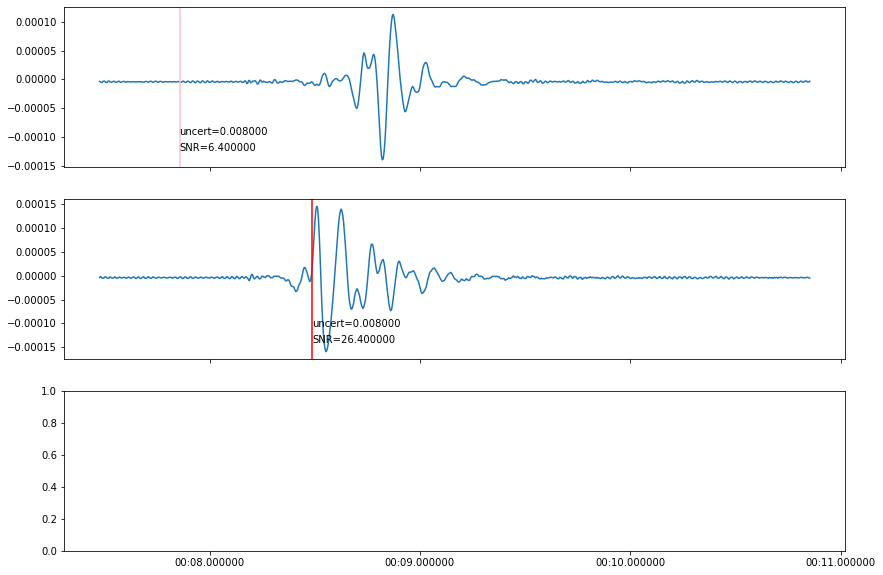

In [67]:
# from phasepapy.phasepicker import ktpicker, fbpicker, aicdpicker

# def plot_picks(ax, tr, method="aic", color="red"):
#     transform = ax.get_xaxis_transform()
#     scnl, picks, polarity, snr, uncert = get_picks(tr, picker=method, show_plot=False)
#     for ind, pick in enumerate(picks):
#         if snr[ind] > 0:
#             ax.axvline(mdates.date2num(pick._get_datetime()), color=color, linestyle="-")
#             plt.text(mdates.date2num(pick._get_datetime()), .1+ind*0.2, "SNR=%f" % snr[ind], transform=transform)
#             plt.text(mdates.date2num(pick._get_datetime()), .2+ind*0.2, "uncert=%f" % uncert[ind], transform=transform)

# def get_picks(tr, picker="aic", show_plot=False):
#     if picker == "kt":  # PhasePApy Kurtosis Picker

#         picker = ktpicker.KTPicker(t_win=0.04, t_ma=0.12, nsigma=6, t_up=0.02, nr_len=0.06,
#                                    nr_coeff=2, pol_len=10, pol_coeff=10, uncert_coeff=3)
#         scnl, picks, polarity, snr, uncert = picker.picks(tr)
#         if show_plot:
#             print('scnl:', scnl)
#             print('picks:', picks)
#             print('polarity:', polarity)
#             print('signal to noise ratio:', snr)
#             print('uncertainty:', uncert)
#             summary = ktpicker.KTSummary(picker, tr)
#             summary.plot_summary()
#             summary.plot_picks()

#     elif picker == "fb":  # PhasePApy FBPicker

#         picker = fbpicker.FBPicker(t_long=0.05, freqmin=10, mode='rms', t_ma=0.12, nsigma=6,
#                                    t_up=0.02, nr_len=2, nr_coeff=2, pol_len=10, pol_coeff=10, uncert_coeff=3)
#         scnl, picks, polarity, snr, uncert = picker.picks(tr)
#         if show_plot:
#             print('scnl:', scnl)
#             print('picks:', picks)
#             print('polarity:', polarity)
#             print('signal to noise ratio:', snr)
#             print('uncertainty:', uncert)
#             summary = fbpicker.FBSummary(picker, tr)
#             summary.plot_bandfilter()
#             summary.plot_statistics()
#             summary.plot_summary()

#     elif picker == "aic":  # PhasePApy AIC differentiation picker

#         picker = aicdpicker.AICDPicker(t_ma=0.12, nsigma=6, t_up=0.02, nr_len=0.06, nr_coeff=2, pol_len=10,
#                                        pol_coeff=10, uncert_coeff=3)
#         scnl, picks, polarity, snr, uncert = picker.picks(tr)
#         if show_plot:
#             print('scnl:', scnl)
#             print('picks:', picks)
#             print('polarity:', polarity)
#             print('signal to noise ratio:', snr)
#             print('uncertainty:', uncert)
#             summary = aicdpicker.AICDSummary(picker, tr)
#             summary.plot_summary()
#             summary.plot_picks()
#     else:
#         raise ValueError("Unrecognized picker option")

#     #print("Found %d picks." % len(picks))
#     return scnl, picks, polarity, snr, uncert

# wf_dir = "/Volumes/SanDisk_2TB/X7_Jan-Feb2020_sac_daily_250Hz/"
# for event in catalog.events:
#     tmin = min([p.time for p in event.picks])
#     tmax = max([p.time for p in event.picks])
#     stations = list(set([p.waveform_id.station_code for p in event.picks]))
#     st = Stream()
#     for sta in stations:
#         st += read(os.path.join(wf_dir,sta,"*%s*" % tmin.strftime("%Y%m%d")), 
#                   starttime = tmin - 1, endtime = tmax + 2)
#         # Plot with picks
#         fig, axs = plt.subplots(3, 1, sharex=True, figsize=(14,10))
#         axs[0].plot_date(st[0].times("matplotlib"), st[0].data, marker=None, linestyle="-")
#         plot_picks(axs[0], st[0], method="aic", color="red")
#         plot_picks(axs[0], st[0], method="kt", color="blue")
#         plot_picks(axs[0], st[0], method="fb", color="pink")

#         axs[1].plot_date(st[1].times("matplotlib"), st[1].data, marker=None, linestyle="-")
#         plot_picks(axs[1], st[1], method="aic", color="red")
#         plot_picks(axs[1], st[1], method="kt", color="blue")
#         plot_picks(axs[1], st[1], method="fb", color="pink")

#         axs[2].plot_date(st[2].times("matplotlib"), st[2].data, marker=None, linestyle="-")
#         plot_picks(axs[2], st[2], method="aic", color="red")
#         plot_picks(axs[2], st[2], method="kt", color="blue")
#         plot_picks(axs[2], st[2], method="fb", color="pink")
#         plt.show()

In [13]:
# sta_file = "station_locations_info/station_Nov-Dec2019_X6.xml"
# from obspy import read_inventory
# inv = read_inventory(sta_file)
# for sta in inv.networks[0].stations:
#     print("GTSRCE  %s  LATLON %f %f  0.0 %f" % (sta.code, sta.latitude, sta.longitude, 0))
#     #print("EQSTA %s  P      GAU  0.02    GAU  0.02" % sta.code)
#     #print("EQSTA %s  S      GAU  0.04    GAU  0.04" % sta.code)

In [60]:
UTCDateTime(2020,3,10,6,19,49) + 330

2020-03-10T06:25:19.000000Z